# Load packages

In [1]:
# Loading the required packages to run this notebook
from src.visualisation.SummaryModels import SummaryModels
import src.utils.utils as utils
from src.visualisation.VisualiseTrajectories import VisualiseTrajectories
from src.data.Datasets import AISDataset
from pathlib import Path
import pandas as pd

# Define the region to look into
region = "Bornholm"
zoom = 8
n = 10

In [2]:
# Use the SummaryModels class for everything related to the reconstructions
file_name = "RegionBornholm_01062019_30092019_Fish_14400_86400_600"
generative_dist = "Diagonal"
learning_rate = 0.005
use_generative_bias = True

# Use the SummaryModels class
summary_models = SummaryModels(file_name, generative_dist=generative_dist, learning_rate=learning_rate,
                               use_generative_bias=use_generative_bias)

In [3]:
# Use the VisualiseTrajectories class for geographically visualising trajectories 
fig_size = (10, 10)
visualise_trajectories = VisualiseTrajectories(region, save_figures=False, plot_figures=True, fig_size=fig_size, zoom=zoom)
processed_data_dir =  visualise_trajectories.processed_data_dir

# Read the info file to know how to read the data file
data_file = processed_data_dir / ("data_" + file_name + ".pkl")
data_info_file = processed_data_dir / ("datasetInfo_" + file_name + ".pkl")
data_info = utils.read_data_info_file(data_info_file)

# Load the static Google Map image for the RIO
img = visualise_trajectories.read_static_map()

In [4]:
# Function that plots the actual and reconstructed side by side
def plot_actual_reconstructed(idx):
    # Setup for the plotting
    fig_size_tmp = visualise_trajectories.fig_size
    visualise_trajectories.fig_size = (20,10)
    fig, ax = visualise_trajectories.visualise_static_map(img, subplots=[1, 2])
    plot_figures_tmp = visualise_trajectories.plot_figures
    visualise_trajectories.plot_figures = False
        
    # For plotting a single complete vessel trajectory on the static map
    index = df_n.iloc[idx]["Index"]
    data_set = AISDataset(file_name, data_info=data_info, indicies=[index], discrete=False)
    df_actual = utils.get_tracks_from_dataset(data_set, continuous_representation=True)
    
    # For plotting the corresponding model reconstruction
    index = df_n.iloc[idx]["Data set Index"]
    data_set = train_evaluate.validation_dataloader.dataset
    reconstruction = train_evaluate.track_reconstructions(data_set, index)
    
    df_recon = reconstruction["Reconstruction"][2:]
    
    # Setup actual and reconstruction data frames
    df_speed = utils.concat_actual_recon(df_actual, df_recon, "Speed")
    df_course = utils.concat_actual_recon(df_actual, df_recon, "Course")
    df_speed["Type"] = df_speed["Type"].str.replace("Actual", "Actual speed")
    df_course["Type"] = df_course["Type"].str.replace("Actual", "Actual course")
    
    # Do the actual plotting
    visualise_trajectories.plot_single_track(df_actual, ax[0], use_cmap=True, df_speed=df_speed,
                                                      df_course=df_course, fig=fig, rect=[0.15, 0.72, 0.12, 0.12], 
                                                      rect2=[0.575, 0.72, 0.12, 0.12])
    visualise_trajectories.plot_figures = plot_figures_tmp
    visualise_trajectories.plot_single_track(df_recon, ax[1], use_cmap=True)
    visualise_trajectories.fig_size = fig_size_tmp
    return {"Actual trajectory": df_actual, "Reconstructed trajectory": df_recon,
            "Speed data frame": df_speed, "Course data frame": df_course}

# Fishing Reconstruction Example

In [5]:
# Get some trajectories to show an example from 
data = summary_models.run_evaluation_get_n(n=100, worst=False)
df_n = data["TrajectoryLevelData"]
train_evaluate = data["TrainEvaluateObject"]

tensor([ 55.1874,  14.7416,   2.0111, 188.3894])
tensor([ 0.3833,  0.5341,  2.8683, 99.4569])
tensor([ 55.1874,  14.7416,   2.0111, 188.3894])
tensor([ 0.3833,  0.5341,  2.8683, 99.4569])
tensor([ 55.1874,  14.7416,   2.0111, 188.3894])
tensor([ 0.3833,  0.5341,  2.8683, 99.4569])
C:\Github\vessel-trajectory-anomaly-detection\models\saved-models\VRNN_RegionBornholm_01062019_30092019_Fish_14400_86400_600_latent100_recurrent100_batchNormFalse_Diagonal_GBT_lr0005.pth


tensor([5.5556e+01, 1.4359e+01, 1.8189e-03, 2.0487e+02])
tensor([2.1247e-05, 2.1394e-05, 3.6266e-03, 3.4320e+01])


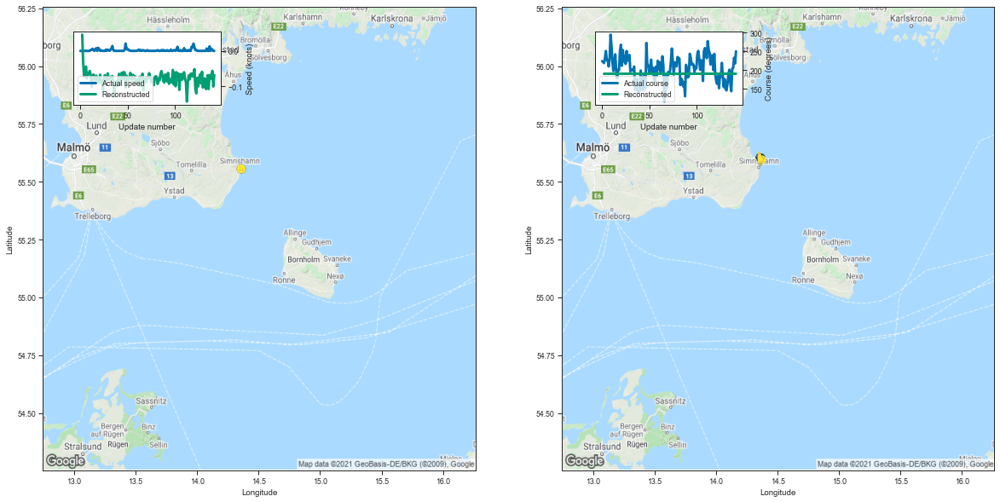

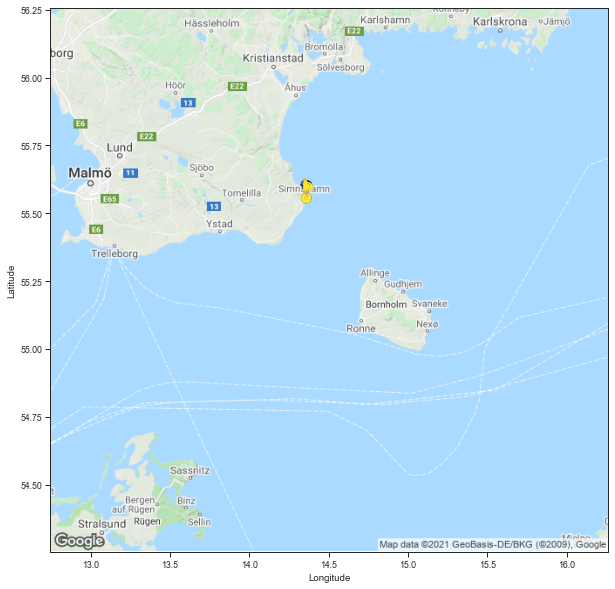

     Data set Index    Index       MMSI  Longitude   Latitude     Speed  \
0                 0  6787151  265759000  14.359296  55.555855  0.000000   
1                 0  6787151  265759000  14.359334  55.555882  0.000000   
2                 0  6787151  265759000  14.359324  55.555862  0.000000   
3                 0  6787151  265759000  14.359309  55.555847  0.000000   
4                 0  6787151  265759000  14.359283  55.555836  0.000000   
..              ...      ...        ...        ...        ...       ...   
138               0  6787151  265759000  14.359309  55.555870  0.000000   
139               0  6787151  265759000  14.359324  55.555878  0.006122   
140               0  6787151  265759000  14.359336  55.555862  0.002778   
141               0  6787151  265759000  14.359320  55.555882  0.000000   
142               0  6787151  265759000  14.359341  55.555874  0.000000   

         Course Ship type  Track length          Time stamp  
0    223.853485   Fishing           1

,Longitude,Latitude,Speed,Course,Longitude sigma,Latitude sigma,Speed sigma,Course sigma
2,14.364118,55.602070,0.045917,189.919037,0.065576,0.072411,0.203255,69.624046
3,14.343359,55.614628,-0.032743,189.931564,0.053861,0.057411,0.196779,74.830009
4,14.366926,55.595325,-0.073178,189.984253,0.052800,0.059370,0.190572,74.922675
5,14.365040,55.594662,-0.061423,190.011169,0.051215,0.058033,0.177000,74.910813
6,14.363602,55.589600,-0.044433,190.003235,0.051423,0.058315,0.184905,75.413382
...,...,...,...,...,...,...,...,...
138,14.356205,55.614090,-0.068693,189.993835,0.050514,0.055809,0.188352,75.707300
139,14.350160,55.591728,-0.078970,189.952194,0.051361,0.059997,0.187009,76.284028
140,14.370239,55.600258,-0.056567,190.006683,0.052068,0.058583,0.186033,74.825882
141,14.352829,55.602203,-0.100749,189.894455,0.050093,0.057894,0.198387,77.818916


In [6]:
# Plot the actual and reconstructed trajectories side by side
tracks = plot_actual_reconstructed(3)

# Plot them on the same figure
visualise_trajectories.fig_size = fig_size
plot_figures_tmp = visualise_trajectories.plot_figures
fig, ax = visualise_trajectories.visualise_static_map(img)
visualise_trajectories.plot_figures = False
visualise_trajectories.plot_single_track(tracks["Actual trajectory"], ax, use_cmap=True)
visualise_trajectories.plot_figures = plot_figures_tmp
visualise_trajectories.plot_single_track(tracks["Reconstructed trajectory"], ax, use_cmap=True)

print(tracks['Actual trajectory'])
tracks['Reconstructed trajectory']

# Best Fishing Reconstructions

tensor([ 55.1874,  14.7416,   2.0111, 188.3894])
tensor([ 0.3833,  0.5341,  2.8683, 99.4569])
tensor([ 55.1874,  14.7416,   2.0111, 188.3894])
tensor([ 0.3833,  0.5341,  2.8683, 99.4569])
tensor([ 55.1874,  14.7416,   2.0111, 188.3894])
tensor([ 0.3833,  0.5341,  2.8683, 99.4569])
C:\Github\vessel-trajectory-anomaly-detection\models\saved-models\VRNN_RegionBornholm_01062019_30092019_Fish_14400_86400_600_latent100_recurrent100_batchNormFalse_Diagonal_GBT_lr0005.pth
tensor([5.5556e+01, 1.4359e+01, 1.7899e-03, 2.0624e+02])
tensor([1.9884e-05, 1.9990e-05, 4.4066e-03, 3.0646e+01])


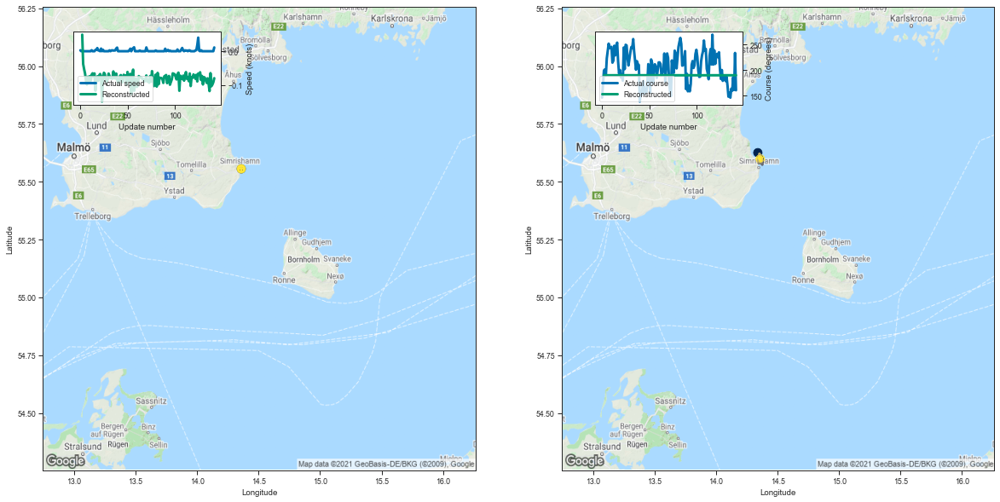

tensor([5.5557e+01, 1.4359e+01, 1.5834e-03, 2.0796e+02])
tensor([1.5939e-05, 1.5923e-05, 3.4240e-03, 3.3565e+01])


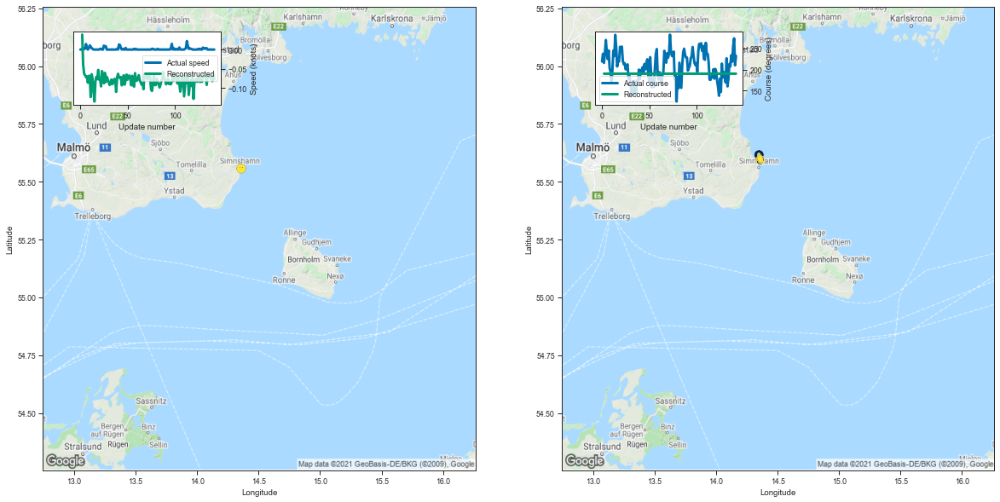

tensor([5.5556e+01, 1.4359e+01, 1.9854e-03, 2.0578e+02])
tensor([1.6826e-05, 1.9222e-05, 5.2639e-03, 3.3364e+01])


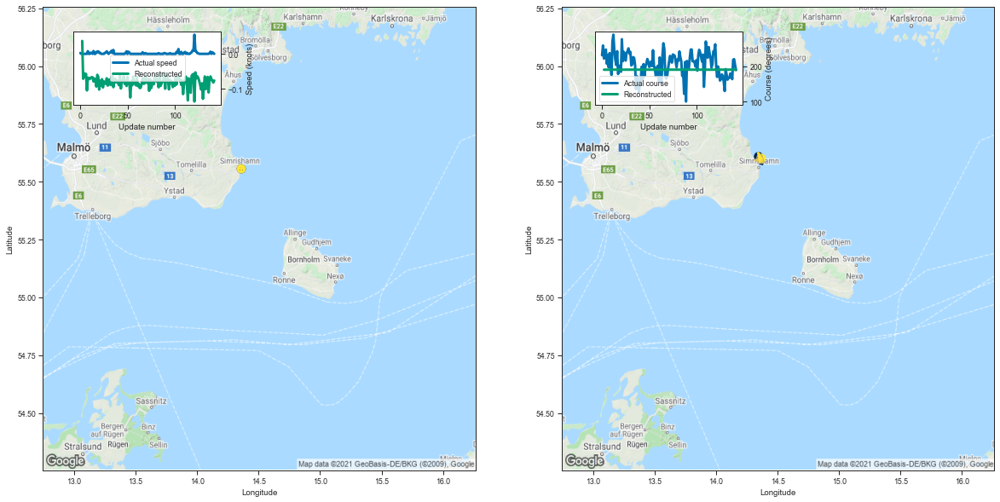

tensor([5.5556e+01, 1.4359e+01, 1.8189e-03, 2.0487e+02])
tensor([2.1247e-05, 2.1394e-05, 3.6266e-03, 3.4320e+01])


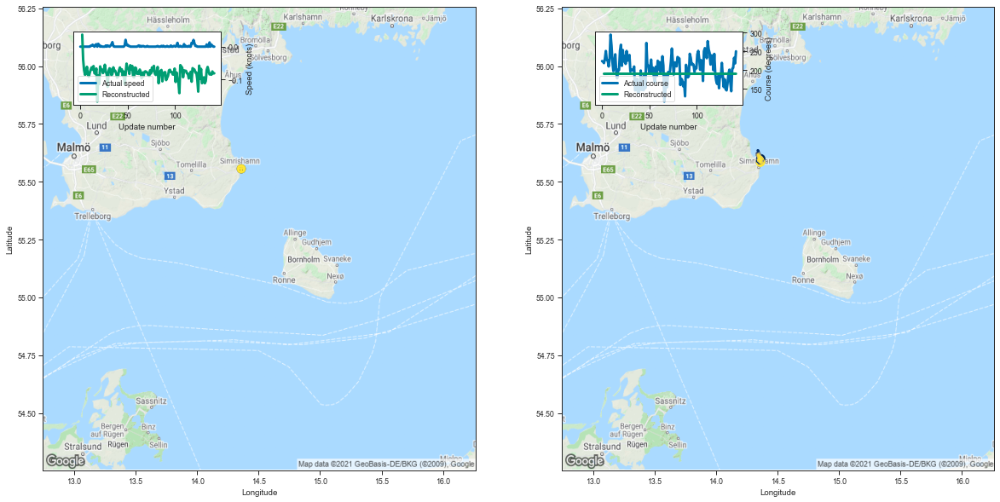

tensor([5.5555e+01, 1.4360e+01, 1.4317e-03, 2.0381e+02])
tensor([1.4610e-05, 1.8222e-05, 3.0216e-03, 3.5571e+01])


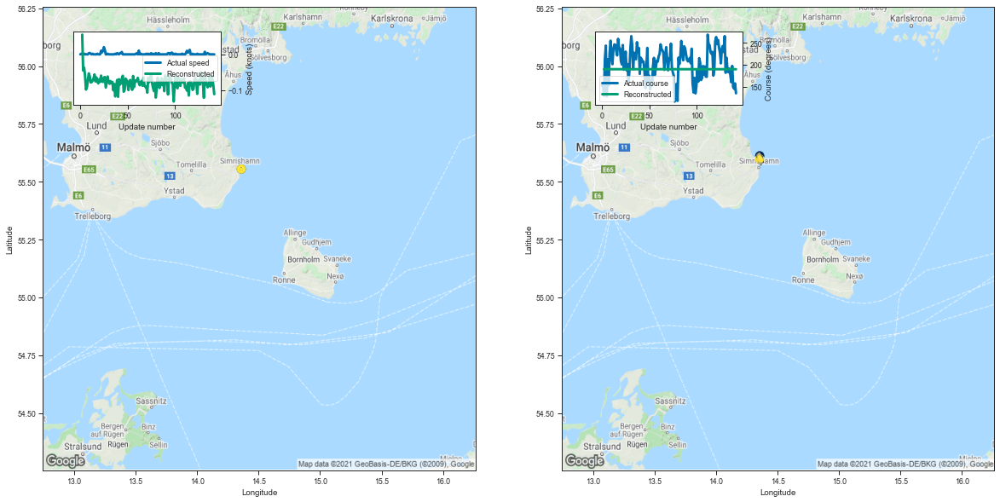

tensor([5.5556e+01, 1.4358e+01, 1.4468e-05, 1.9023e+02])
tensor([1.1947e-05, 1.4593e-05, 1.7361e-04, 5.0448e+01])


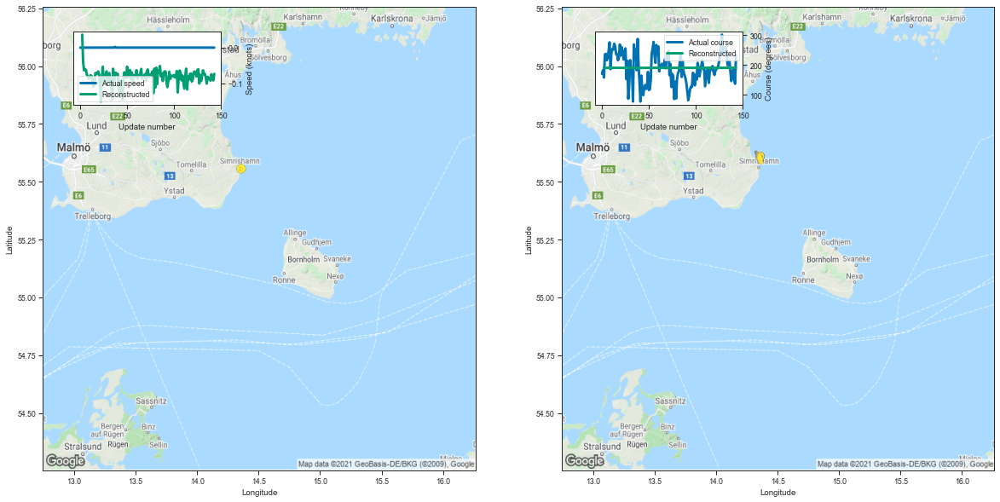

tensor([ 55.5562,  14.3581,   0.0000, 178.0486])
tensor([1.0046e-05, 1.3288e-05, 0.0000e+00, 4.7751e+01])


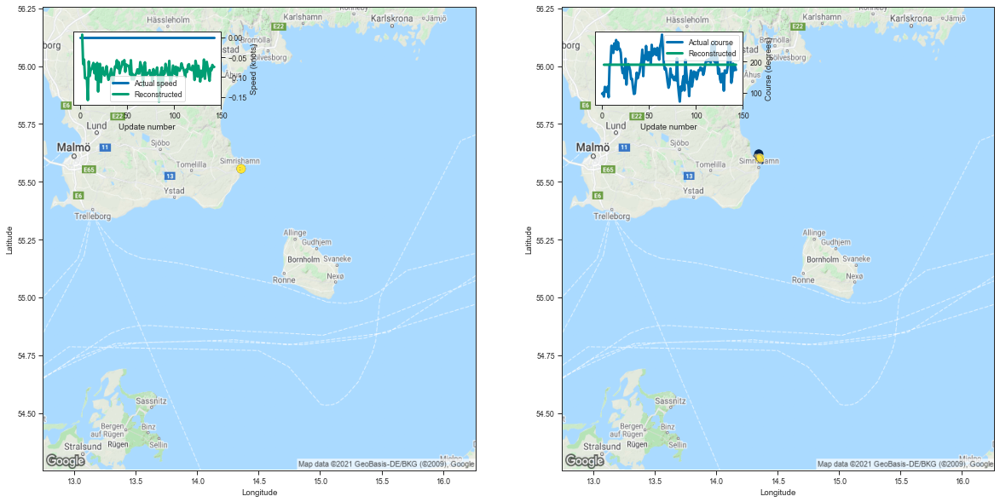

tensor([5.5556e+01, 1.4358e+01, 5.1076e-05, 1.7585e+02])
tensor([1.1804e-05, 1.2762e-05, 4.3234e-04, 5.6761e+01])


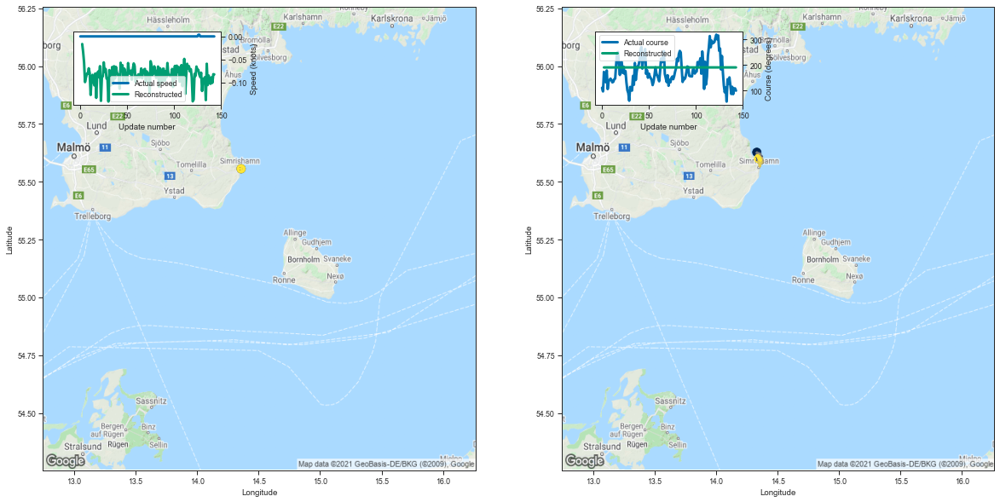

tensor([5.5556e+01, 1.4359e+01, 1.2746e-04, 2.6330e+02])
tensor([5.3357e-06, 6.0492e-06, 5.4085e-04, 1.2251e-05])


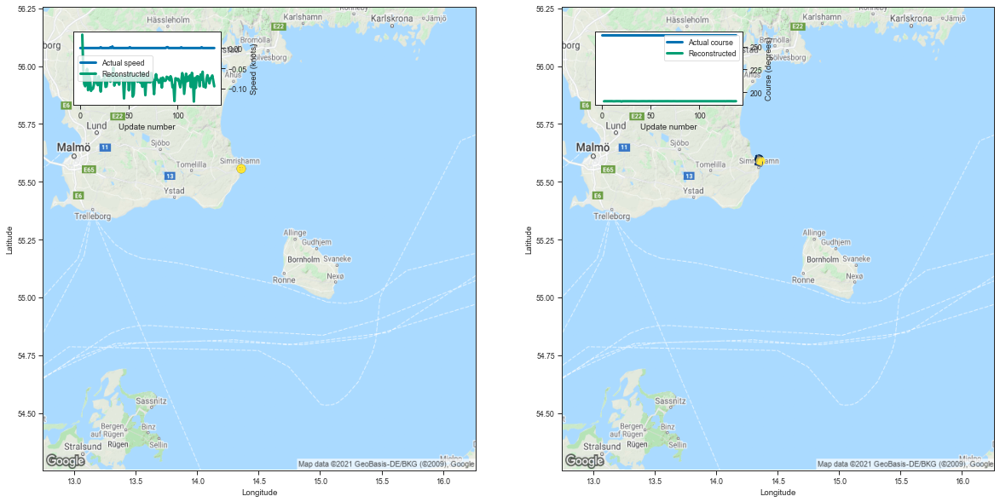

tensor([5.5556e+01, 1.4359e+01, 5.8275e-05, 2.6156e+02])
tensor([1.3188e-05, 2.0780e-05, 6.9687e-04, 3.2196e+01])


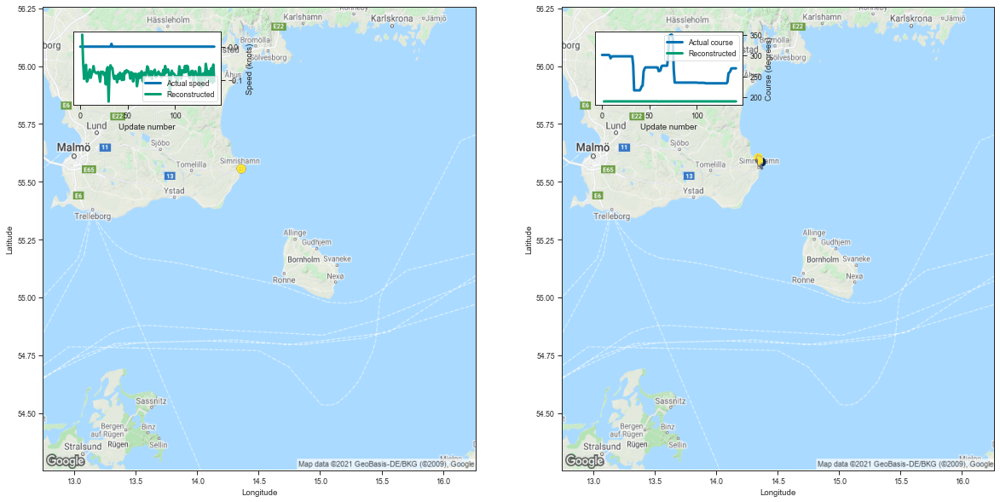

,Data set Index,Index,MMSI,Ship type,Length,Reconstruction log probability,Equally weighted reconstruction log probability
60,60,6869996,265759000,Fishing,143,-151.573486,-1.059954
17,17,6685896,265759000,Fishing,143,-155.836609,-1.089766
95,95,6805561,265759000,Fishing,143,-156.859711,-1.096921
29,29,6787151,265759000,Fishing,143,-157.565918,-1.101860
74,74,6962046,265759000,Fishing,143,-159.015427,-1.111996
44,44,7135380,266054000,Fishing,144,-173.143433,-1.202385
25,25,7292936,266054000,Fishing,144,-174.214172,-1.209821
34,34,7237328,266054000,Fishing,144,-185.368790,-1.287283
43,43,5760657,265750000,Fishing,139,-184.497955,-1.327323
103,103,6064863,265754000,Fishing,143,-200.428452,-1.401598


In [7]:
# Focus on the n best cargo reconstructions
data = summary_models.run_evaluation_get_n(n=n, worst=False)
df_n = data["TrajectoryLevelData"]
train_evaluate = data["TrainEvaluateObject"]

# Plot the actual and reconstructed trajectories side by side
for idx in range(n): 
    tracks = plot_actual_reconstructed(idx)
df_n

# Worst Fishing Reconstructions

tensor([ 55.1874,  14.7416,   2.0111, 188.3894])
tensor([ 0.3833,  0.5341,  2.8683, 99.4569])
tensor([ 55.1874,  14.7416,   2.0111, 188.3894])
tensor([ 0.3833,  0.5341,  2.8683, 99.4569])
tensor([ 55.1874,  14.7416,   2.0111, 188.3894])
tensor([ 0.3833,  0.5341,  2.8683, 99.4569])
C:\Github\vessel-trajectory-anomaly-detection\models\saved-models\VRNN_RegionBornholm_01062019_30092019_Fish_14400_86400_600_latent100_recurrent100_batchNormFalse_Diagonal_GBT_lr0005.pth
tensor([ 55.1127,  14.1607,   7.6406, 273.0865])
tensor([ 0.0905,  0.6797,  1.4292, 32.1637])


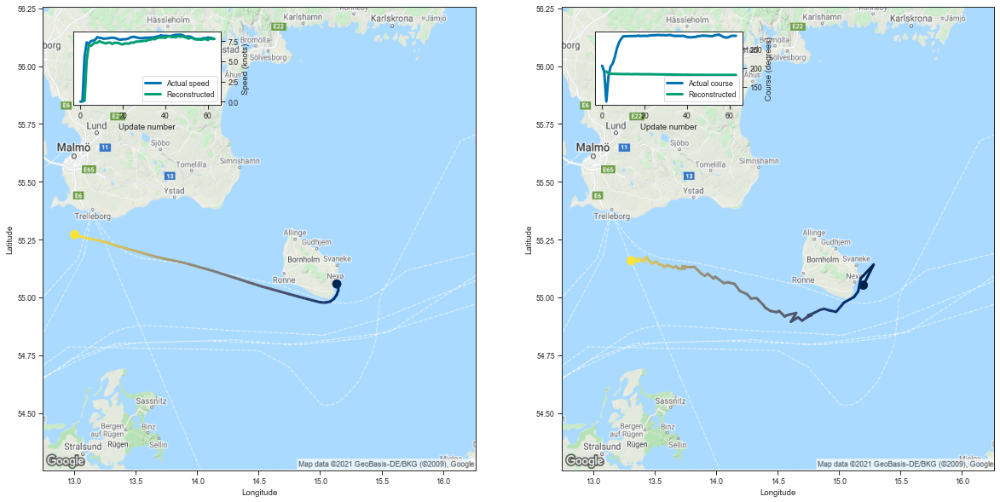

[0.08304083347320557, 5.153170585632324, 7.00261926651001, 6.9178547859191895]
tensor([ 54.8849,  13.3777,  10.0218, 319.7269])
tensor([ 0.2073,  0.2154,  0.4196, 47.0041])


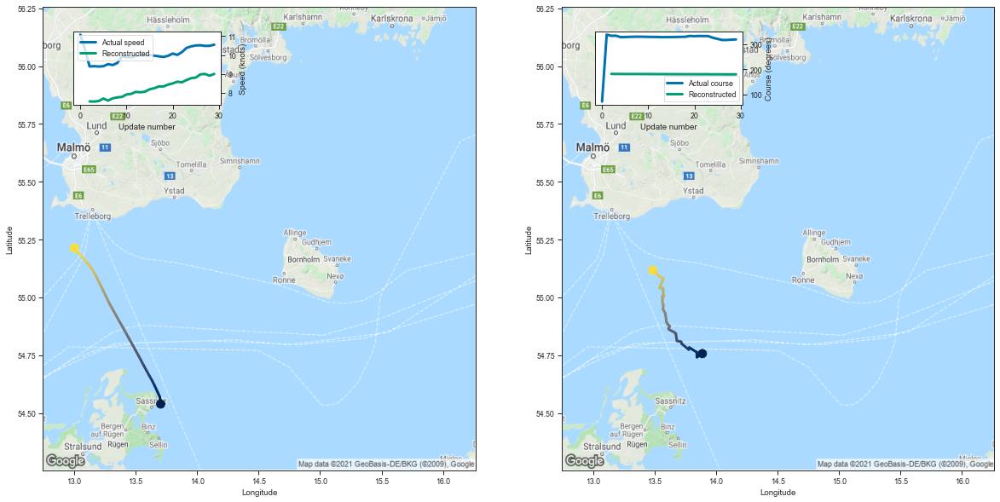

[7.548746585845947, 7.5399250984191895, 7.569203853607178, 7.701237678527832]
tensor([ 54.9165,  14.8774,   5.0551, 104.9459])
tensor([  0.1387,   0.3202,   3.7589, 101.8317])


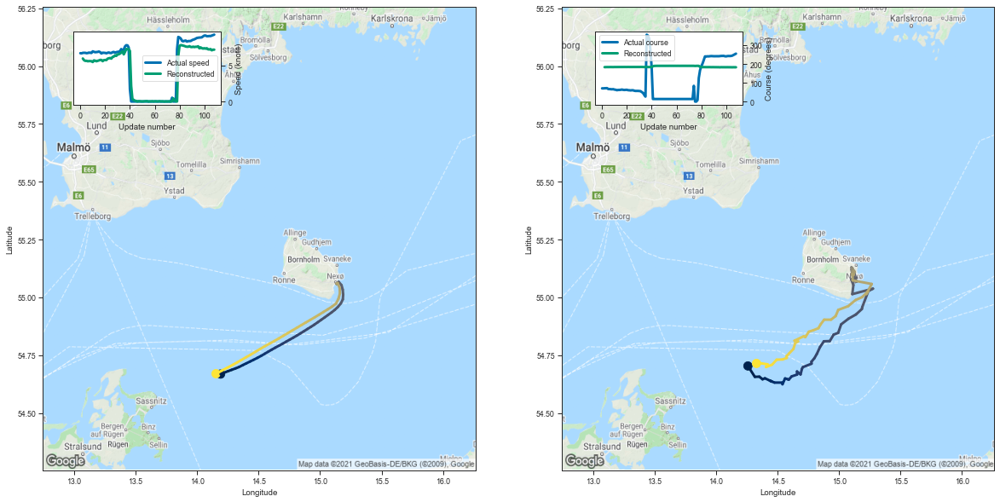

[5.98067569732666, 5.743503570556641, 5.648946762084961, 5.6639275550842285]
tensor([55.4448, 14.3114,  0.9838, 90.1561])
tensor([4.4982e-02, 3.7253e-02, 1.9676e+00, 1.0614e+02])


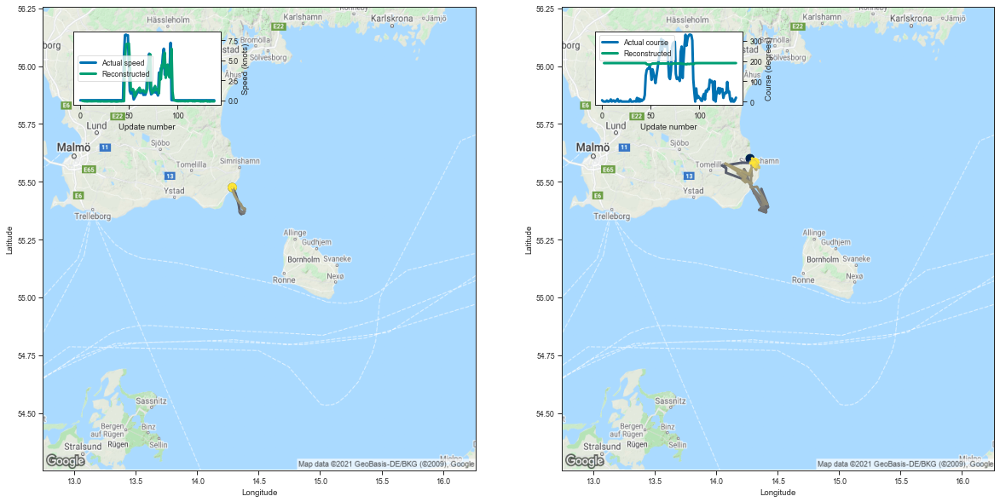

[-0.0646364688873291, -0.07860684394836426, -0.11729693412780762, -0.12919902801513672]
tensor([ 54.7485,  13.3331,   1.8737, 174.7257])
tensor([3.7384e-02, 1.0154e-01, 1.6413e+00, 7.6602e+01])


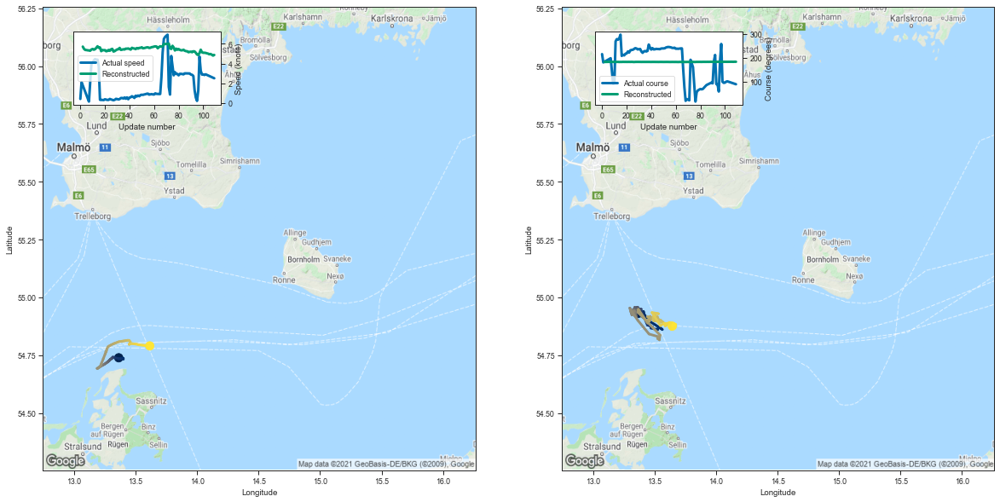

[5.71589469909668, 5.487687110900879, 5.377567768096924, 5.366544246673584]
tensor([54.9281, 14.5208, 12.4297, 98.3326])
tensor([ 0.1333,  0.8811,  0.8728, 19.2069])


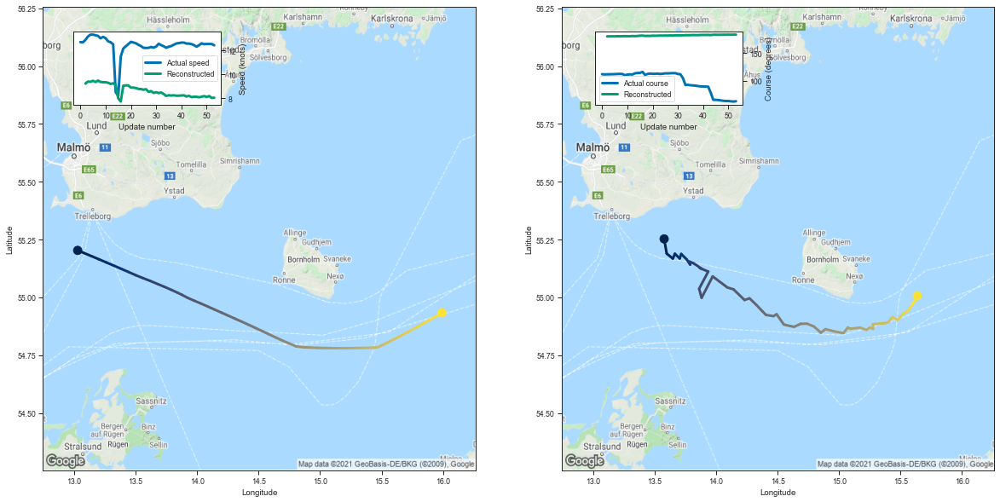

[9.2305908203125, 9.403999328613281, 9.385475158691406, 9.465206146240234]
tensor([55.4405, 14.3226,  1.1002, 89.5530])
tensor([5.4533e-02, 5.7392e-02, 2.0212e+00, 1.1445e+02])


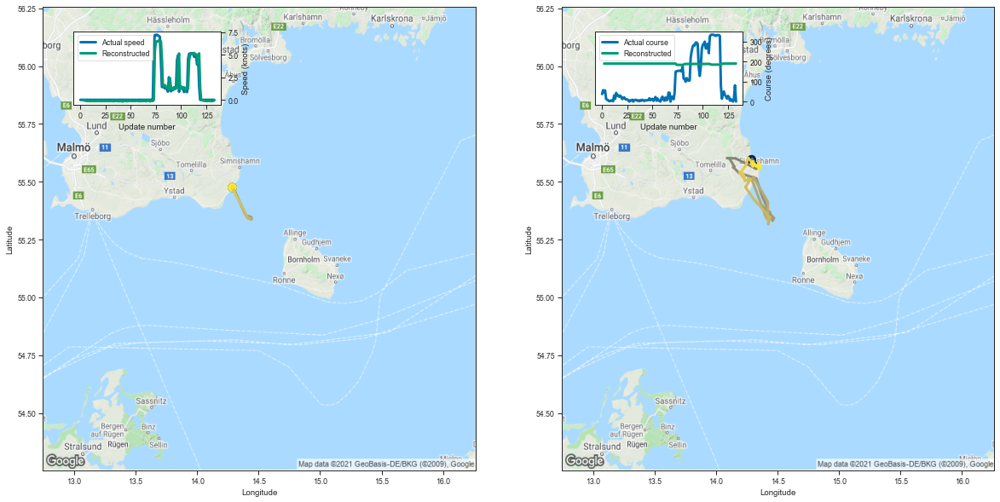

[0.003970146179199219, -0.04898977279663086, -0.05947399139404297, -0.10170674324035645]
tensor([ 54.5973,  13.5240,   6.1555, 211.3690])
tensor([3.4436e-02, 1.0118e-01, 2.7910e+00, 9.3497e+01])


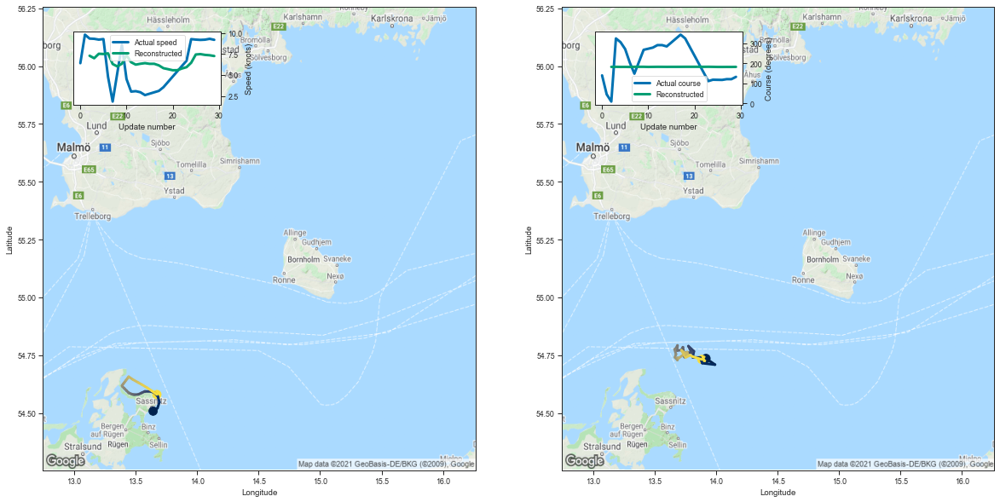

[7.28558349609375, 6.9896240234375, 7.519845008850098, 7.493532180786133]
tensor([55.3540, 14.5226,  9.9475, 74.4031])
tensor([ 0.1894,  0.8470,  0.2342, 19.8061])


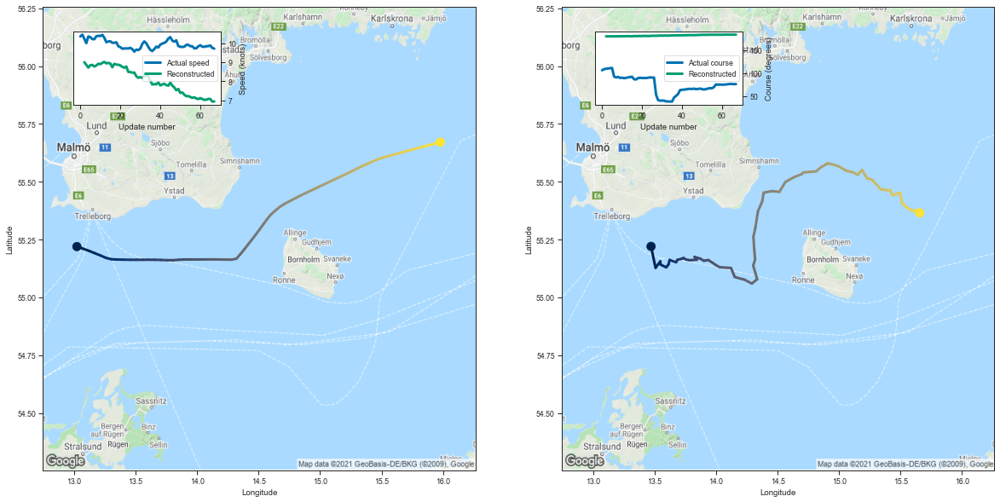

[9.003630638122559, 8.865728378295898, 8.720212936401367, 8.843032836914062]
tensor([ 54.7636,  13.4322,   2.9057, 166.9581])
tensor([3.6654e-02, 1.8830e-01, 1.6315e+00, 9.5108e+01])


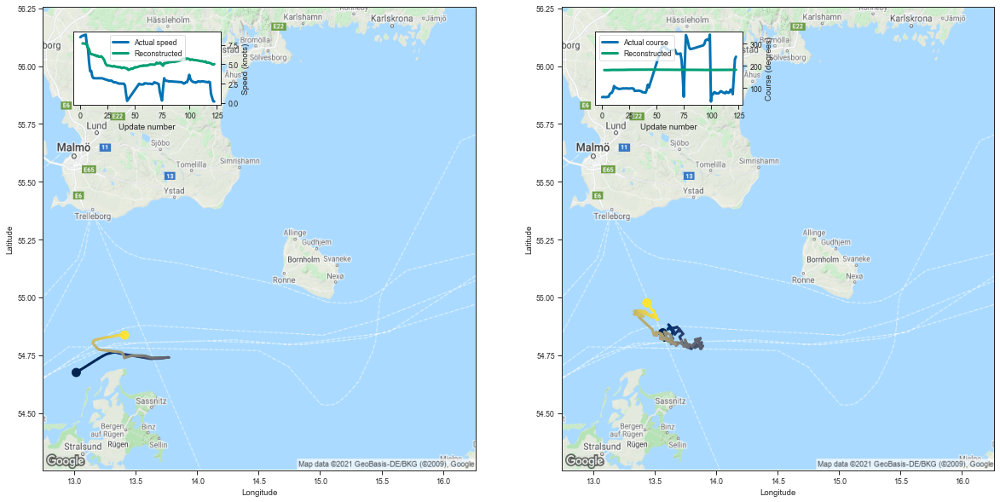

[7.67279052734375, 7.701426029205322, 7.661802768707275, 7.664465427398682]


,Data set Index,Index,MMSI,Ship type,Length,Reconstruction log probability,Equally weighted reconstruction log probability
37,37,1615516,220339000,Fishing,64,-711.655579,-11.119618
101,101,1176042,211755650,Fishing,30,-283.627808,-9.454260
69,69,461902,211317720,Fishing,109,-1025.518066,-9.408423
93,93,4746833,265551874,Fishing,139,-1196.401367,-8.607204
21,21,19488,211243240,Fishing,110,-940.030640,-8.545733
36,36,7969192,273352230,Fishing,54,-458.856628,-8.497345
104,104,5025657,265681420,Fishing,134,-1133.360107,-8.457911
73,73,1113112,211542610,Fishing,30,-252.770294,-8.425676
97,97,7993496,273513600,Fishing,68,-562.140869,-8.266777
2,2,295372,211314800,Fishing,124,-1003.006165,-8.088759


In [8]:
# Focus on the n worst cargo reconstructions
data = summary_models.run_evaluation_get_n(n=n, worst=True)
df_n = data["TrajectoryLevelData"]
train_evaluate = data["TrainEvaluateObject"]

# Plot the actual and reconstructed trajectories side by side
for idx in range(n): 
    tracks = plot_actual_reconstructed(idx)
    print(list(tracks["Reconstructed trajectory"]["Speed"])[:4])
df_n

# Best 100 Reconstructions

tensor([ 55.1874,  14.7416,   2.0111, 188.3894])
tensor([ 0.3833,  0.5341,  2.8683, 99.4569])
tensor([ 55.1874,  14.7416,   2.0111, 188.3894])
tensor([ 0.3833,  0.5341,  2.8683, 99.4569])
tensor([ 55.1874,  14.7416,   2.0111, 188.3894])
tensor([ 0.3833,  0.5341,  2.8683, 99.4569])
C:\Github\vessel-trajectory-anomaly-detection\models\saved-models\VRNN_RegionBornholm_01062019_30092019_Fish_14400_86400_600_latent100_recurrent100_batchNormFalse_Diagonal_GBT_lr0005.pth
tensor([5.5556e+01, 1.4359e+01, 1.9854e-03, 2.0578e+02])
tensor([1.6826e-05, 1.9222e-05, 5.2639e-03, 3.3364e+01])


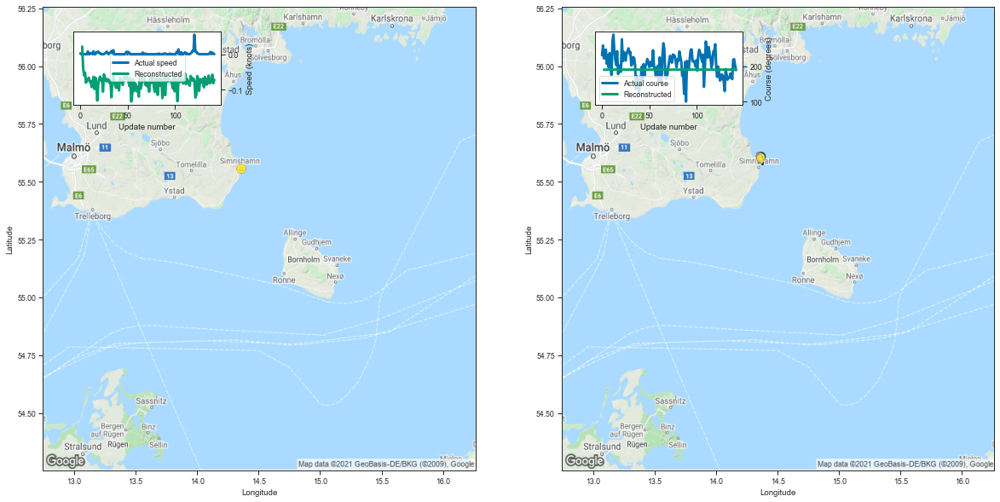

[0.02121734619140625, -0.04053378105163574, -0.05935025215148926, -0.05193305015563965]
tensor([5.5557e+01, 1.4359e+01, 1.5834e-03, 2.0796e+02])
tensor([1.5939e-05, 1.5923e-05, 3.4240e-03, 3.3565e+01])


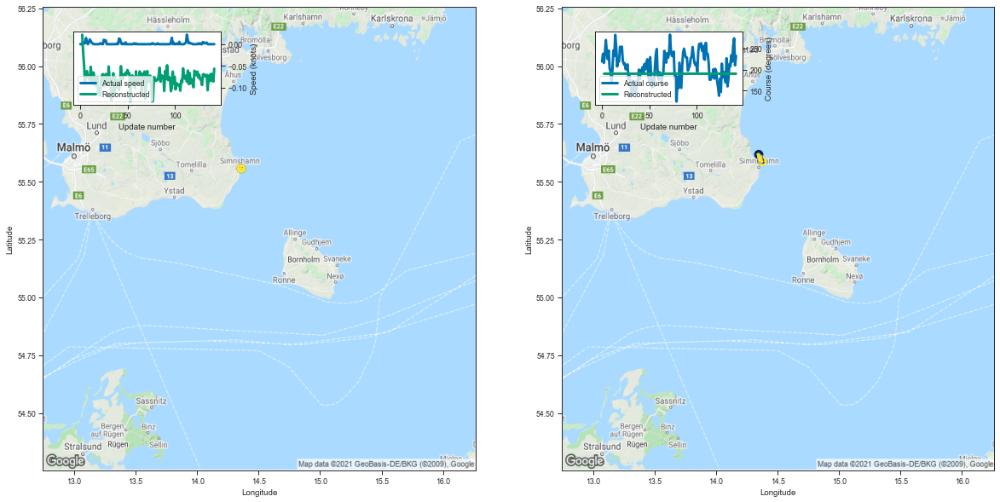

[0.021756649017333984, -0.018731117248535156, -0.04892730712890625, -0.09227943420410156]
tensor([5.5556e+01, 1.4359e+01, 1.7899e-03, 2.0624e+02])
tensor([1.9884e-05, 1.9990e-05, 4.4066e-03, 3.0646e+01])


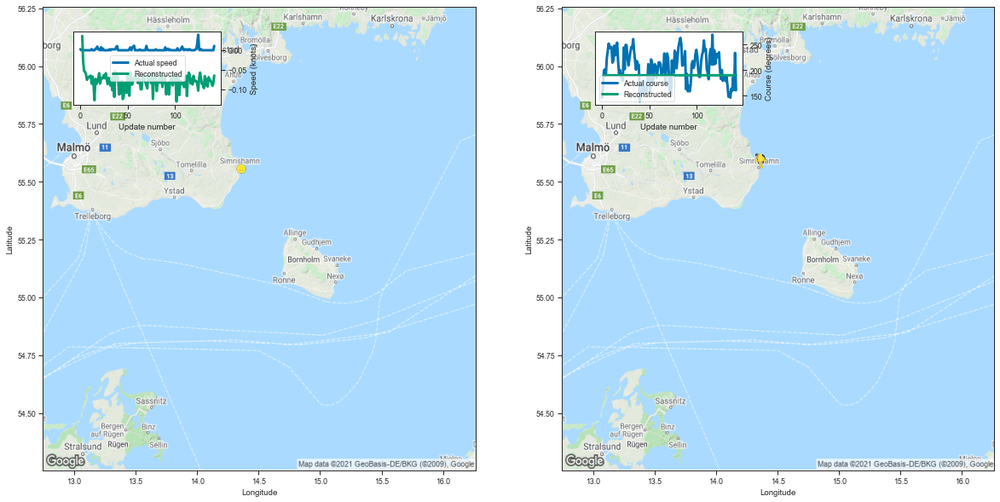

[0.036580562591552734, -0.029070377349853516, -0.053174495697021484, -0.05523514747619629]
tensor([5.5556e+01, 1.4359e+01, 1.8189e-03, 2.0487e+02])
tensor([2.1247e-05, 2.1394e-05, 3.6266e-03, 3.4320e+01])


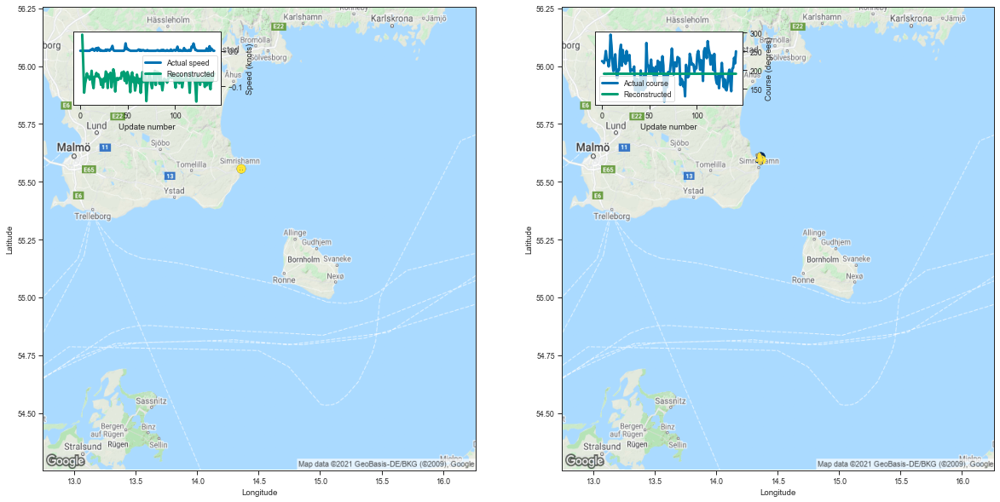

[0.04538846015930176, -0.027726411819458008, -0.1176760196685791, -0.09255790710449219]
tensor([5.5555e+01, 1.4360e+01, 1.4317e-03, 2.0381e+02])
tensor([1.4610e-05, 1.8222e-05, 3.0216e-03, 3.5571e+01])


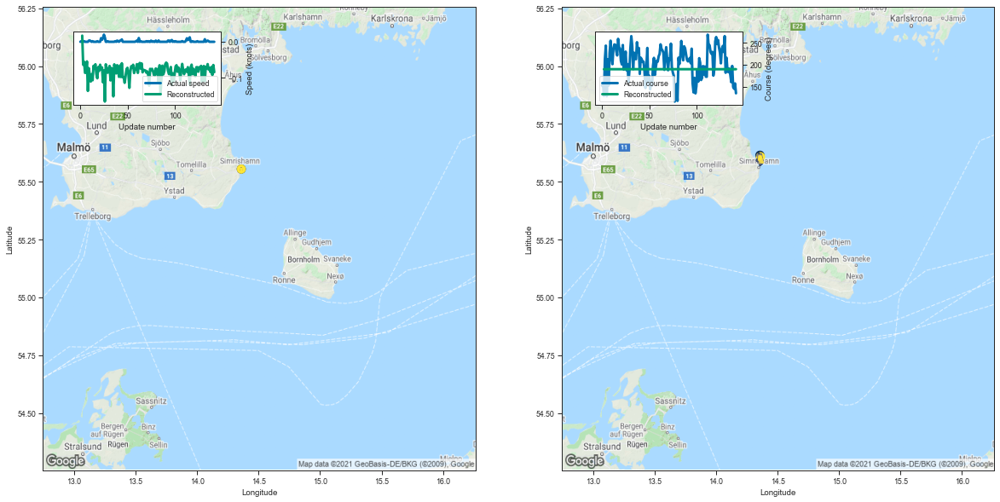

[0.01714158058166504, -0.06395411491394043, -0.05551648139953613, -0.08652877807617188]
tensor([5.5556e+01, 1.4358e+01, 1.4468e-05, 1.9023e+02])
tensor([1.1947e-05, 1.4593e-05, 1.7361e-04, 5.0448e+01])


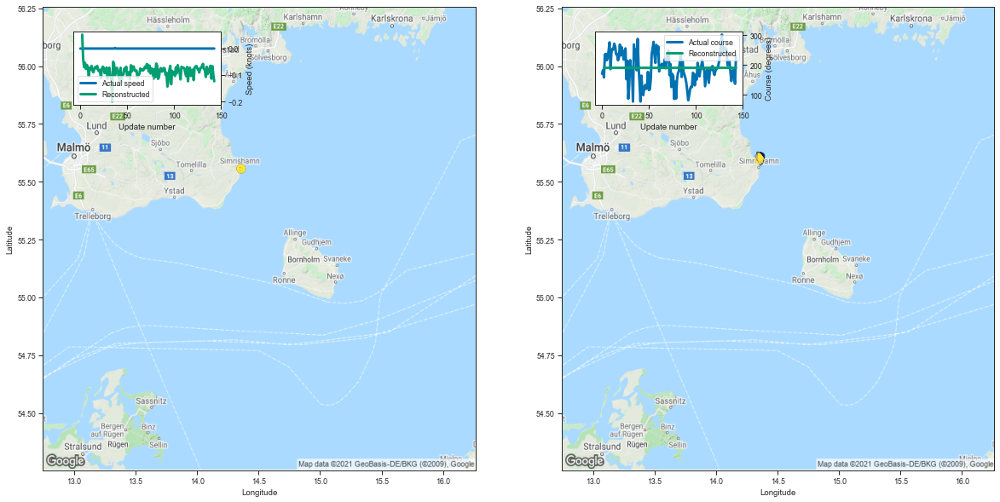

[0.05256938934326172, -0.03723406791687012, -0.06978225708007812, -0.0544891357421875]
tensor([ 55.5562,  14.3581,   0.0000, 178.0486])
tensor([1.0046e-05, 1.3288e-05, 0.0000e+00, 4.7751e+01])


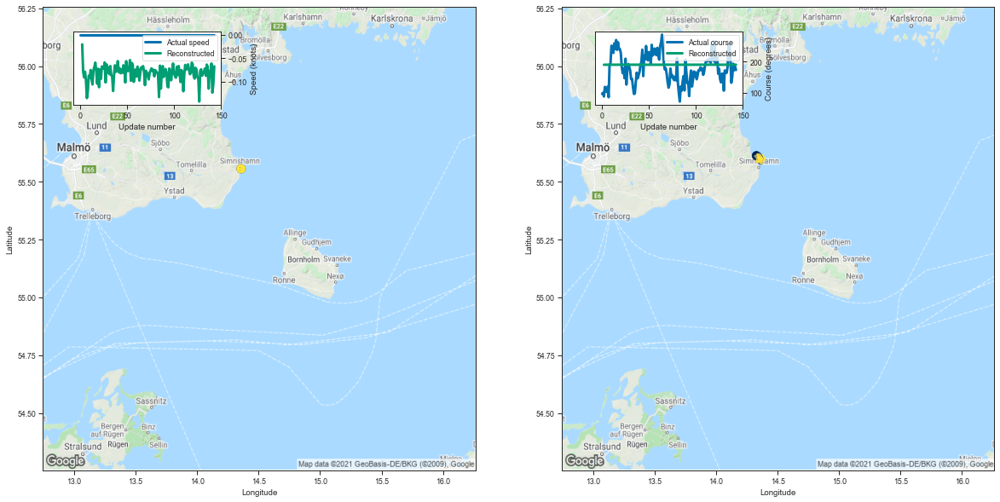

[-0.020653247833251953, -0.07843565940856934, -0.09072542190551758, -0.07879924774169922]
tensor([5.5556e+01, 1.4358e+01, 5.1076e-05, 1.7585e+02])
tensor([1.1804e-05, 1.2762e-05, 4.3234e-04, 5.6761e+01])


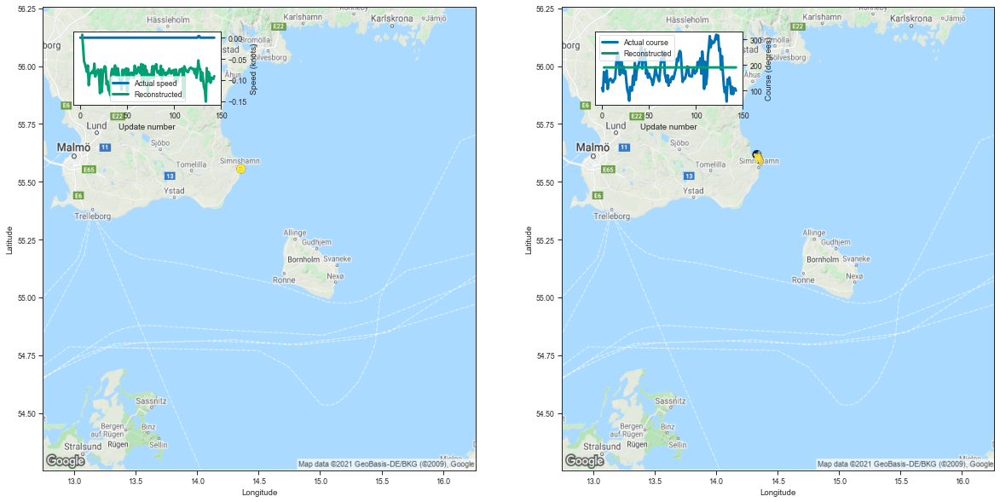

[0.007216691970825195, -0.02446603775024414, -0.05577874183654785, -0.062447547912597656]
tensor([5.5556e+01, 1.4359e+01, 1.2746e-04, 2.6330e+02])
tensor([5.3357e-06, 6.0492e-06, 5.4085e-04, 1.2251e-05])


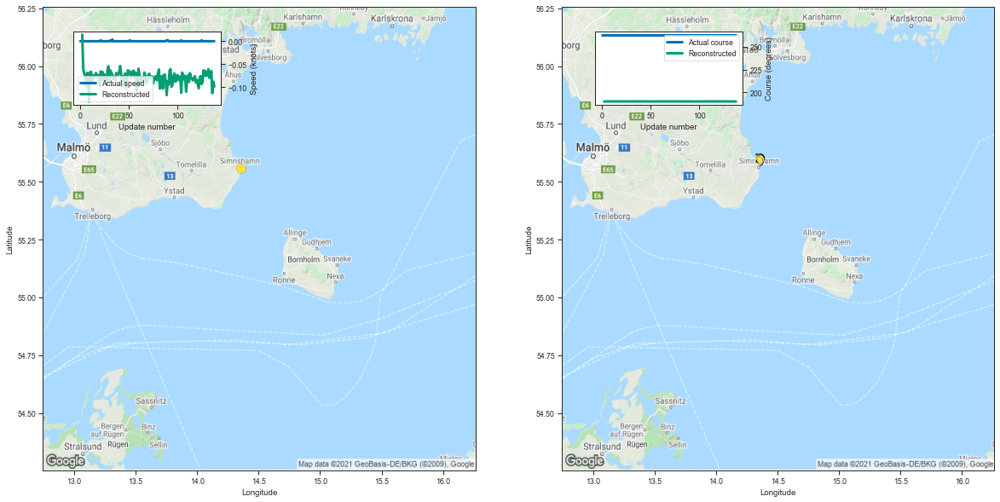

[0.01432657241821289, -0.060007333755493164, -0.07096695899963379, -0.07381772994995117]
tensor([5.5556e+01, 1.4359e+01, 5.8275e-05, 2.6156e+02])
tensor([1.3188e-05, 2.0780e-05, 6.9687e-04, 3.2196e+01])


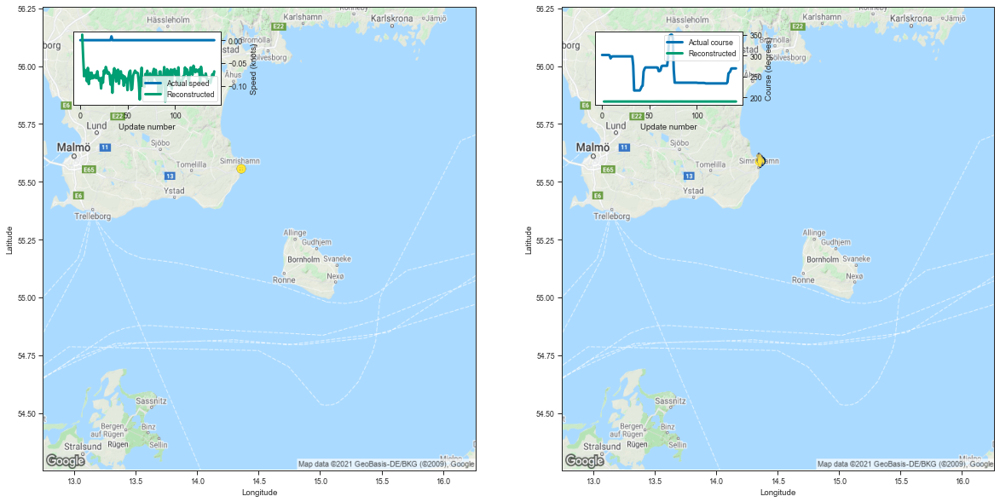

[0.01210927963256836, -0.03733038902282715, -0.07881999015808105, -0.06521916389465332]
tensor([5.5248e+01, 1.4836e+01, 2.2322e-03, 1.9636e+02])
tensor([1.1277e-05, 1.3555e-05, 4.0611e-03, 3.5979e+01])


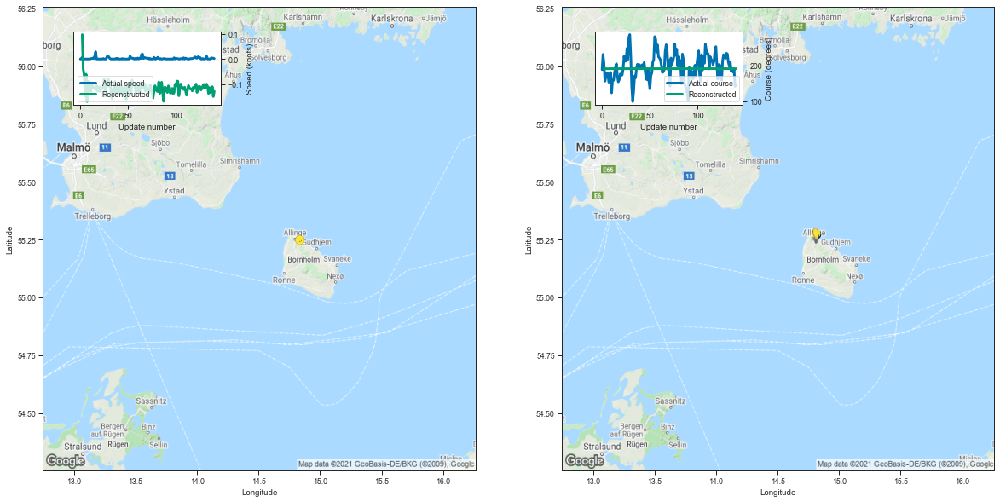

[0.09635686874389648, -0.03942108154296875, -0.06366705894470215, -0.1465144157409668]
tensor([5.5248e+01, 1.4836e+01, 2.0995e-03, 1.8671e+02])
tensor([1.0299e-05, 1.1832e-05, 4.3549e-03, 3.4664e+01])


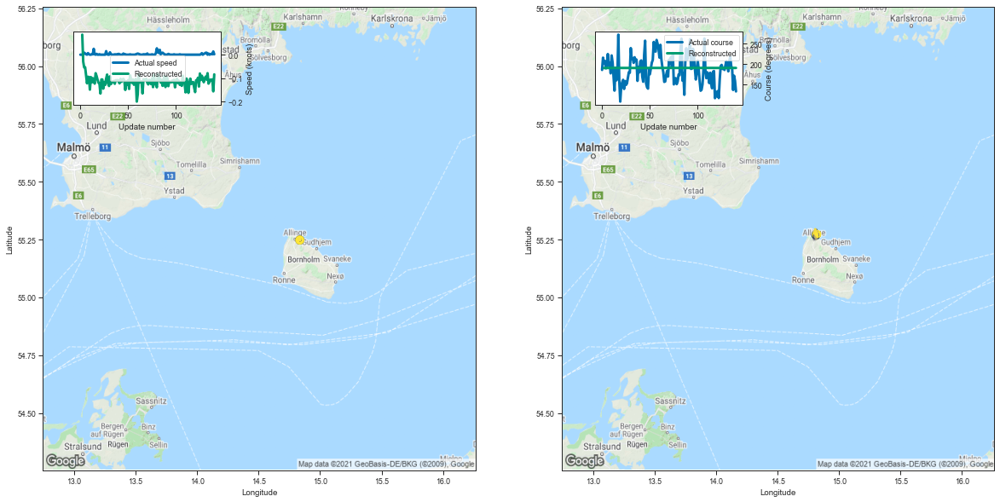

[0.08566093444824219, -0.02957010269165039, -0.05394244194030762, -0.053498268127441406]
tensor([5.5248e+01, 1.4836e+01, 2.9729e-03, 1.8635e+02])
tensor([1.0104e-05, 1.2315e-05, 6.2088e-03, 3.5488e+01])


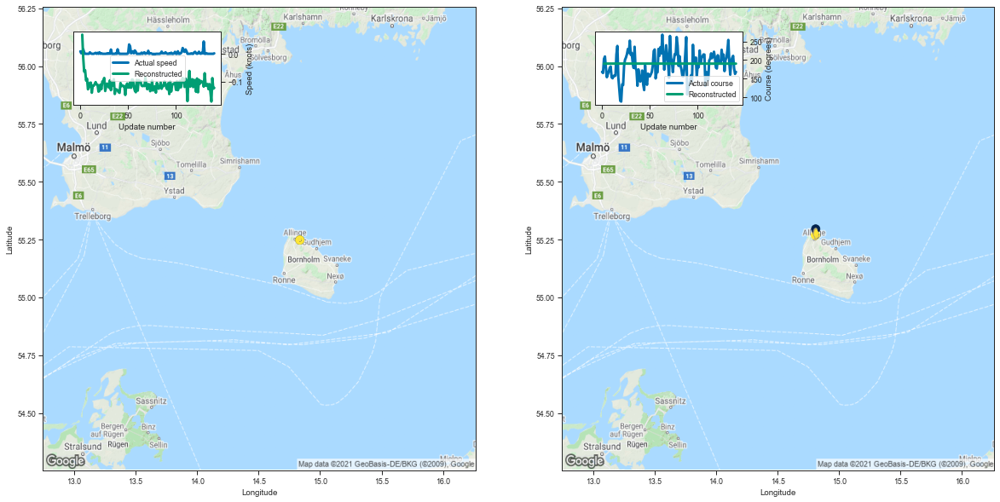

[0.0685427188873291, -0.01334071159362793, -0.06348276138305664, -0.05878901481628418]
tensor([5.5248e+01, 1.4836e+01, 2.3585e-03, 1.8791e+02])
tensor([1.2304e-05, 1.3978e-05, 5.0331e-03, 3.6987e+01])


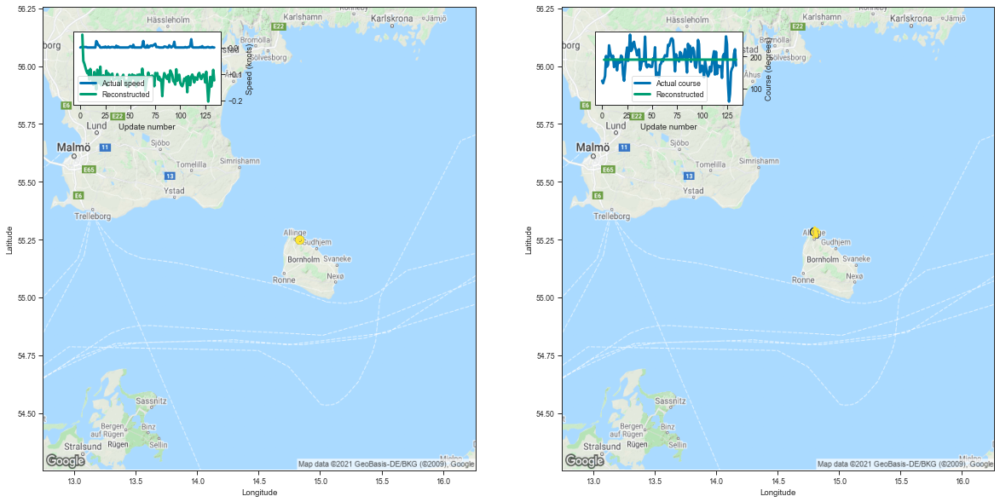

[0.048482656478881836, -0.050353288650512695, -0.06065177917480469, -0.0743265151977539]
tensor([5.5248e+01, 1.4836e+01, 2.3489e-03, 1.8593e+02])
tensor([1.1241e-05, 1.0416e-05, 5.2819e-03, 3.9374e+01])


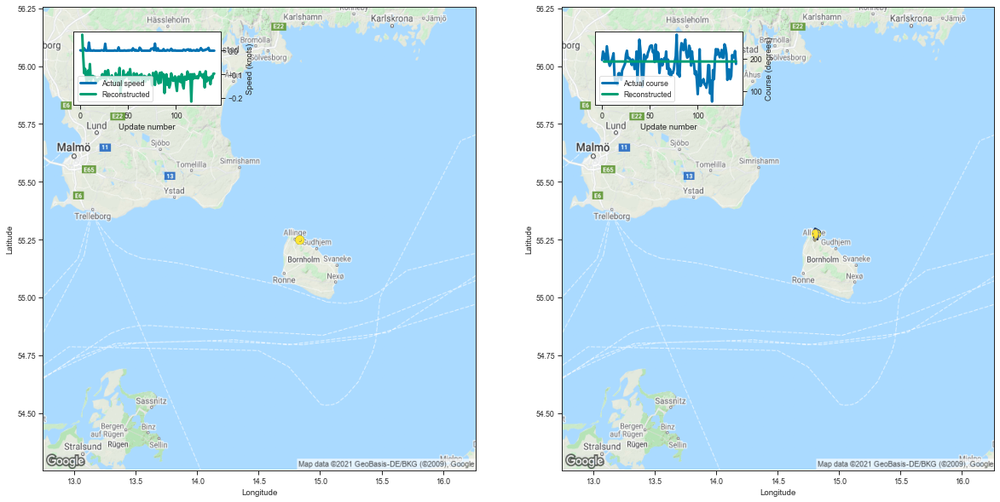

[0.06780076026916504, -0.024564266204833984, -0.09560990333557129, -0.0765371322631836]
tensor([5.5248e+01, 1.4836e+01, 2.7398e-03, 1.8156e+02])
tensor([1.1425e-05, 1.4193e-05, 5.1823e-03, 3.6246e+01])


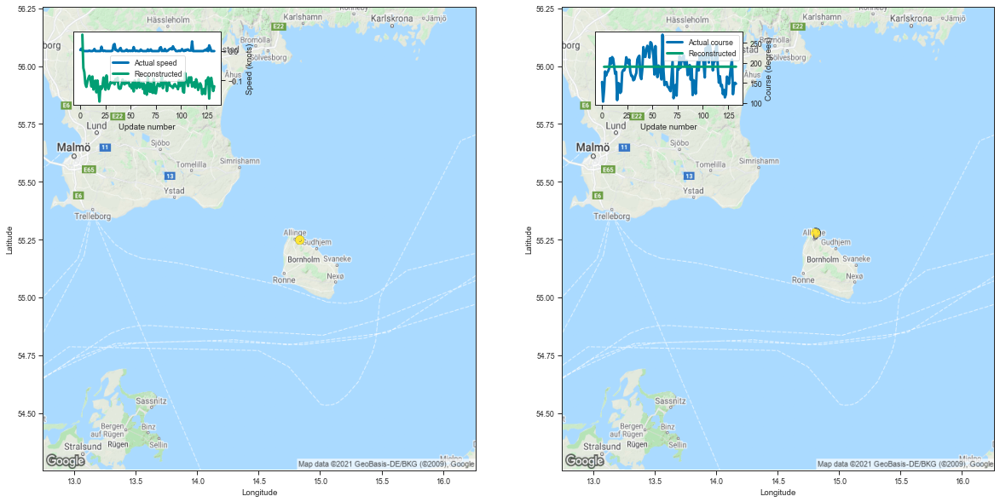

[0.05595517158508301, -0.05735588073730469, -0.07204556465148926, -0.11141085624694824]
tensor([5.5556e+01, 1.4359e+01, 1.2057e-05, 2.7593e+02])
tensor([1.0283e-05, 1.7802e-05, 1.4418e-04, 3.8223e+01])


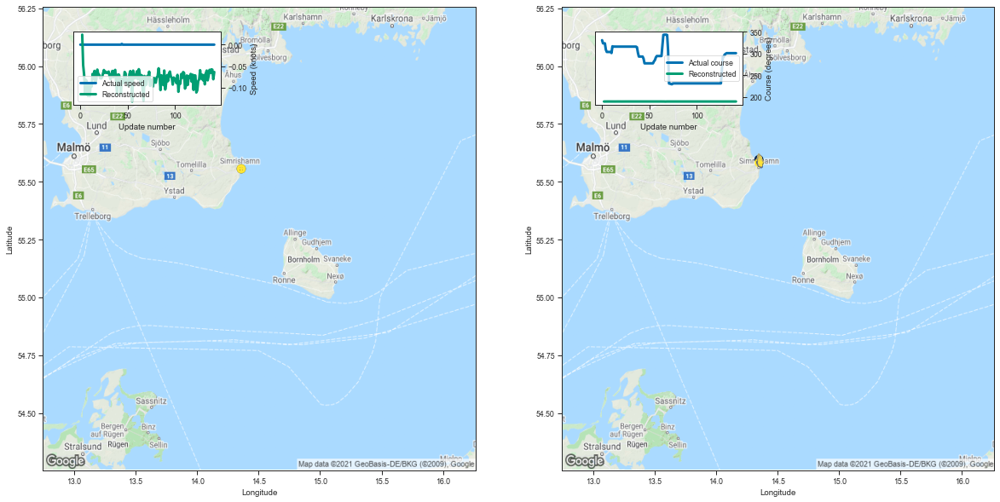

[0.023236513137817383, -0.047579050064086914, -0.06943702697753906, -0.11152029037475586]
tensor([5.5556e+01, 1.4358e+01, 1.0429e-02, 2.4620e+02])
tensor([4.2111e-04, 1.3329e-03, 1.0064e-01, 5.4970e+01])


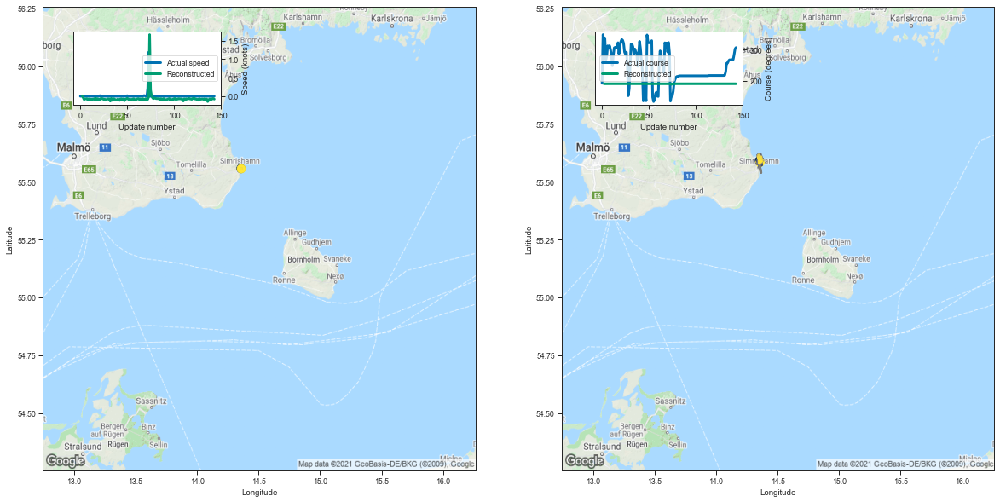

[0.012774467468261719, -0.03436398506164551, -0.08693099021911621, -0.07174992561340332]
tensor([ 55.0593,  15.1356,   0.0000, 239.8148])
tensor([5.8597e-06, 1.0010e-05, 0.0000e+00, 5.1630e+01])


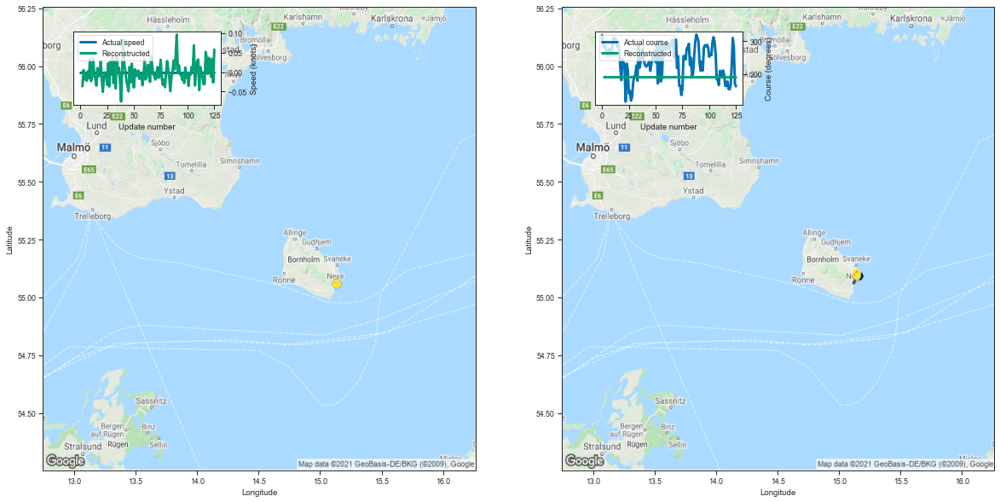

[-0.03639817237854004, 0.005070924758911133, -0.018728971481323242, -0.005521535873413086]
tensor([ 55.0579,  15.1374,   0.0000, 249.9918])
tensor([5.6934e-06, 1.0473e-05, 0.0000e+00, 5.7157e+01])


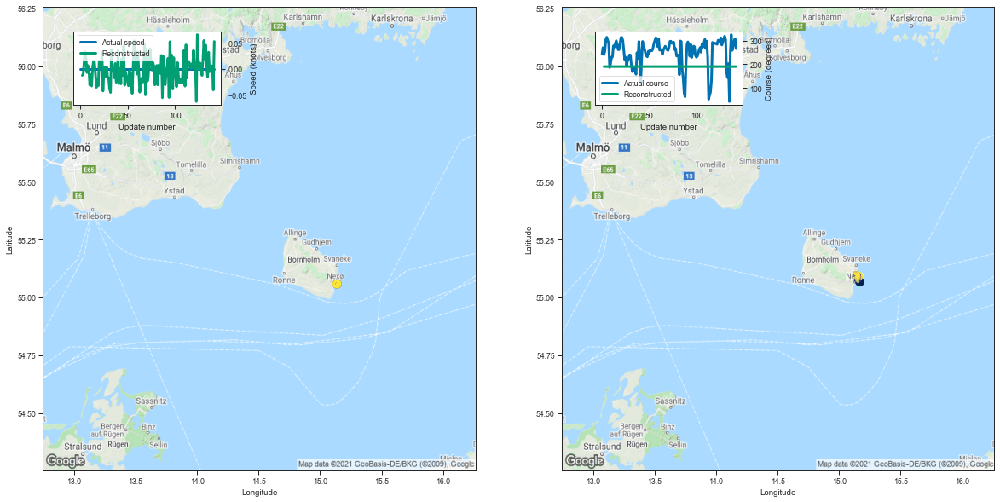

[-0.012542247772216797, -0.011139154434204102, 0.01334834098815918, 0.0325772762298584]
tensor([ 55.0579,  15.1374,   0.0000, 248.7392])
tensor([5.7354e-06, 9.6195e-06, 0.0000e+00, 5.8187e+01])


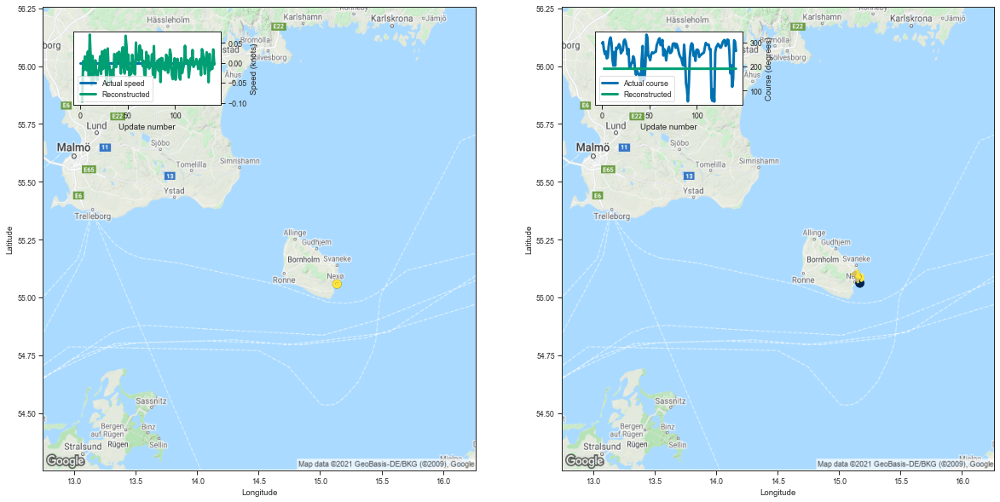

[-0.09712839126586914, 0.003814697265625, -0.018227338790893555, 0.015770435333251953]
tensor([ 55.0579,  15.1374,   0.0000, 250.7191])
tensor([7.0177e-06, 7.4908e-06, 0.0000e+00, 5.8639e+01])


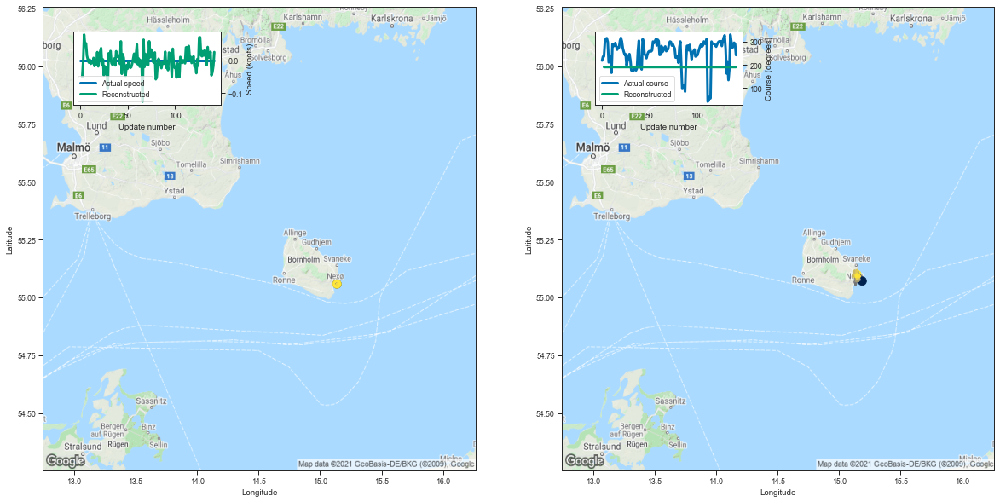

[-0.051664113998413086, -0.0043849945068359375, 0.0781867504119873, 0.04662799835205078]
tensor([ 55.0579,  15.1374,   0.0000, 251.3835])
tensor([5.6027e-06, 8.1008e-06, 0.0000e+00, 5.8073e+01])


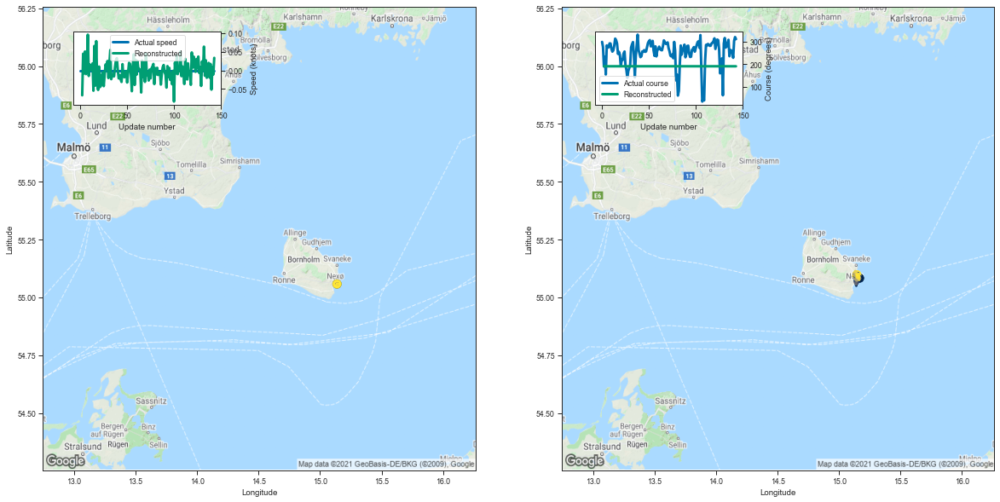

[-0.06708812713623047, 0.04466676712036133, -0.00809025764465332, 0.05066037178039551]
tensor([5.5058e+01, 1.5137e+01, 7.6196e-05, 2.4714e+02])
tensor([7.2295e-06, 8.2620e-06, 5.0200e-04, 6.3292e+01])


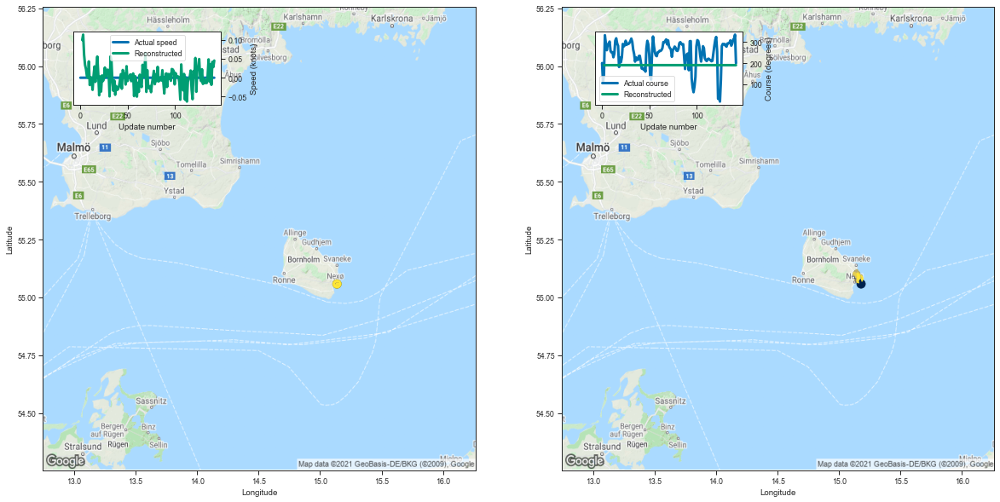

[0.09955894947052002, 0.11378943920135498, 0.06032109260559082, 0.03395366668701172]
tensor([ 55.0579,  15.1374,   0.0000, 250.5422])
tensor([6.7018e-06, 9.1333e-06, 0.0000e+00, 5.8940e+01])


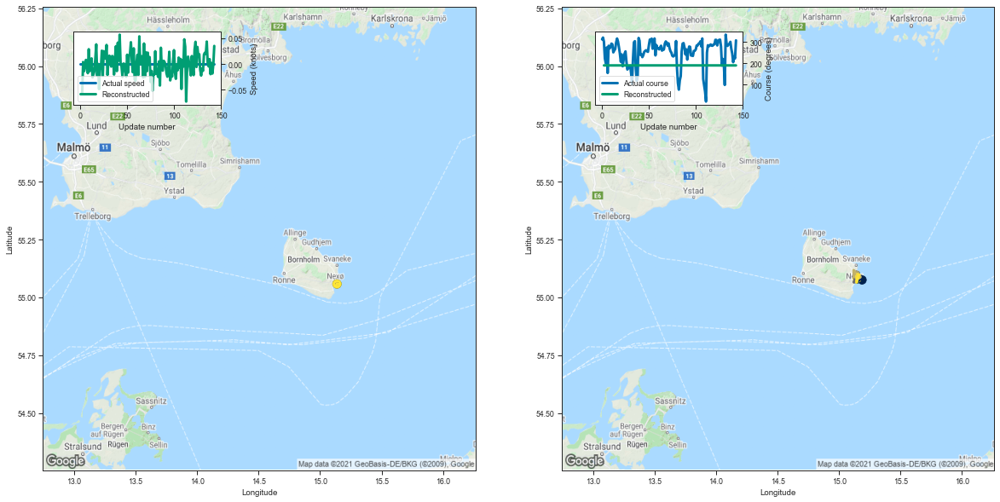

[-0.0554652214050293, 0.003889322280883789, -0.013979196548461914, -0.007306098937988281]
tensor([ 55.0579,  15.1374,   0.0000, 246.9806])
tensor([5.9531e-06, 1.1216e-05, 0.0000e+00, 6.4243e+01])


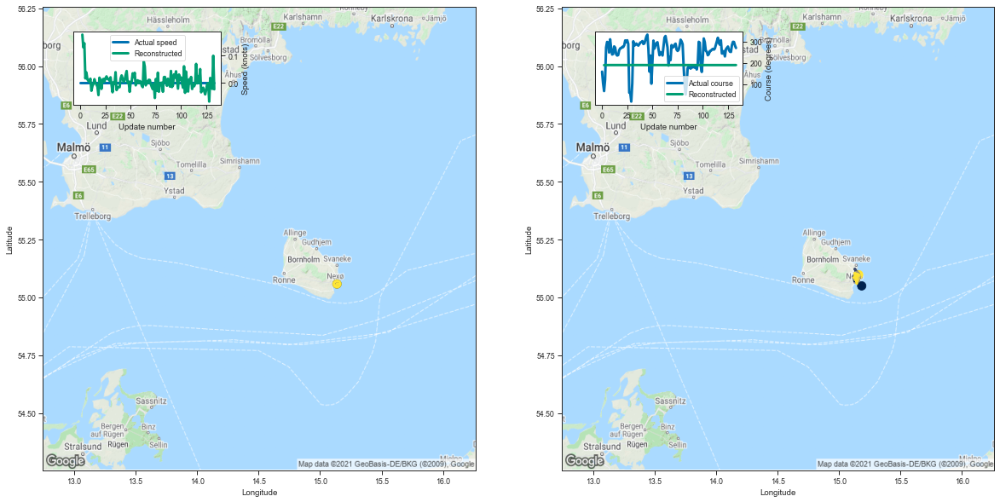

[0.1764317750930786, 0.12997937202453613, 0.14496183395385742, 0.01668071746826172]
tensor([ 55.0579,  15.1374,   0.0000, 250.6585])
tensor([6.1371e-06, 8.2367e-06, 0.0000e+00, 5.9951e+01])


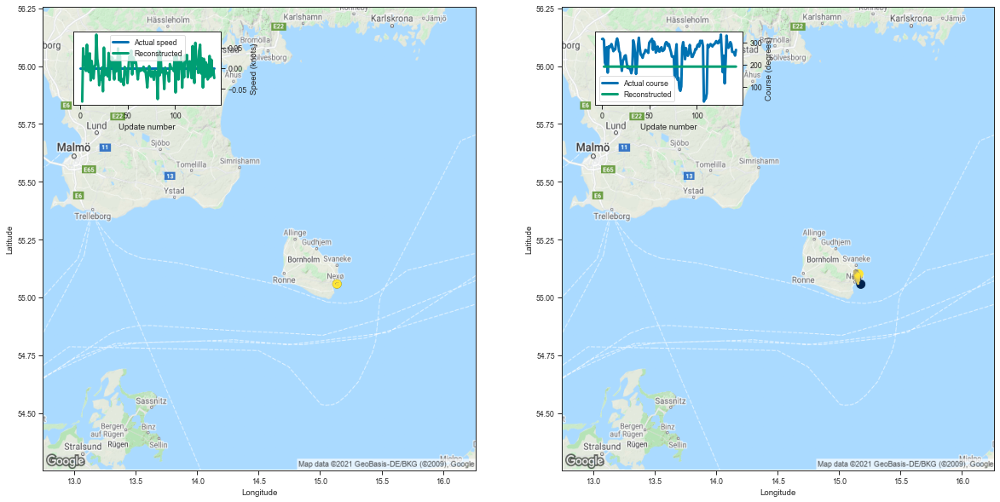

[-0.08037543296813965, 0.04802441596984863, 0.006620645523071289, 0.026868581771850586]
tensor([ 55.5412,  14.3965,   1.2095, 247.5280])
tensor([ 0.0518,  0.1217,  3.3327, 20.8952])


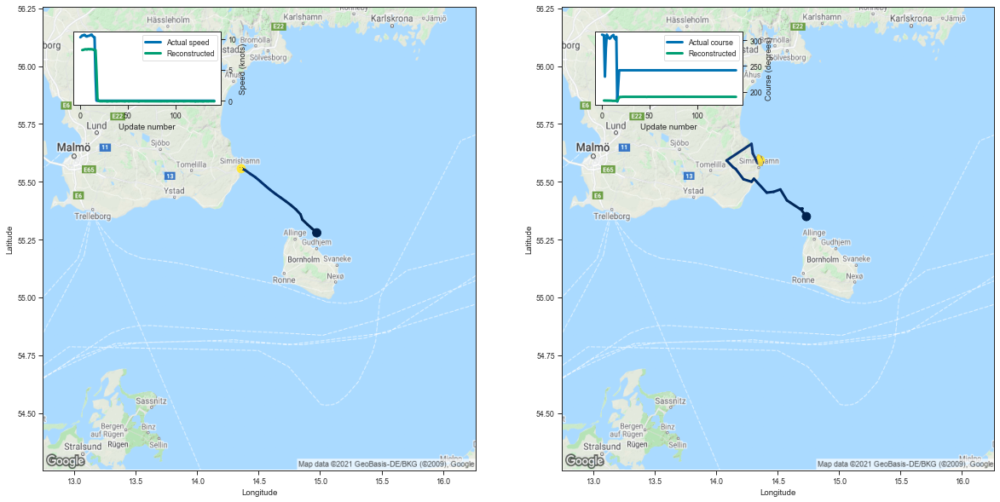

[8.189870834350586, 8.216161727905273, 8.274757385253906, 8.316946029663086]
tensor([5.5249e+01, 1.4834e+01, 1.6508e-03, 2.6019e+02])
tensor([1.5918e-05, 1.6902e-05, 4.8701e-03, 6.7896e+01])


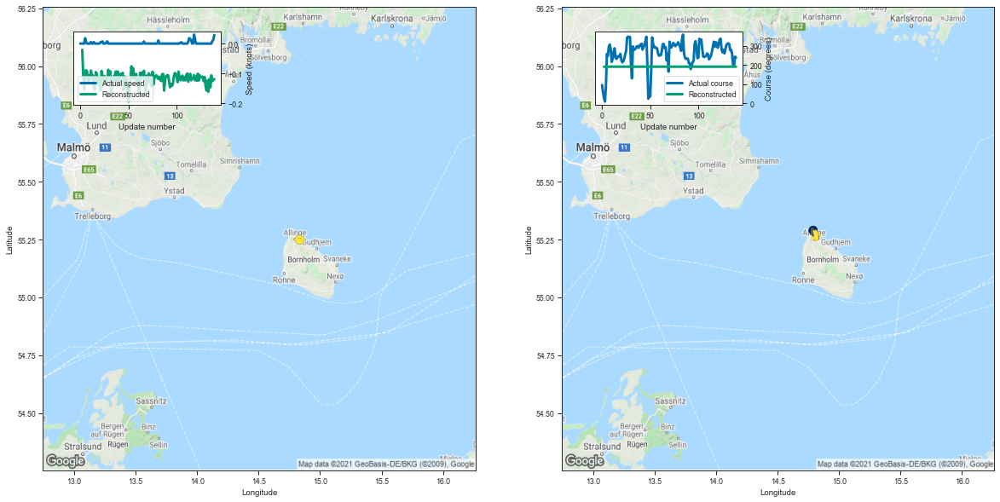

[-0.020751953125, -0.10560321807861328, -0.1545102596282959, -0.09079551696777344]
tensor([5.5249e+01, 1.4836e+01, 4.1522e-04, 2.6597e+02])
tensor([1.2465e-05, 1.7469e-05, 1.6634e-03, 6.2156e+01])


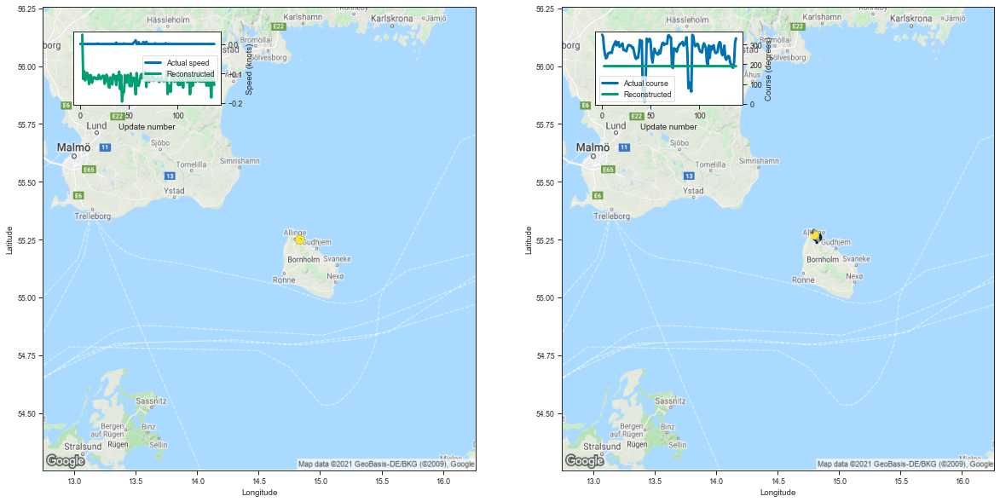

[0.03157925605773926, -0.1182706356048584, -0.09192132949829102, -0.12317061424255371]
tensor([5.5249e+01, 1.4834e+01, 2.1195e-03, 2.5687e+02])
tensor([1.6970e-05, 1.8115e-05, 8.0770e-03, 7.3126e+01])


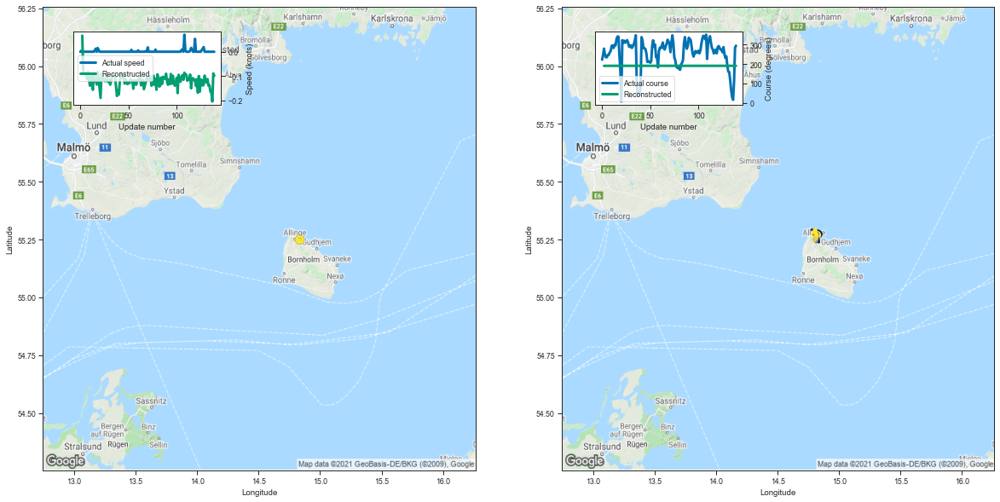

[0.06579923629760742, -0.07678771018981934, -0.08904623985290527, -0.0867762565612793]
tensor([5.5249e+01, 1.4834e+01, 1.1030e-03, 9.2712e+01])
tensor([1.7296e-05, 2.2337e-05, 1.6698e-03, 5.3790e+01])


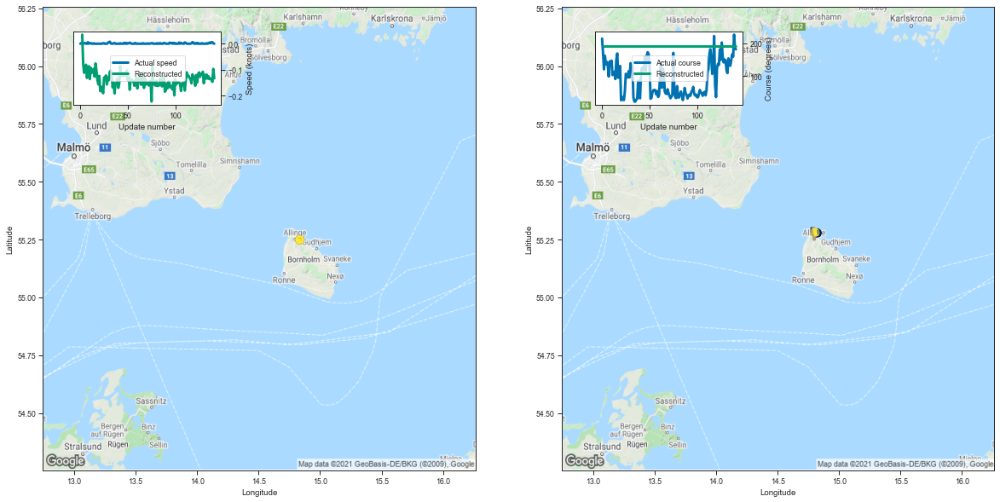

[0.0349271297454834, -0.07767868041992188, -0.11183857917785645, -0.0983419418334961]
tensor([5.5557e+01, 1.4359e+01, 5.4972e-03, 6.4508e+01])
tensor([4.2627e-04, 5.2989e-04, 6.1241e-02, 4.5557e+01])


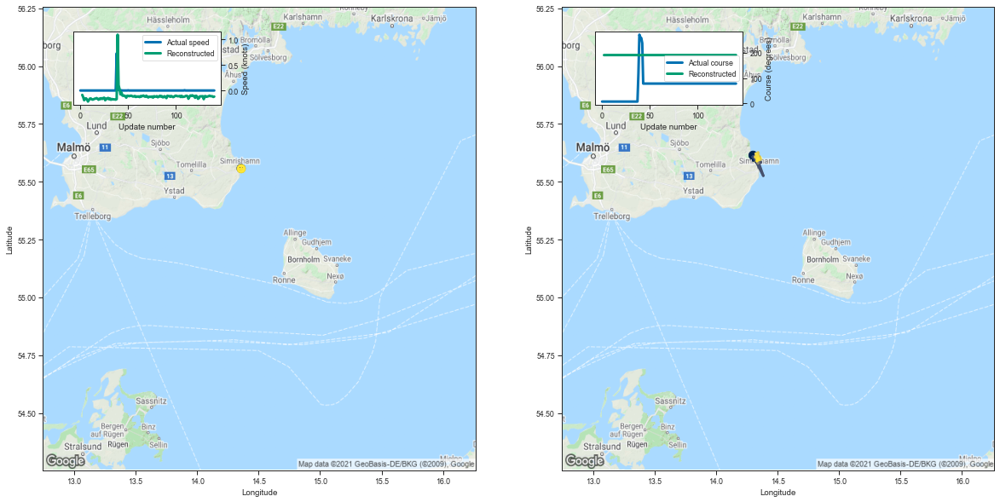

[-0.08590364456176758, -0.1298813819885254, -0.19064688682556152, -0.16045308113098145]
tensor([5.5557e+01, 1.4358e+01, 1.6916e-02, 1.3148e+02])
tensor([4.9887e-04, 1.5885e-04, 1.1674e-01, 1.2857e+02])


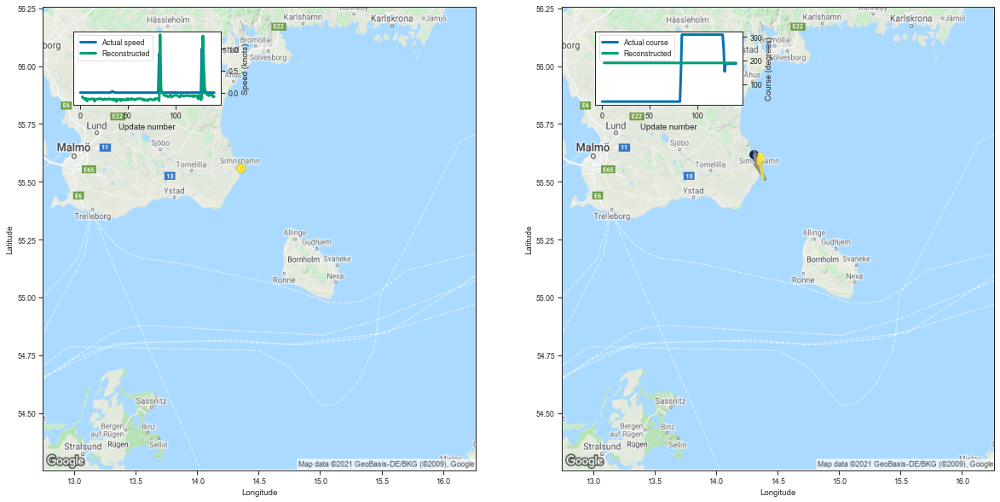

[-0.09256911277770996, -0.12340354919433594, -0.1335756778717041, -0.15755128860473633]
tensor([ 55.5575,  14.3557,   0.0000, 359.9000])
tensor([4.6983e-06, 9.6989e-06, 0.0000e+00, 6.1262e-06])


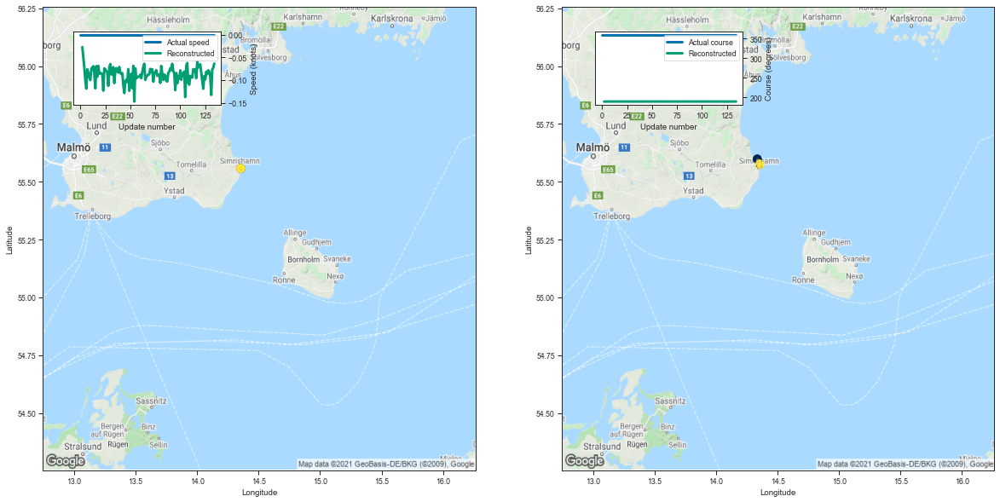

[-0.027301311492919922, -0.04936385154724121, -0.07260274887084961, -0.0998830795288086]
tensor([5.5557e+01, 1.4358e+01, 3.4792e-03, 2.9600e+01])
tensor([4.8970e-06, 5.2203e-06, 9.5962e-03, 3.8284e-07])


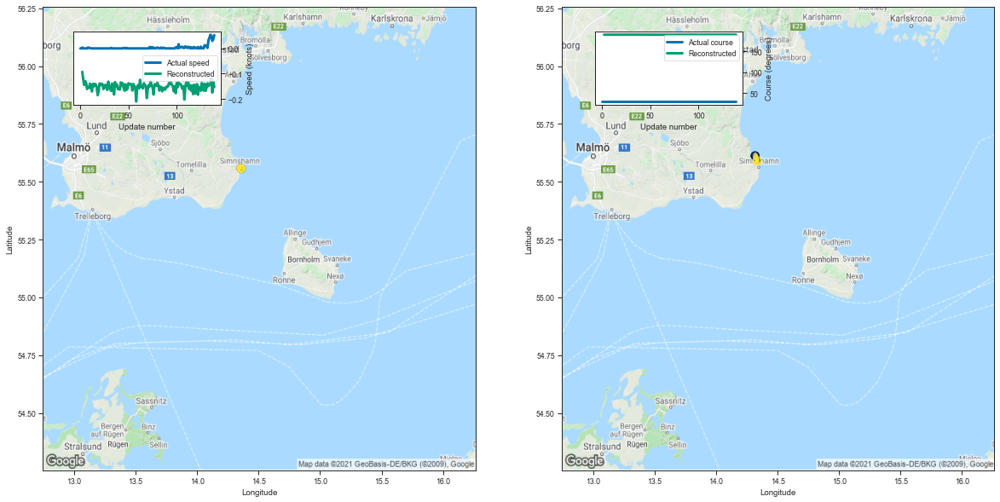

[-0.09261846542358398, -0.12216973304748535, -0.1443643569946289, -0.12955784797668457]
tensor([ 55.0030,  14.9918,   2.7452, 185.6507])
tensor([9.1987e-02, 2.7160e-01, 3.7914e+00, 9.4056e+01])


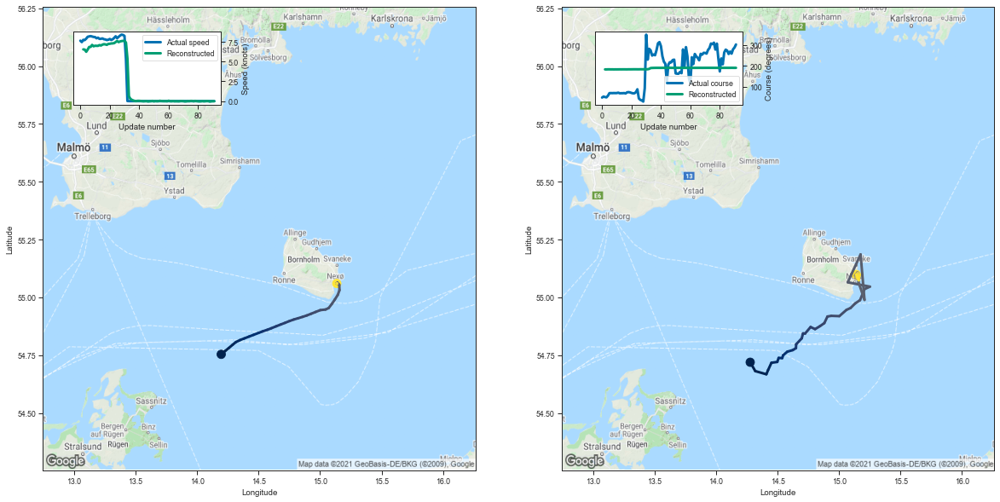

[6.543056964874268, 6.511789798736572, 6.241123676300049, 6.523128032684326]
tensor([ 55.0305,  15.2287,   2.0554, 188.3362])
tensor([4.9644e-02, 1.3842e-01, 2.7287e+00, 6.1349e+01])


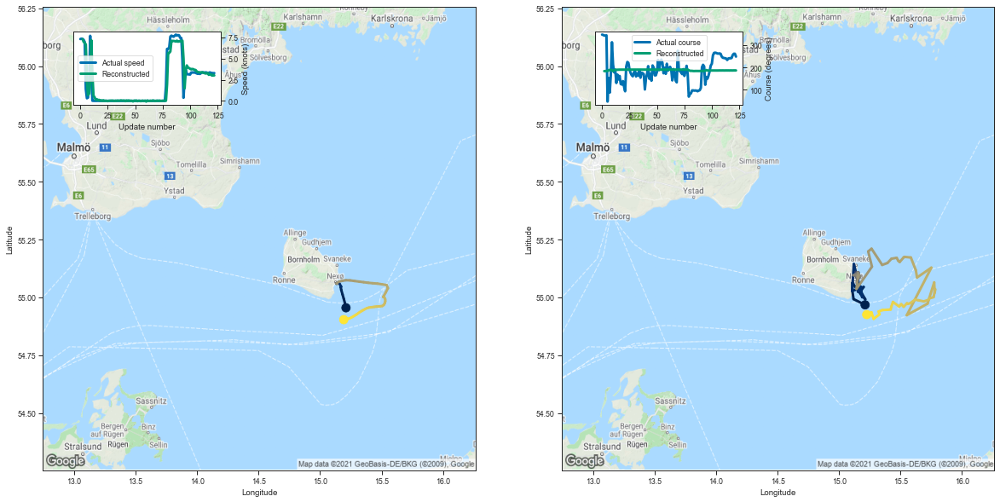

[7.30836296081543, 6.9989142417907715, 6.8584465980529785, 6.68506383895874]
tensor([5.5059e+01, 1.5136e+01, 9.7239e-05, 1.6521e+01])
tensor([1.5661e-05, 2.5005e-05, 6.5291e-04, 2.5169e+01])


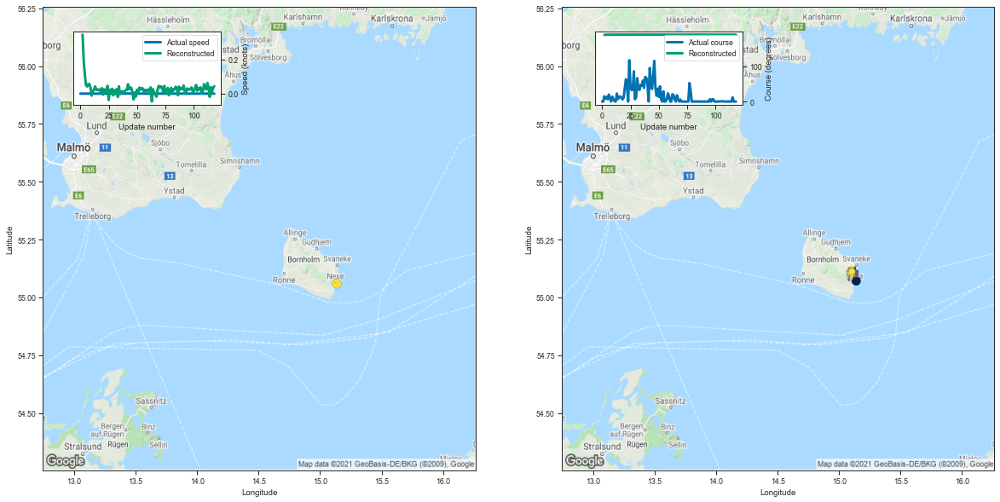

[0.34679293632507324, 0.18811655044555664, 0.11156964302062988, 0.0485842227935791]
tensor([55.4958, 14.4789,  2.1181, 93.6069])
tensor([  0.1440,   0.2689,   4.2121, 101.0195])


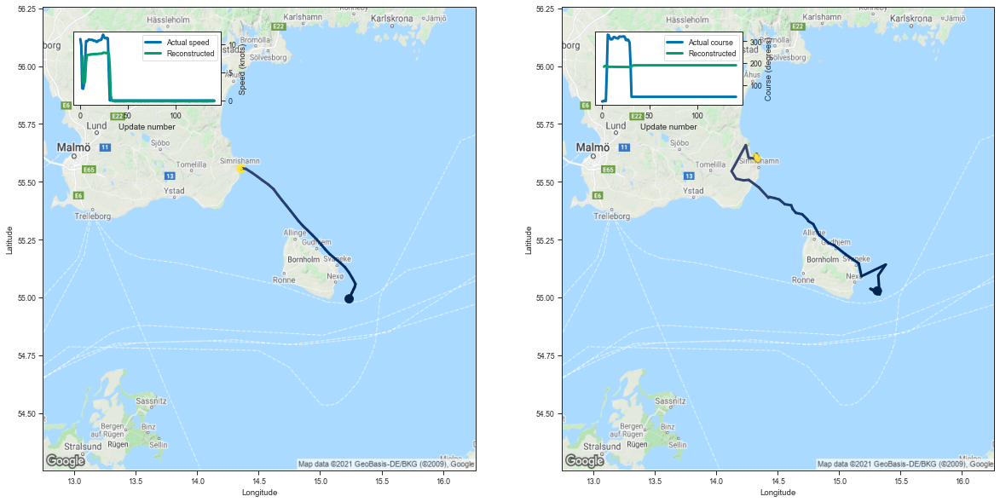

[7.931547164916992, 3.2496373653411865, 3.0418782234191895, 3.5401551723480225]
tensor([ 54.7992,  15.8821,   2.7418, 133.6083])
tensor([3.9265e-02, 6.6552e-02, 2.8357e-01, 8.8160e+01])


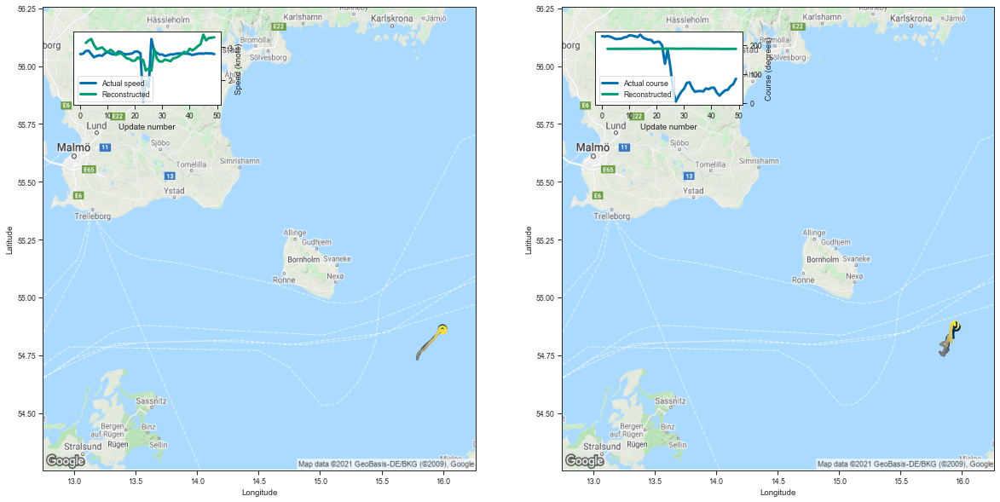

[3.1264376640319824, 3.200202226638794, 3.245349645614624, 3.0639760494232178]
tensor([ 54.7486,  15.7574,   2.6070, 155.0966])
tensor([6.8495e-02, 1.2469e-01, 3.5438e-01, 9.2143e+01])


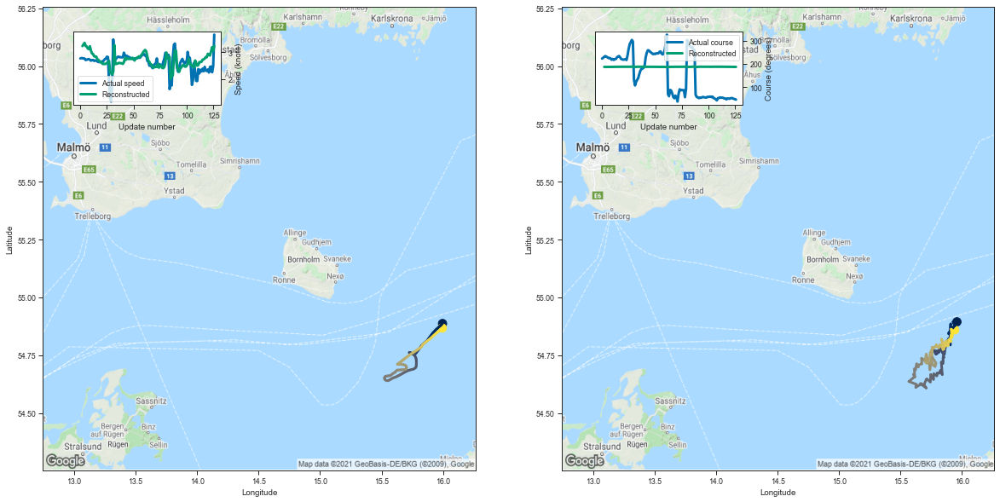

[3.221912384033203, 3.283813714981079, 3.341184616088867, 3.223436117172241]
tensor([ 54.7302,  15.7122,   2.8345, 170.5506])
tensor([5.5035e-02, 1.3895e-01, 5.7413e-01, 9.1804e+01])


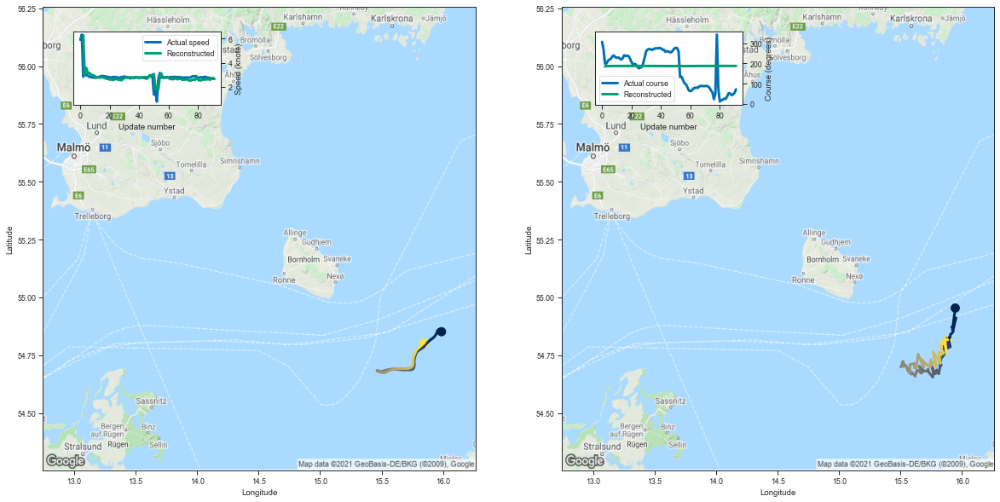

[6.282528877258301, 2.9919538497924805, 3.577406883239746, 3.1550097465515137]
tensor([ 54.6452,  15.1506,   3.0863, 145.5036])
tensor([3.9202e-02, 1.4885e-01, 1.6796e+00, 7.5061e+01])


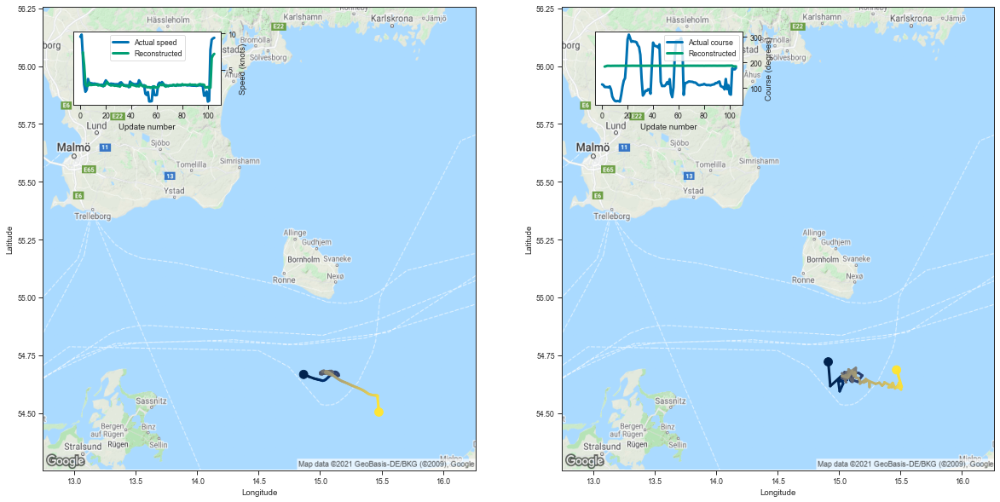

[7.382085800170898, 5.61422061920166, 2.9638166427612305, 2.733259439468384]
tensor([ 54.5719,  14.8498,   3.2641, 205.0469])
tensor([2.1910e-02, 9.3216e-02, 9.7840e-01, 8.8586e+01])


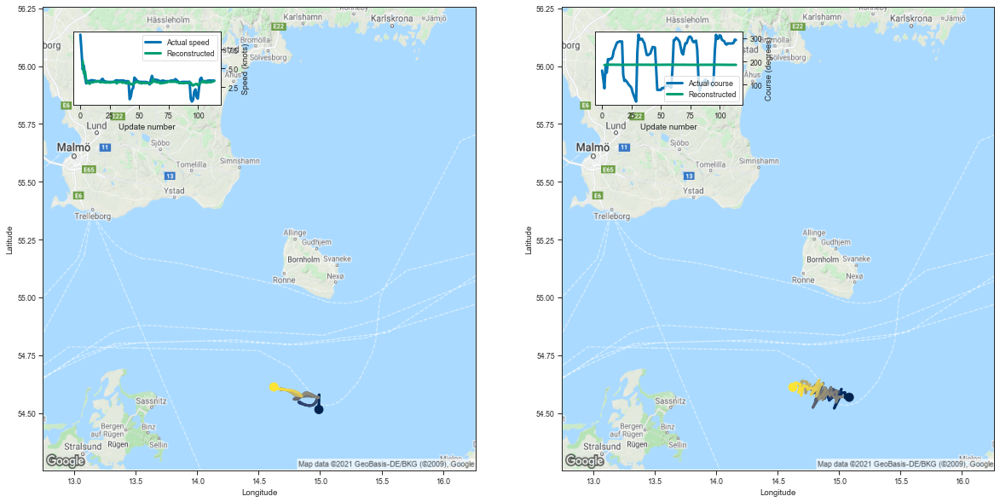

[5.995994567871094, 4.3322601318359375, 4.593459129333496, 3.3885533809661865]
tensor([ 54.6556,  15.7168,   3.5702, 199.7384])
tensor([6.5826e-02, 1.3457e-01, 1.2812e+00, 6.6048e+01])


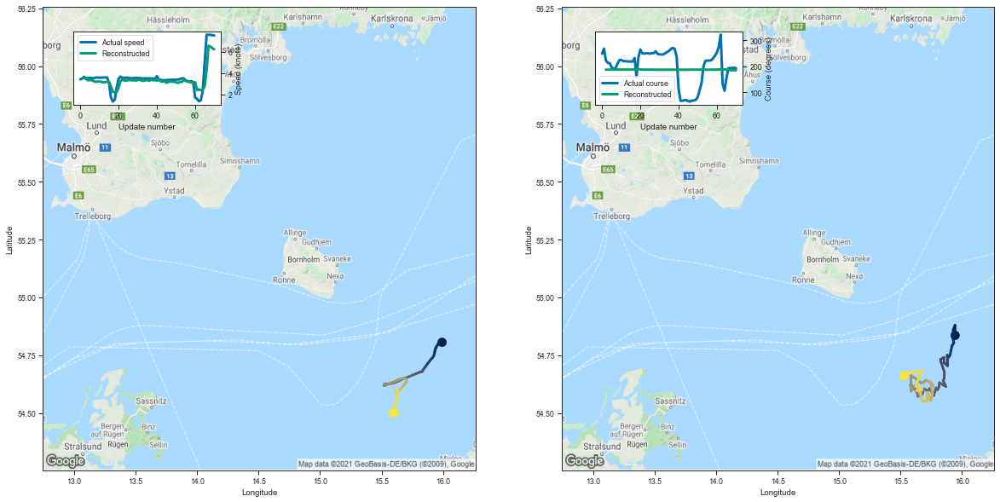

[3.5372252464294434, 3.5588133335113525, 3.3266704082489014, 3.3694112300872803]
tensor([ 54.5788,  15.1219,   3.3249, 152.6601])
tensor([2.4043e-02, 1.1564e-01, 1.1253e+00, 8.1189e+01])


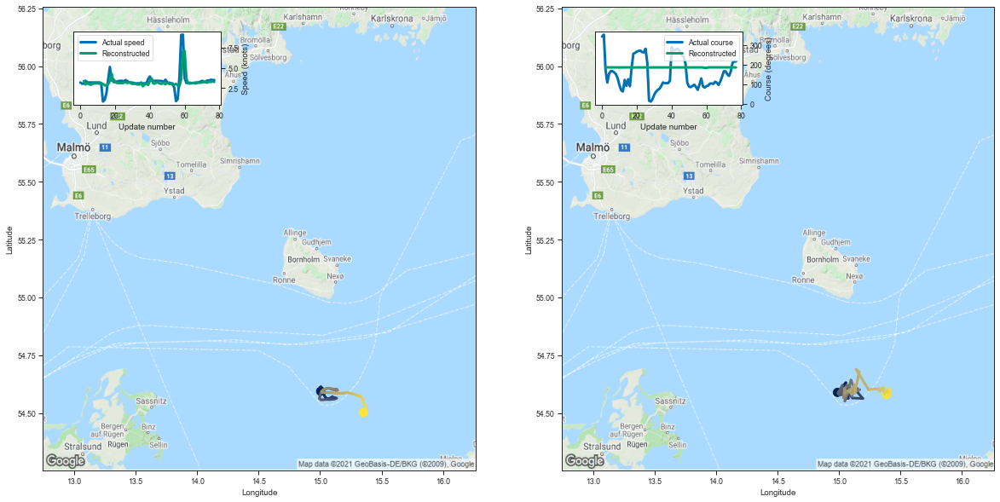

[3.3768372535705566, 2.9547691345214844, 3.1262989044189453, 2.9801177978515625]
tensor([5.5475e+01, 1.4287e+01, 2.8739e-04, 3.9025e+01])
tensor([1.6257e-05, 2.5641e-05, 1.0620e-03, 4.0781e+01])


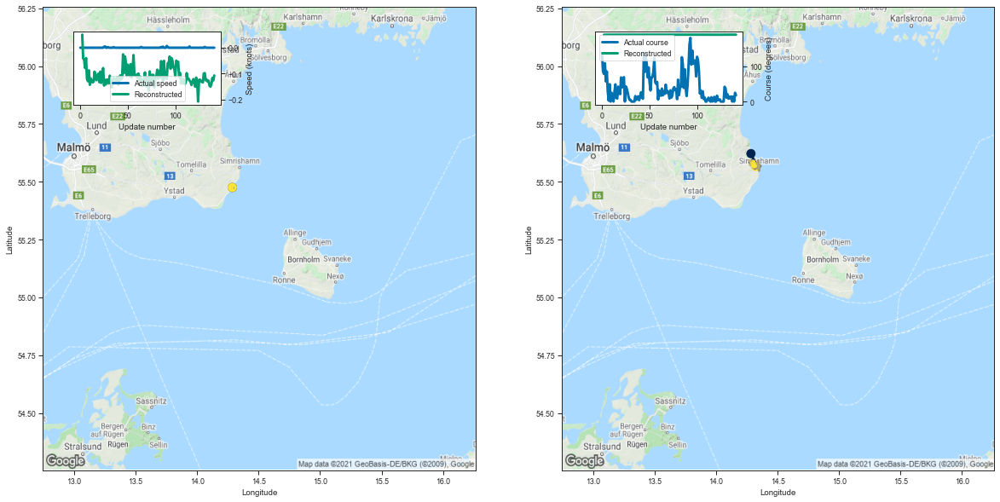

[0.050733089447021484, -0.04159832000732422, -0.04571390151977539, -0.07837820053100586]
tensor([ 54.5309,  15.7025,   2.9293, 197.9722])
tensor([1.5773e-02, 1.1134e-01, 4.3754e-01, 9.2426e+01])


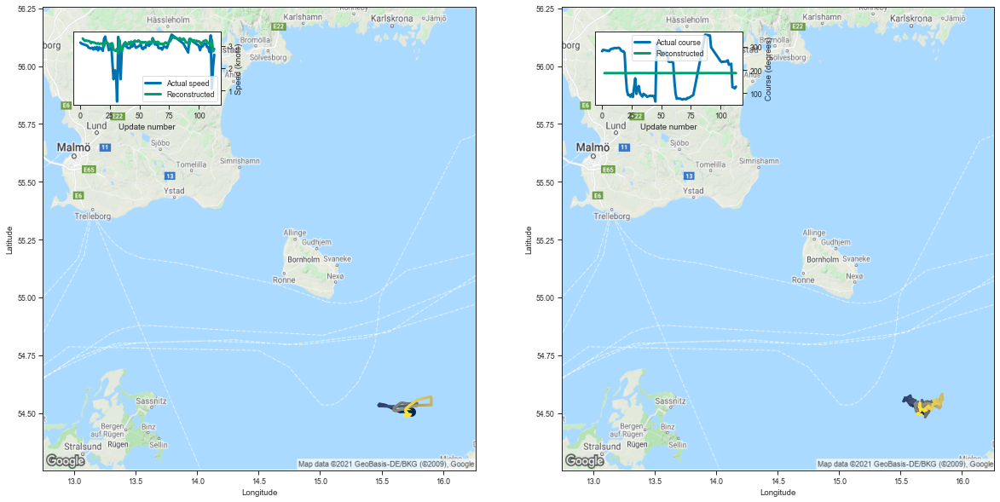

[3.3267996311187744, 3.2655587196350098, 3.2181167602539062, 3.233684539794922]
tensor([5.5474e+01, 1.4284e+01, 4.6832e-04, 3.7790e+01])
tensor([1.6172e-05, 2.6523e-05, 1.4045e-03, 4.1682e+01])


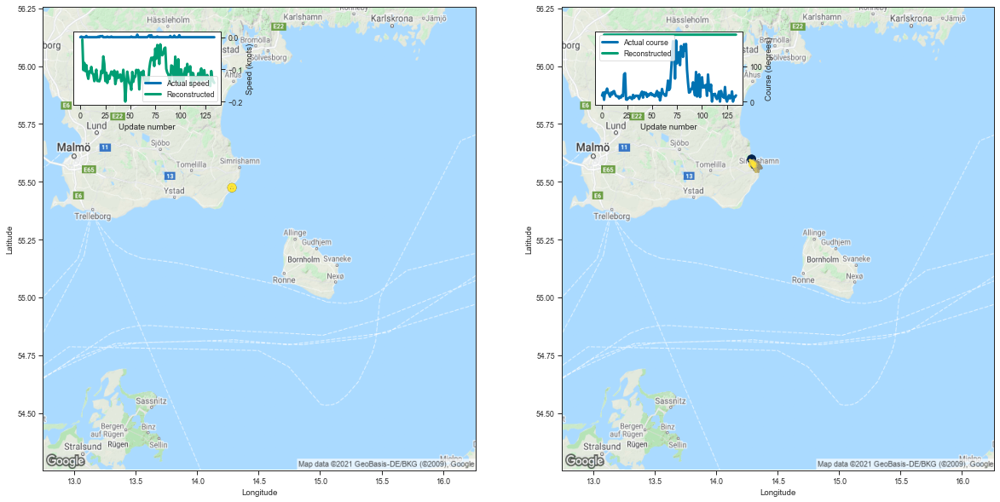

[-0.0072019100189208984, -0.10217618942260742, -0.07973647117614746, -0.10543966293334961]
tensor([ 54.6349,  15.1863,   3.4597, 172.1491])
tensor([8.6117e-02, 1.1242e-01, 1.5679e+00, 9.8197e+01])


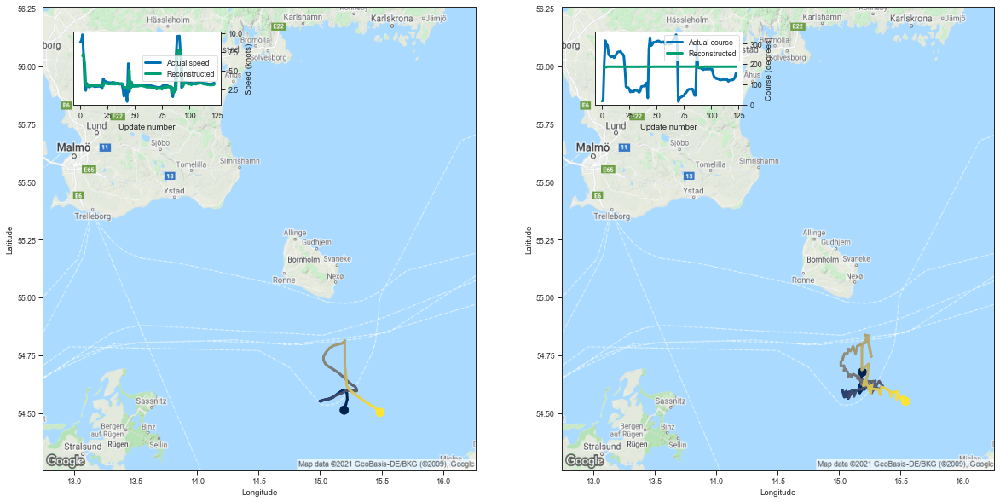

[6.965765476226807, 7.232797145843506, 5.973711013793945, 3.307734727859497]
tensor([ 54.8480,  15.9215,   2.6876, 147.4814])
tensor([2.8906e-02, 4.8531e-02, 4.6496e-01, 9.2423e+01])


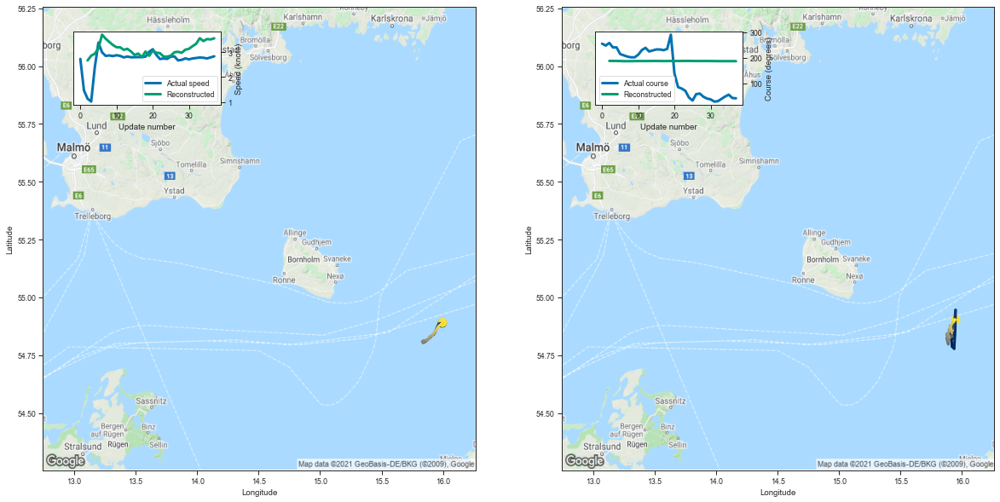

[2.665132761001587, 2.8567795753479004, 2.9352242946624756, 3.146618127822876]
tensor([ 54.5899,  14.8654,   3.6518, 196.4679])
tensor([3.7102e-02, 9.9761e-02, 1.4666e+00, 9.3164e+01])


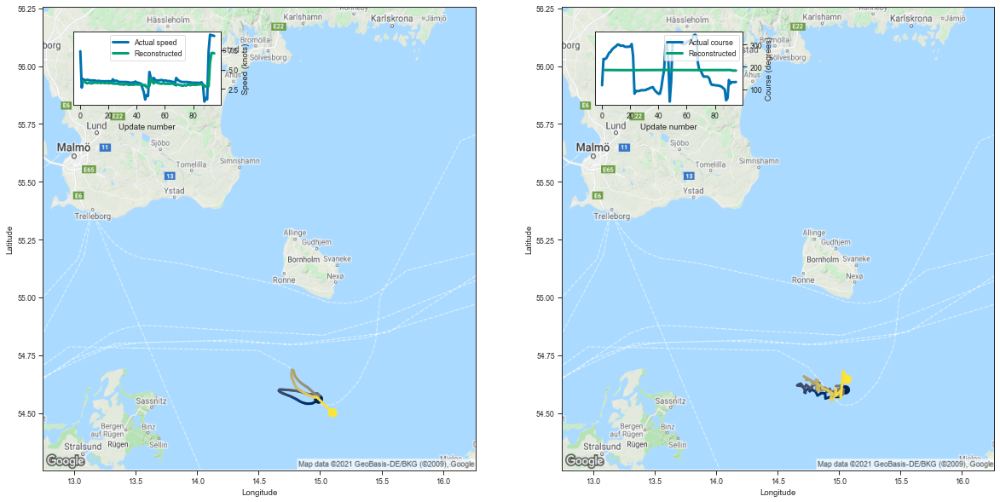

[3.481113910675049, 3.4558160305023193, 3.2822108268737793, 3.220412492752075]
tensor([ 54.6169,  14.7001,   3.0893, 168.0178])
tensor([4.9206e-02, 1.5303e-01, 1.0985e+00, 8.9441e+01])


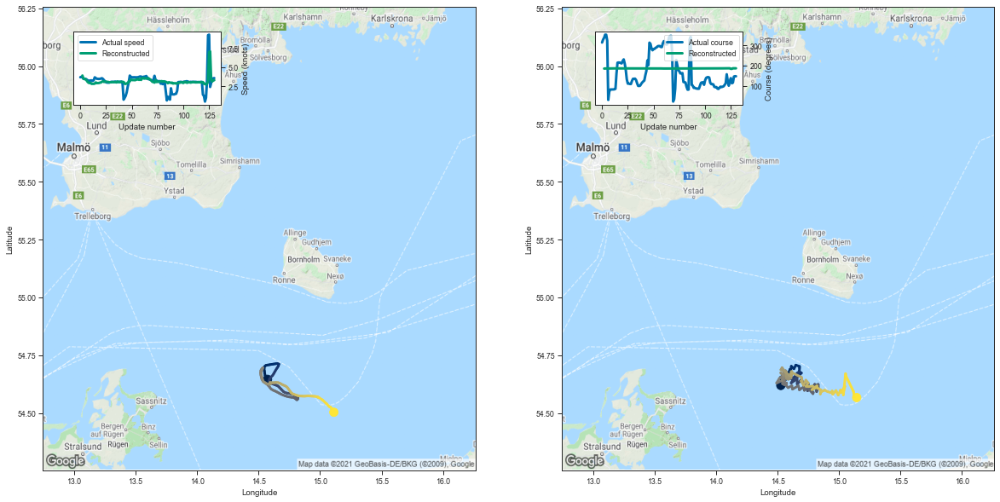

[3.9253718852996826, 3.5207724571228027, 3.461742401123047, 3.4547934532165527]
tensor([ 54.5156,  15.4035,   3.4143, 242.1089])
tensor([1.7504e-02, 5.2529e-02, 8.2131e-01, 7.1019e+01])


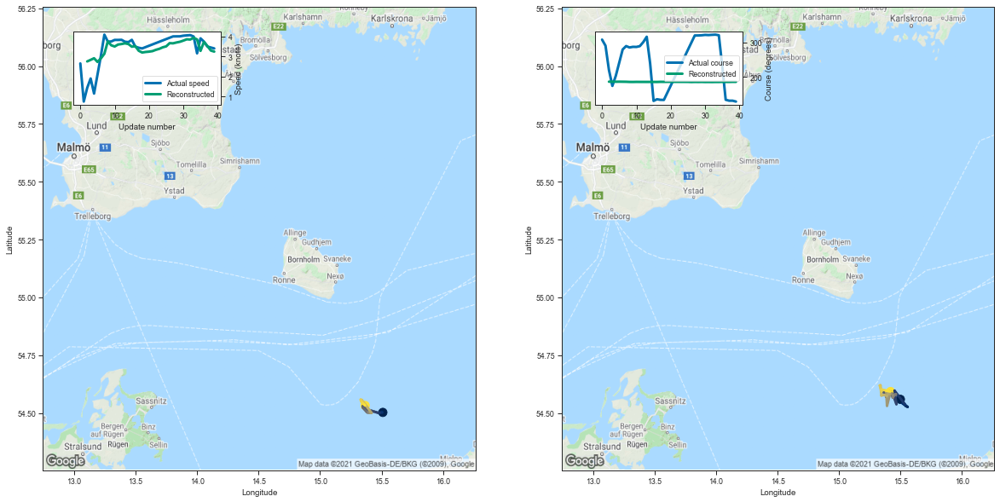

[2.7523488998413086, 2.829972267150879, 2.9102540016174316, 2.7285027503967285]
tensor([ 54.6231,  14.7660,   3.6441, 171.4926])
tensor([4.7994e-02, 1.3260e-01, 1.6446e+00, 9.5154e+01])


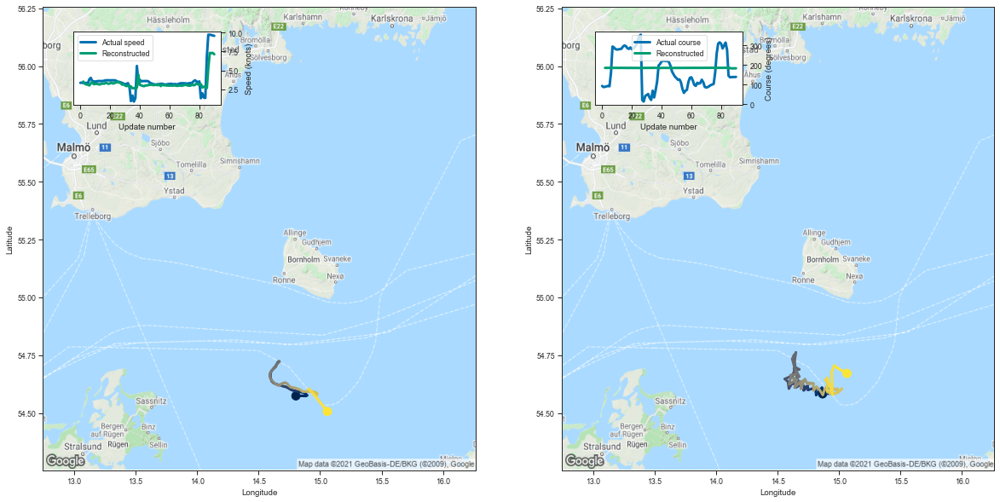

[3.534240484237671, 3.2523951530456543, 3.1461684703826904, 3.129802703857422]
tensor([ 54.5405,  15.4026,   4.0173, 183.0849])
tensor([2.3865e-02, 7.9811e-02, 1.8070e+00, 9.0586e+01])


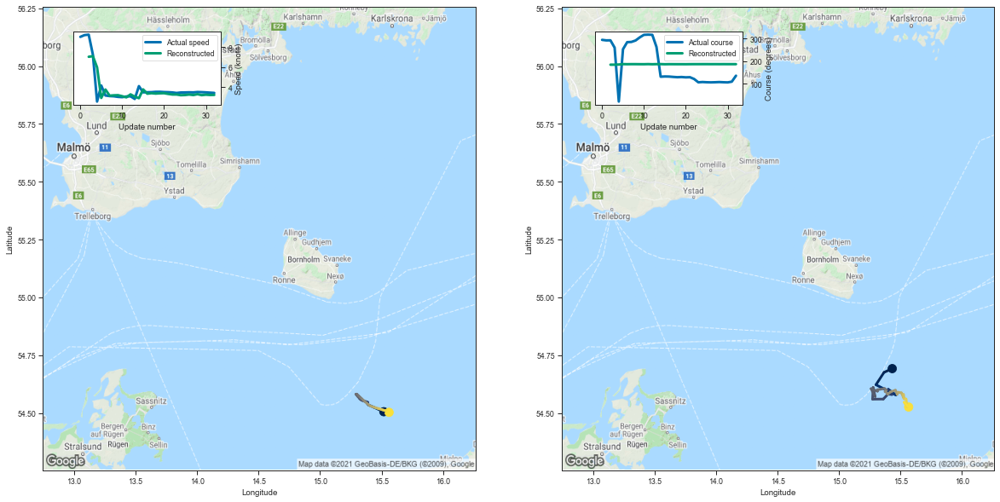

[7.029877185821533, 7.093588829040527, 5.97282600402832, 2.9249420166015625]
tensor([ 54.6266,  15.8528,   3.2936, 194.6656])
tensor([6.7985e-02, 6.0553e-02, 6.8257e-01, 1.1185e+02])


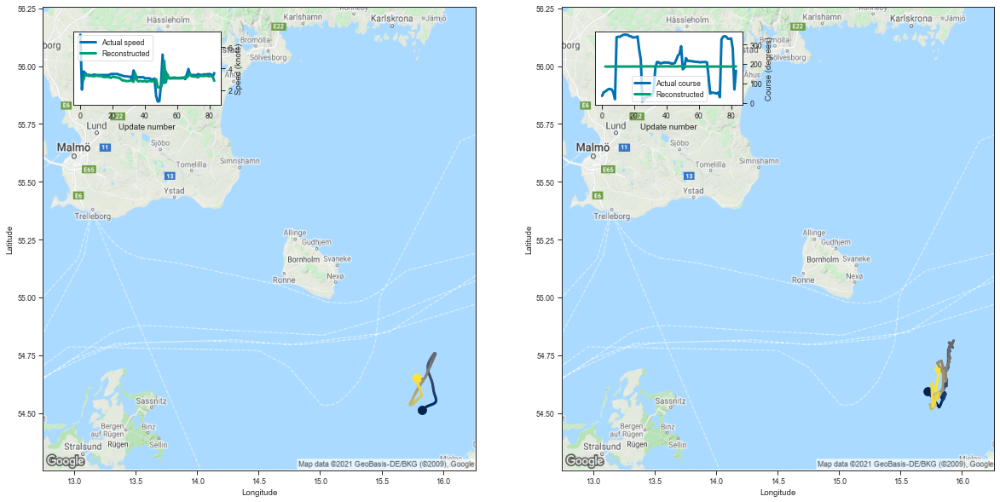

[2.9597718715667725, 3.46250057220459, 3.400264024734497, 3.310289144515991]
tensor([ 54.6506,  14.6312,   3.7394, 202.3567])
tensor([5.6697e-02, 7.9600e-02, 1.1624e+00, 9.5833e+01])


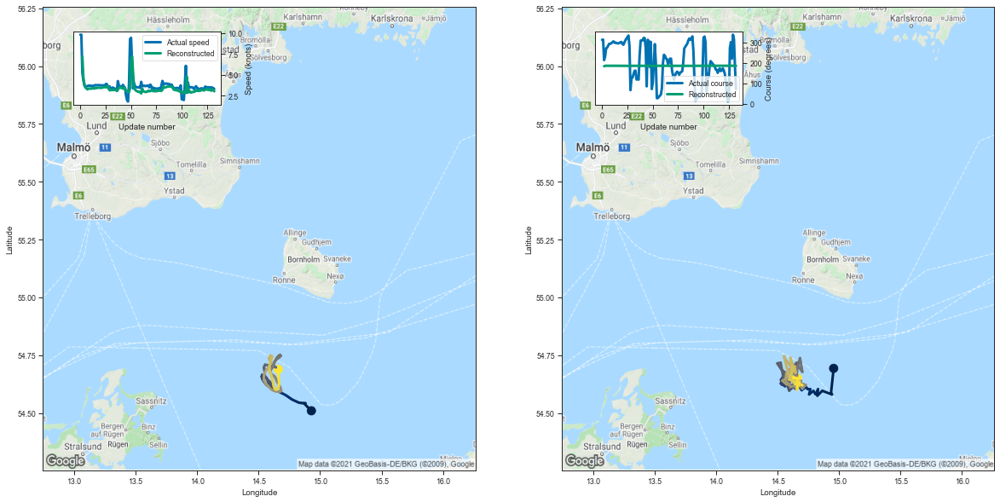

[7.169374942779541, 4.651823043823242, 3.8558082580566406, 3.4665634632110596]
tensor([ 54.6037,  14.8647,   3.4793, 199.1376])
tensor([6.9070e-02, 1.3090e-01, 2.0316e+00, 9.7160e+01])


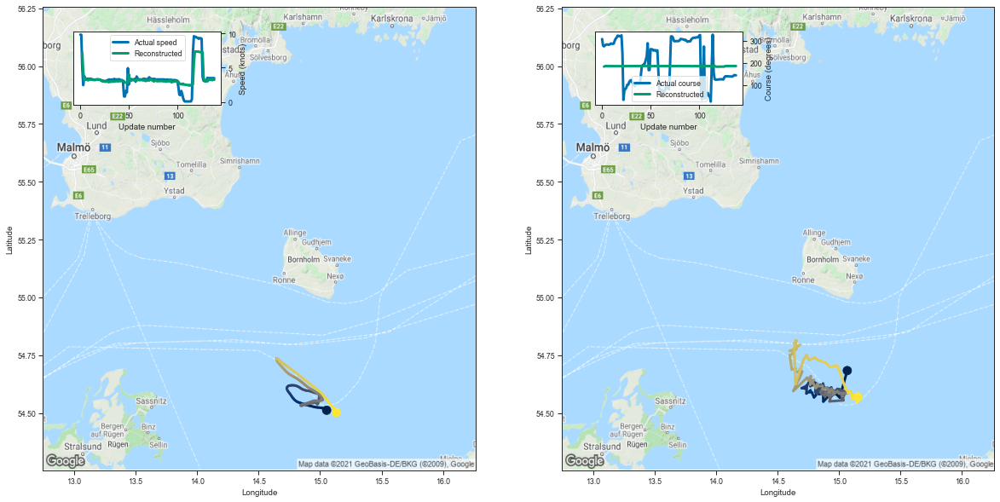

[7.1811203956604, 4.447331428527832, 3.2044906616210938, 3.4172701835632324]
tensor([ 55.0070,  15.2951,   4.3405, 210.0521])
tensor([ 0.1878,  0.2212,  3.6525, 40.4140])


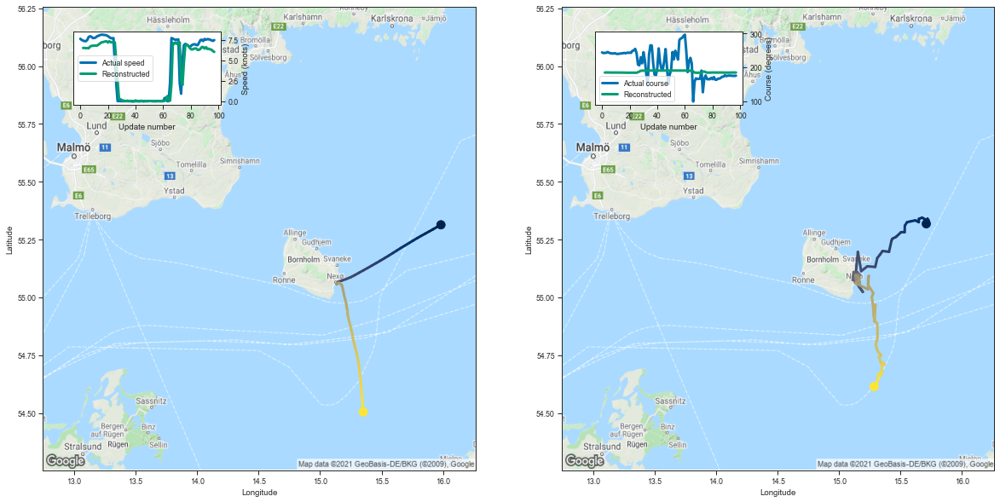

[6.530320644378662, 6.537263870239258, 6.502042293548584, 6.526272296905518]
tensor([ 54.7277,  15.8970,   2.8120, 103.6127])
tensor([1.0706e-01, 7.1343e-02, 5.0950e-01, 9.8767e+01])


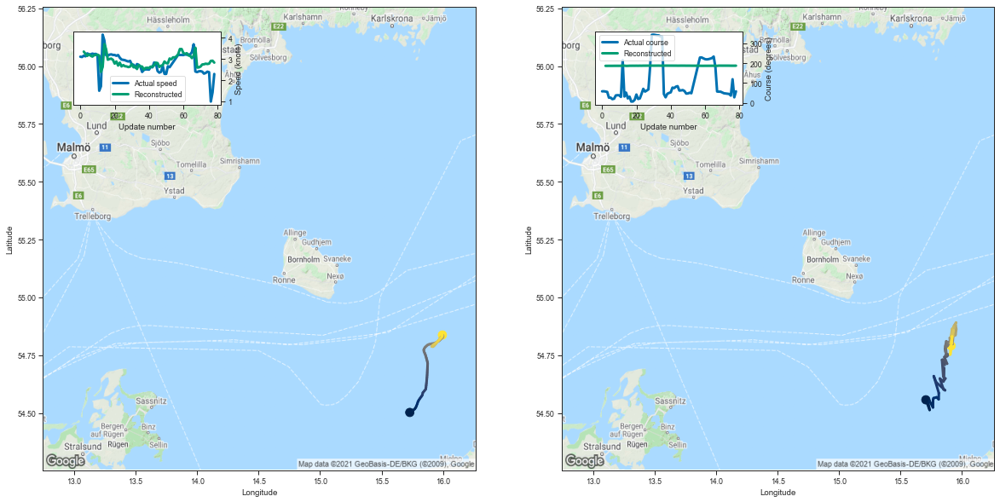

[3.352166175842285, 3.245086669921875, 3.1489663124084473, 3.2216503620147705]
tensor([ 55.0450,  14.2337,   2.8920, 133.4966])
tensor([7.8354e-02, 6.9059e-02, 4.0127e-01, 8.0035e+01])


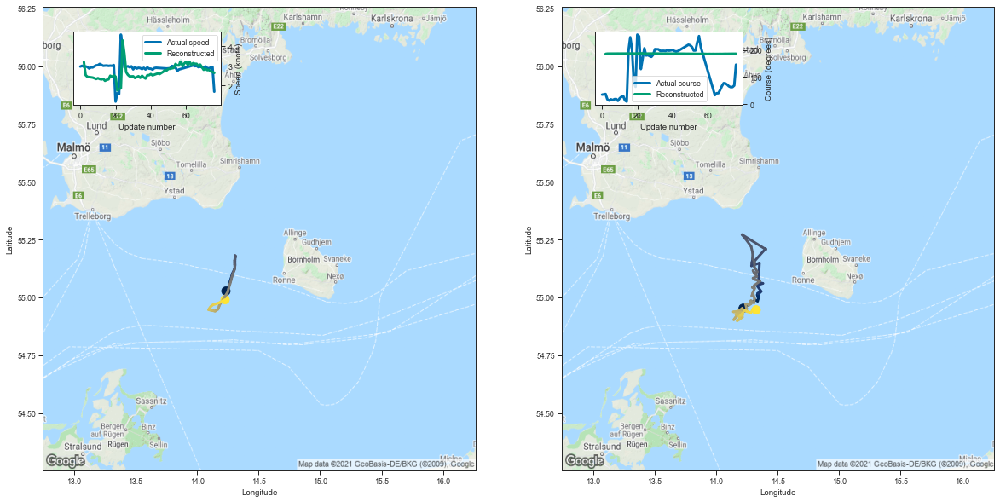

[3.2073745727539062, 2.530571699142456, 2.442852020263672, 2.427609443664551]
tensor([ 54.6108,  14.7776,   4.2768, 205.8998])
tensor([4.3023e-02, 1.4504e-01, 2.3614e+00, 9.3556e+01])


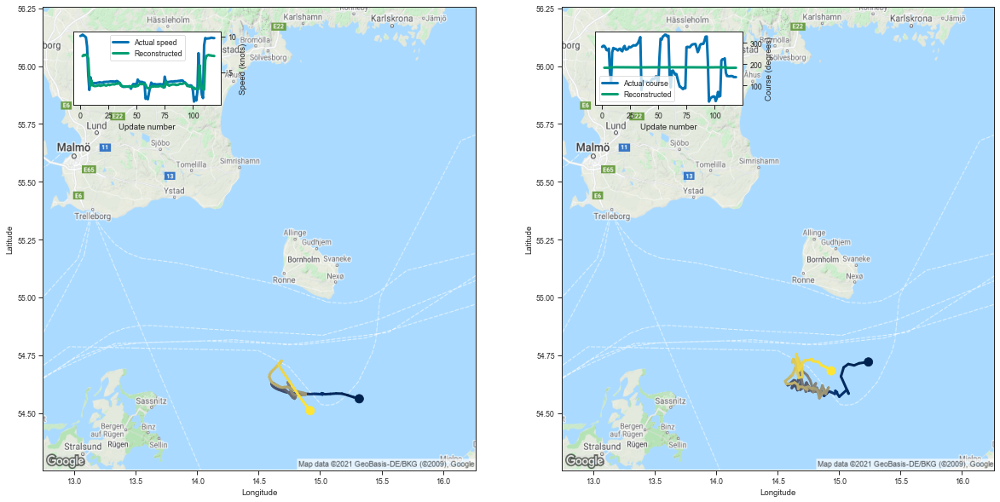

[7.2664265632629395, 7.442483425140381, 7.365407943725586, 7.472715854644775]
tensor([55.3914, 14.8278,  2.4722, 81.9462])
tensor([2.1798e-01, 1.0497e-02, 3.0777e+00, 8.1323e+01])


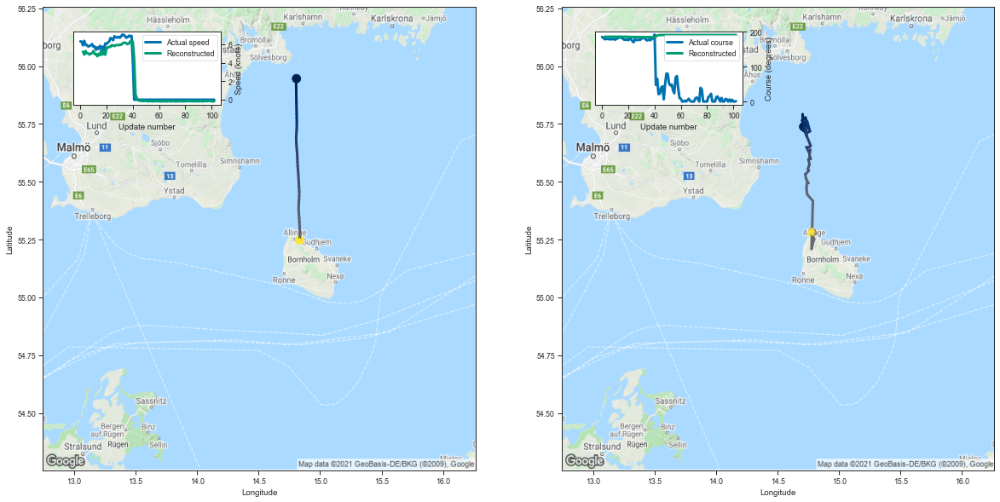

[5.193179130554199, 4.870766639709473, 5.26246452331543, 5.013092041015625]
tensor([5.5475e+01, 1.4286e+01, 5.0982e-04, 8.3702e+00])
tensor([1.2479e-05, 2.0550e-05, 1.4654e-03, 9.7422e+00])


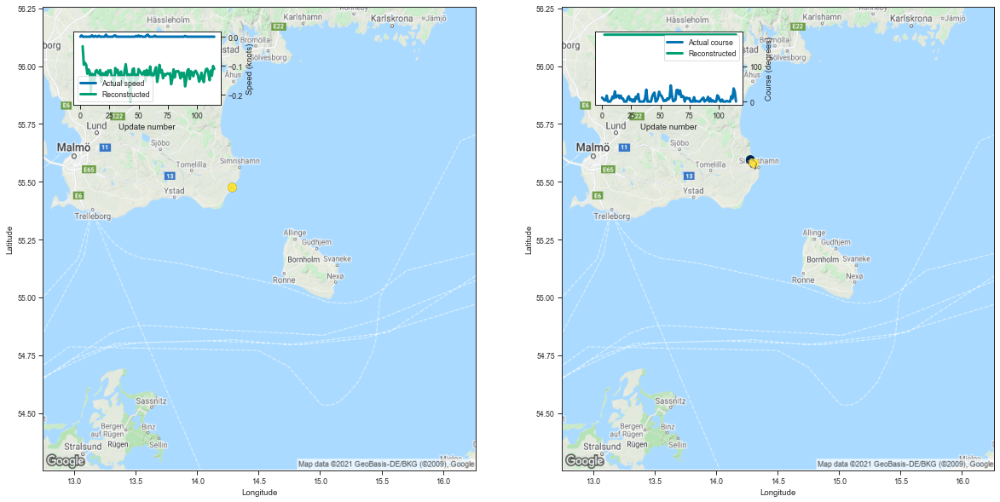

[-0.032823801040649414, -0.09647393226623535, -0.0901937484741211, -0.09628868103027344]
tensor([ 54.6432,  14.6742,   4.0355, 216.7645])
tensor([4.2424e-02, 1.2553e-01, 2.0566e+00, 1.0536e+02])


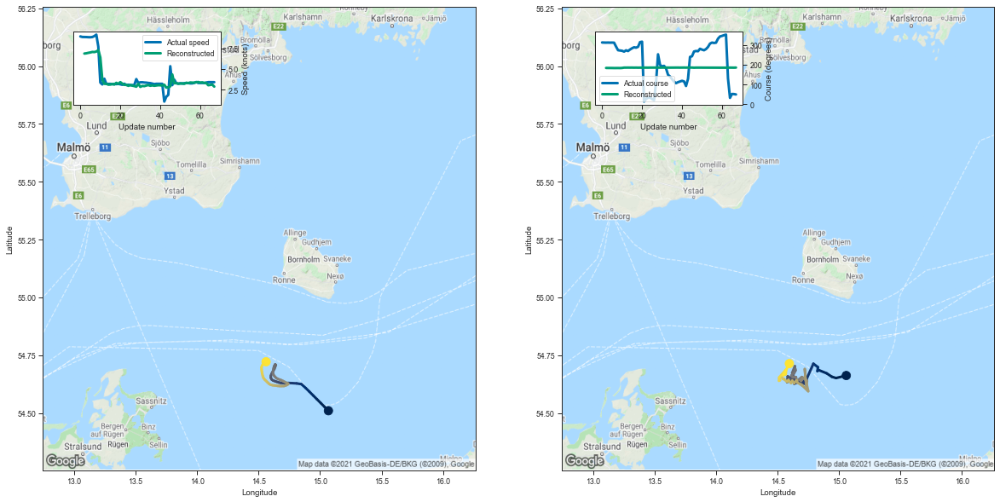

[6.872920513153076, 6.904111385345459, 6.961126804351807, 7.004952907562256]
tensor([ 54.9090,  15.3340,   3.0540, 192.6557])
tensor([4.5768e-02, 9.7004e-02, 2.1373e+00, 9.2828e+01])


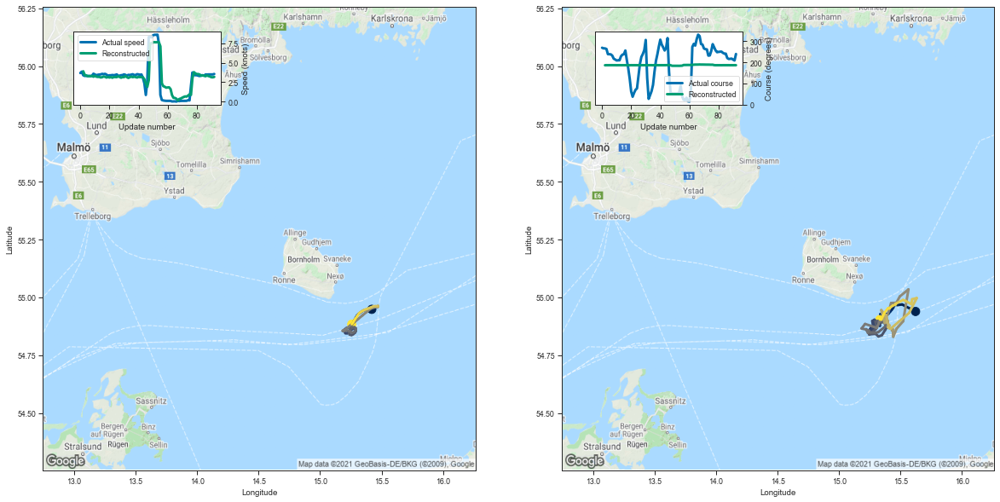

[3.905334711074829, 3.4076781272888184, 3.381654977798462, 3.2771143913269043]
tensor([54.7156, 15.5150,  3.8570, 99.4534])
tensor([5.9277e-02, 3.0496e-01, 2.1826e+00, 7.2492e+01])


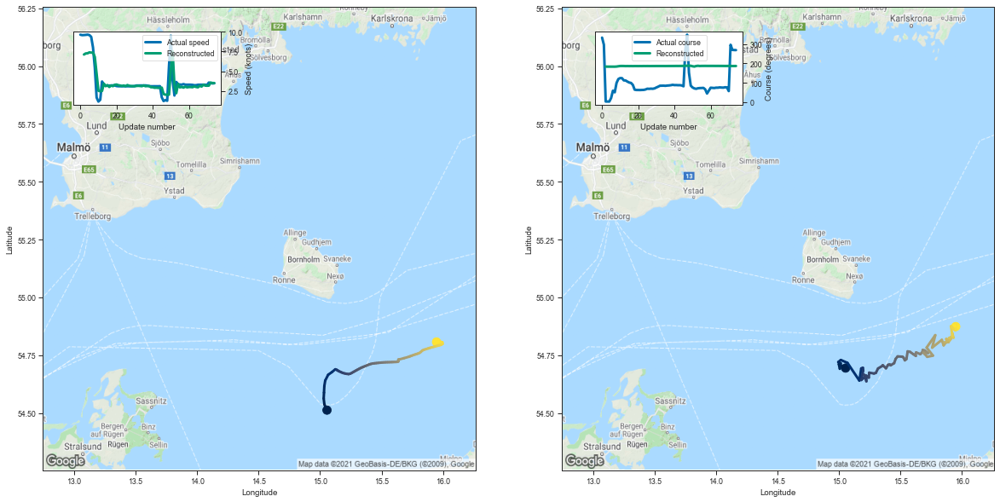

[7.121152400970459, 7.258317947387695, 7.278939247131348, 7.393499374389648]
tensor([ 55.0434,  14.2720,   4.0373, 184.3700])
tensor([1.7329e-01, 4.6100e-02, 2.4556e+00, 9.3941e+01])


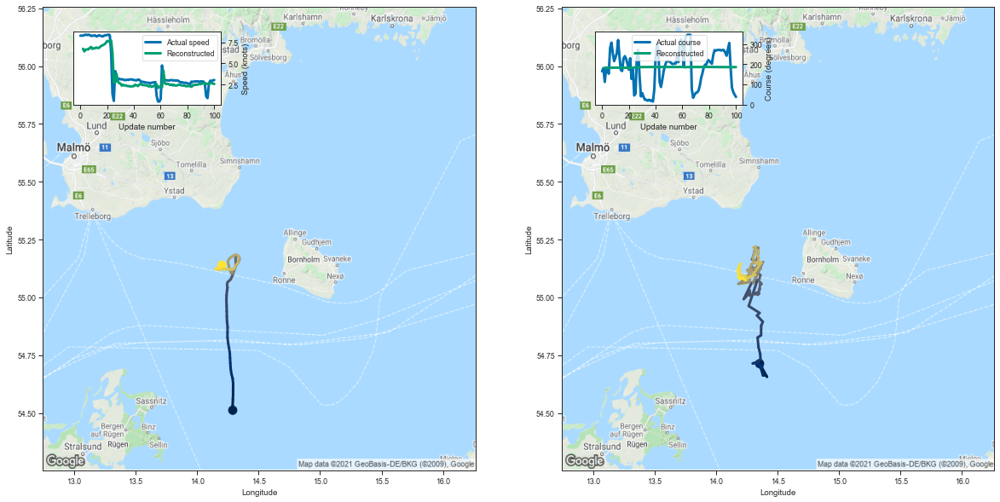

[6.752833843231201, 6.442940711975098, 6.640263080596924, 6.6843647956848145]
tensor([55.4569, 14.3049,  1.1207, 75.7815])
tensor([4.1534e-02, 5.0978e-02, 2.3808e+00, 8.9056e+01])


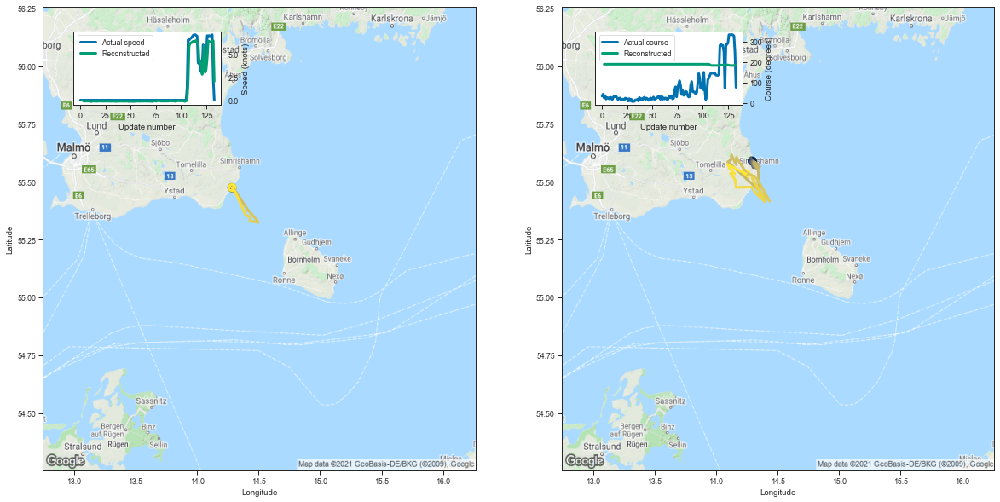

[0.0004916191101074219, -0.08219242095947266, -0.11900782585144043, -0.10191988945007324]
tensor([ 55.0256,  14.6509,   4.8115, 161.4231])
tensor([ 0.1903,  0.5789,  2.4951, 82.2035])


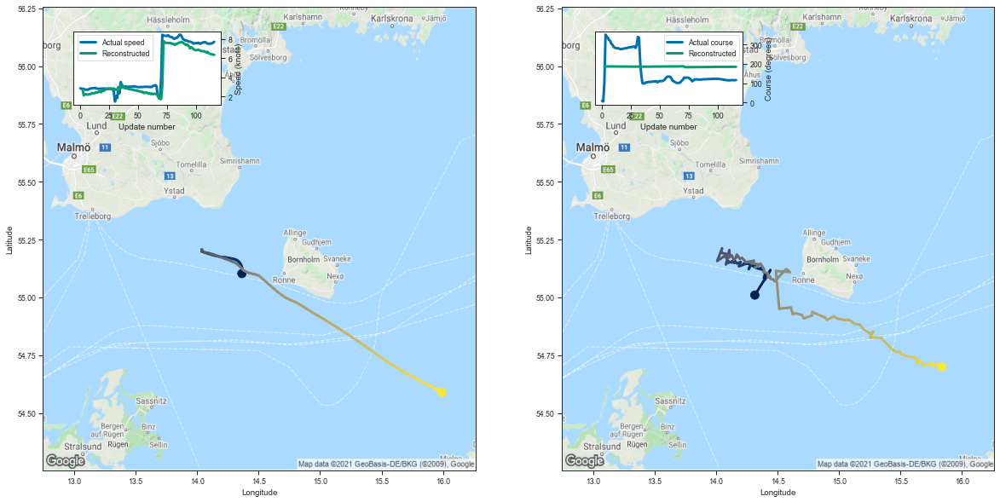

[2.6947097778320312, 2.1038670539855957, 2.239046096801758, 2.2284271717071533]
tensor([ 54.7700,  15.5150,   3.3195, 200.1076])
tensor([7.3519e-02, 1.8496e-01, 1.9787e+00, 9.9299e+01])


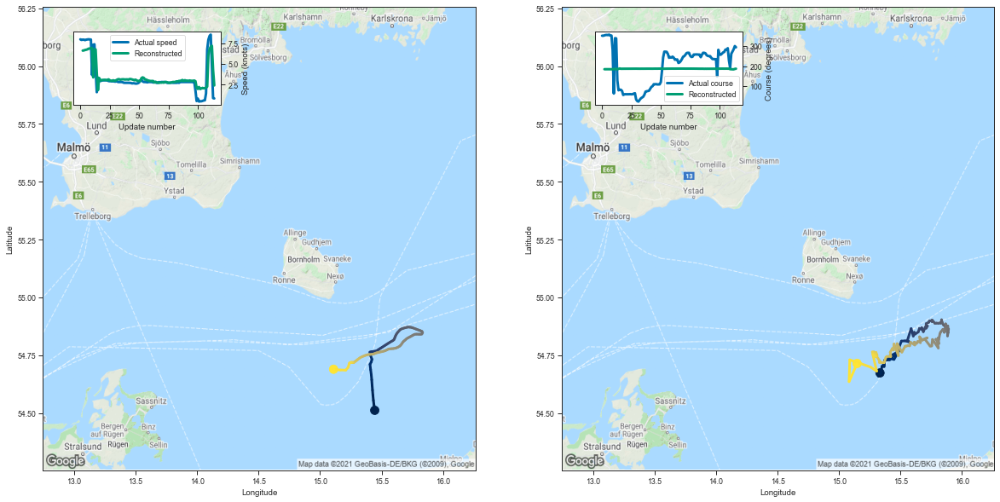

[6.623275279998779, 6.6471781730651855, 6.697681903839111, 6.729706764221191]
tensor([ 55.2701,  15.4133,   2.6976, 106.5418])
tensor([5.1845e-02, 1.4631e-01, 3.3363e+00, 6.7836e+01])


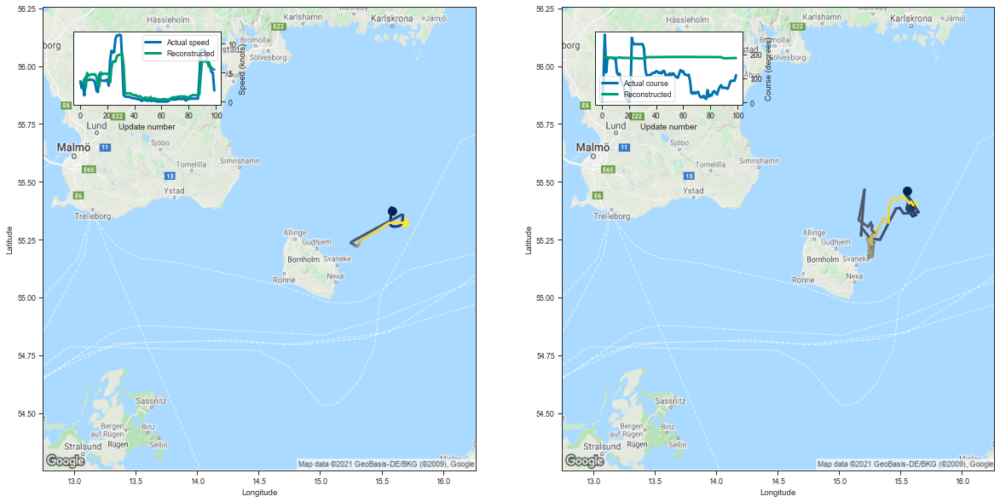

[3.3313732147216797, 3.919924020767212, 2.359609365463257, 4.943290710449219]
tensor([ 54.7506,  14.4024,   4.7761, 204.9898])
tensor([ 0.1356,  0.3446,  2.7988, 92.0934])


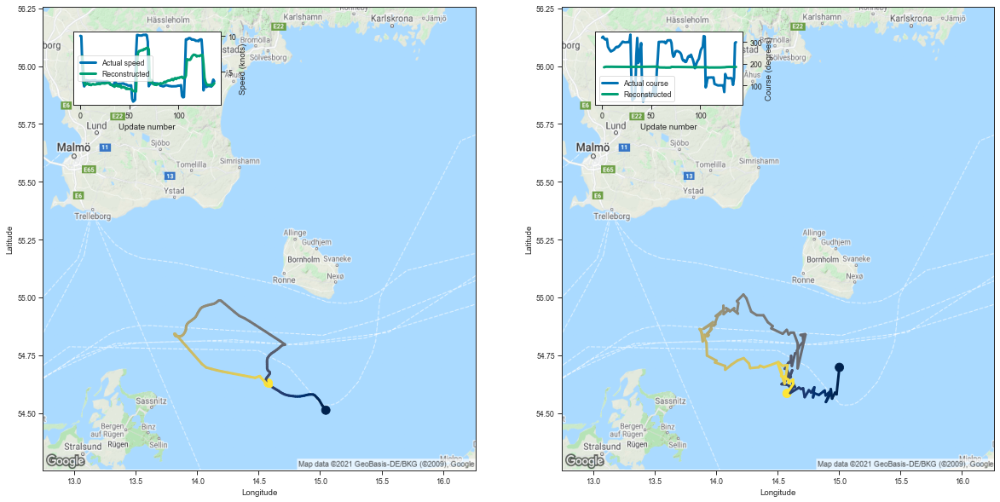

[7.214179992675781, 5.203039169311523, 3.503847599029541, 3.170742988586426]
tensor([ 54.9848,  14.0801,   4.6737, 138.0498])
tensor([ 0.1887,  0.2220,  2.2818, 47.8752])


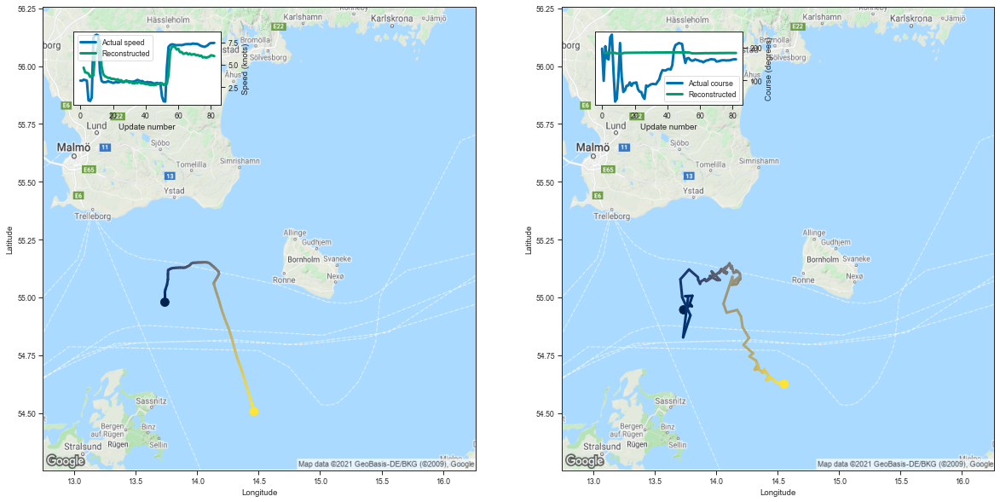

[4.667452812194824, 4.134478569030762, 4.104152679443359, 3.9991798400878906]
tensor([ 54.8350,  14.6584,   6.5010, 233.8385])
tensor([ 0.1116,  0.3241,  0.4561, 25.0698])


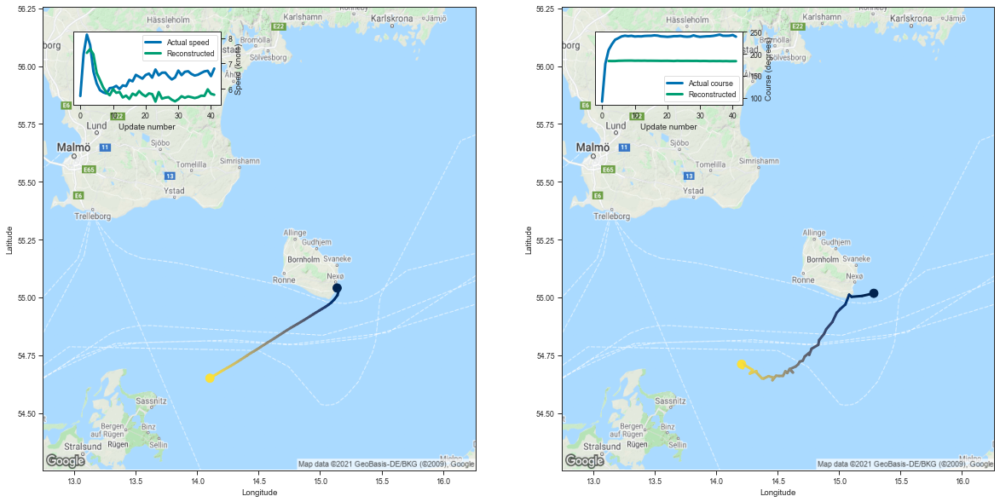

[7.417473316192627, 7.570500373840332, 7.359359264373779, 6.627944469451904]
tensor([ 55.0345,  14.2468,   4.6304, 175.4529])
tensor([ 0.1755,  0.3135,  2.4326, 96.9248])


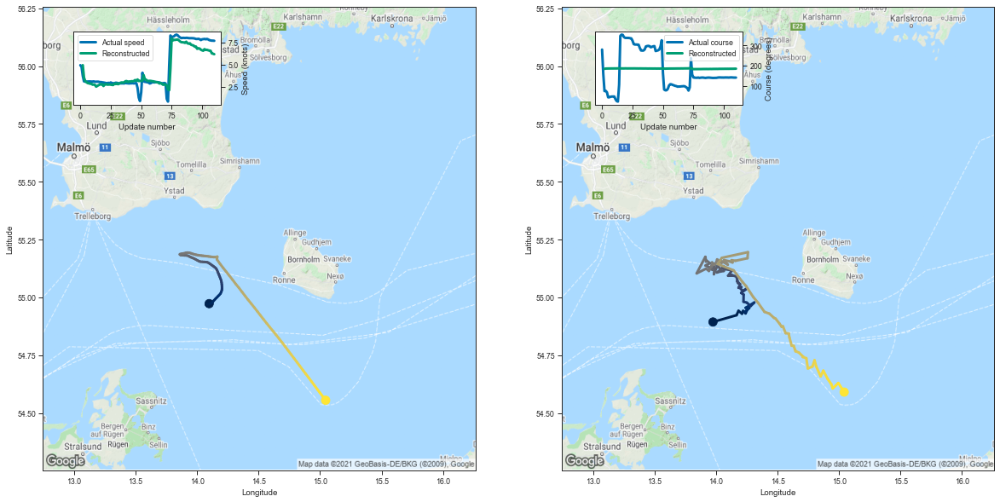

[4.946446418762207, 3.5467939376831055, 3.1504297256469727, 3.037060260772705]
tensor([ 54.9702,  14.1159,   4.2715, 159.1799])
tensor([ 0.1634,  0.1247,  2.4288, 90.7266])


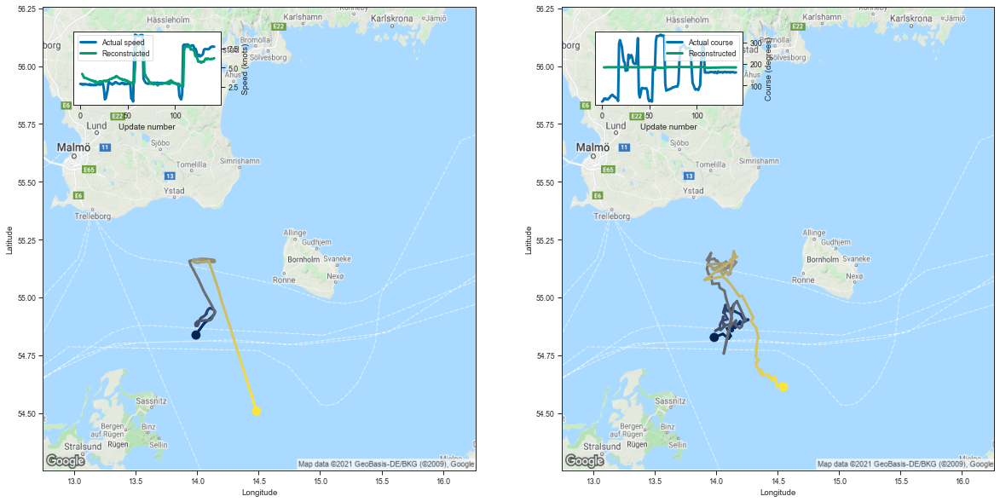

[4.173677444458008, 3.912764549255371, 3.6727499961853027, 3.6555368900299072]
tensor([ 54.7175,  15.6898,   8.0088, 241.6436])
tensor([ 0.1447,  0.2330,  0.3084, 29.6051])


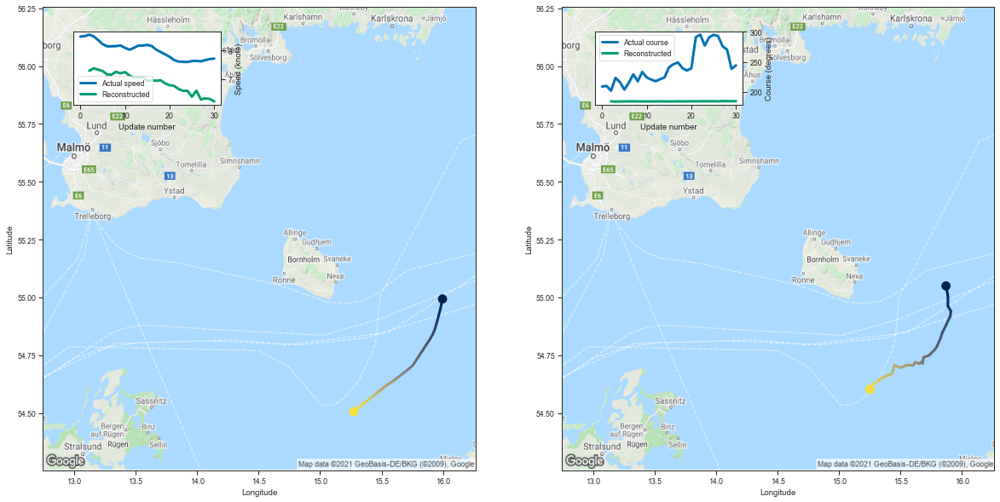

[7.2847771644592285, 7.373791217803955, 7.324934005737305, 7.277506351470947]
tensor([54.5840, 15.0395,  6.5143, 84.4169])
tensor([0.0214, 0.3328, 2.1800, 4.9454])


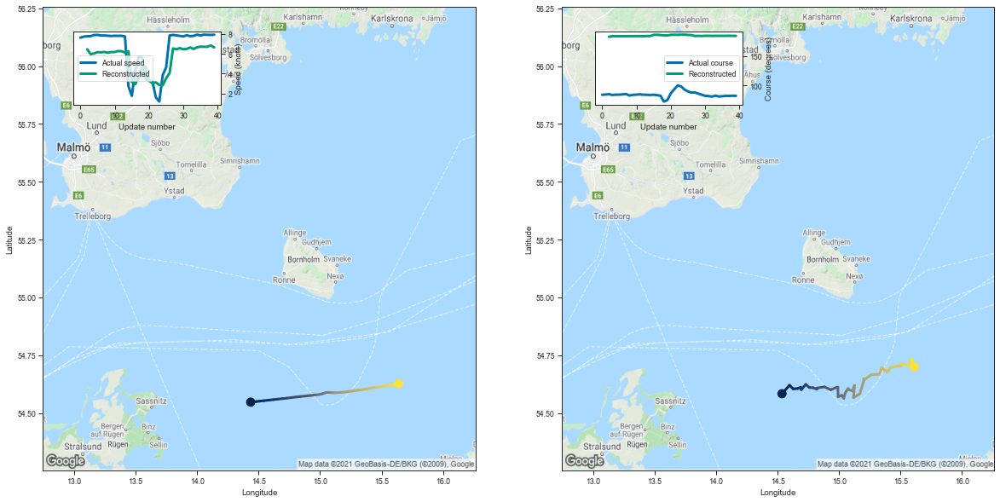

[6.455163478851318, 5.961124420166016, 6.029585361480713, 6.162163734436035]
tensor([ 55.0139,  15.6793,   8.2738, 188.3406])
tensor([0.2941, 0.0674, 0.1854, 7.9044])


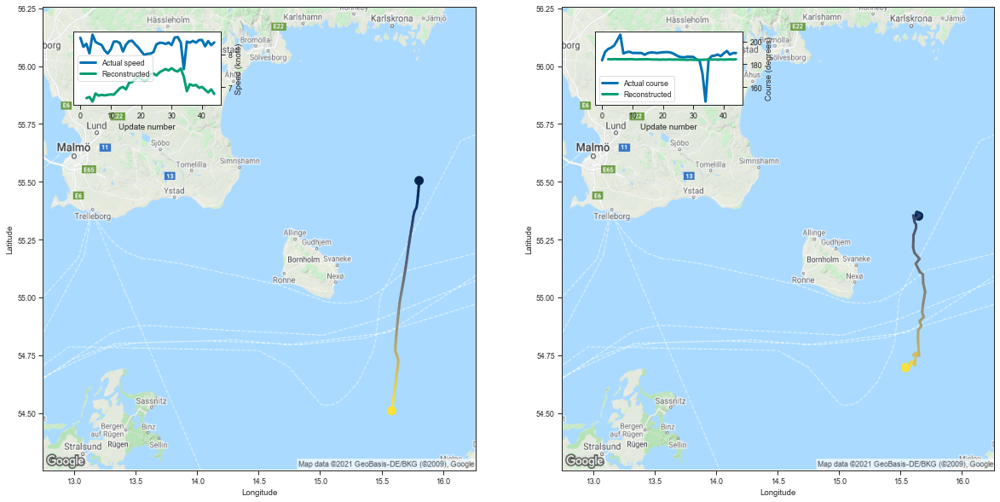

[6.6742119789123535, 6.707640647888184, 6.56959867477417, 6.814250946044922]
tensor([ 55.1384,  15.1339,   5.9315, 205.8530])
tensor([ 0.1795,  0.3024,  3.7473, 94.7789])


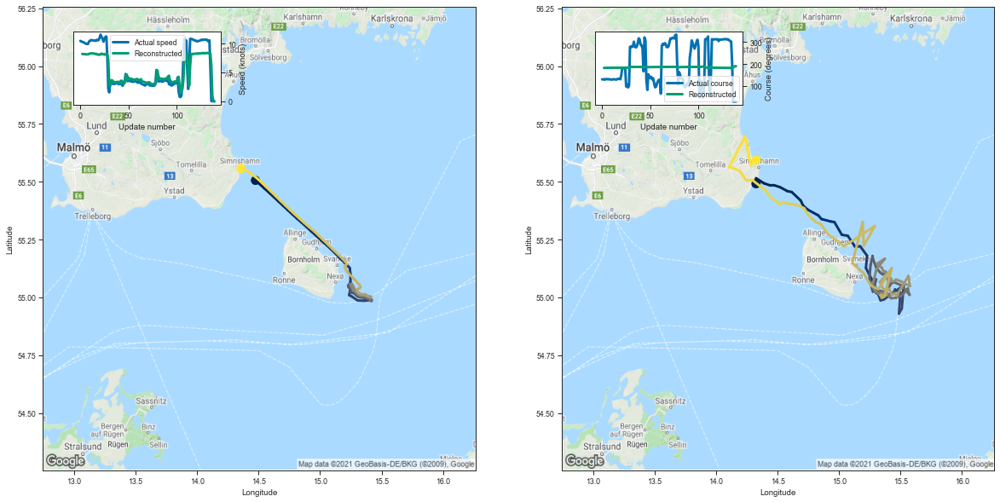

[8.213178634643555, 8.180326461791992, 8.187387466430664, 8.18234634399414]
tensor([ 54.6228,  14.4320,   2.8636, 187.9680])
tensor([ 0.1343,  0.1215,  2.4741, 88.0578])


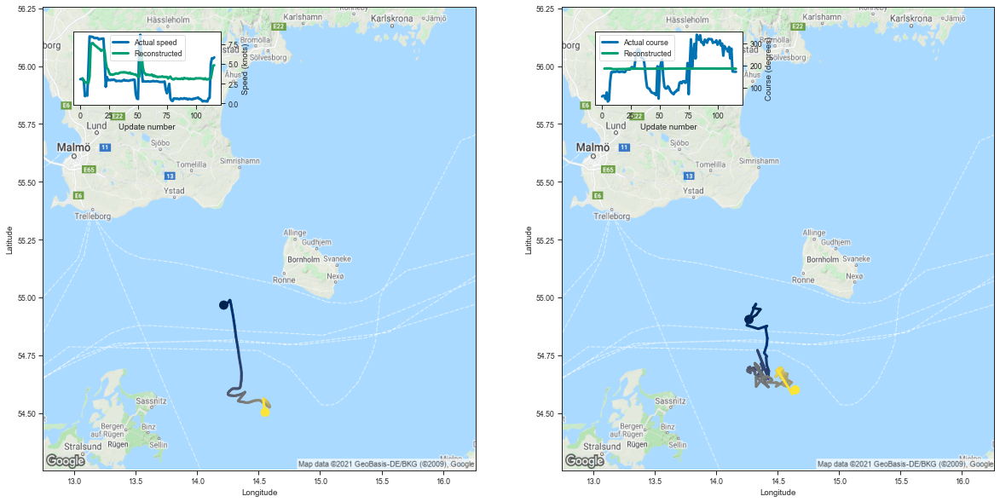

[3.1797776222229004, 2.7894210815429688, 2.6240930557250977, 2.652167797088623]
tensor([ 55.7786,  14.8128,   4.0571, 183.7157])
tensor([7.5637e-02, 7.9189e-02, 2.5908e+00, 1.0101e+02])


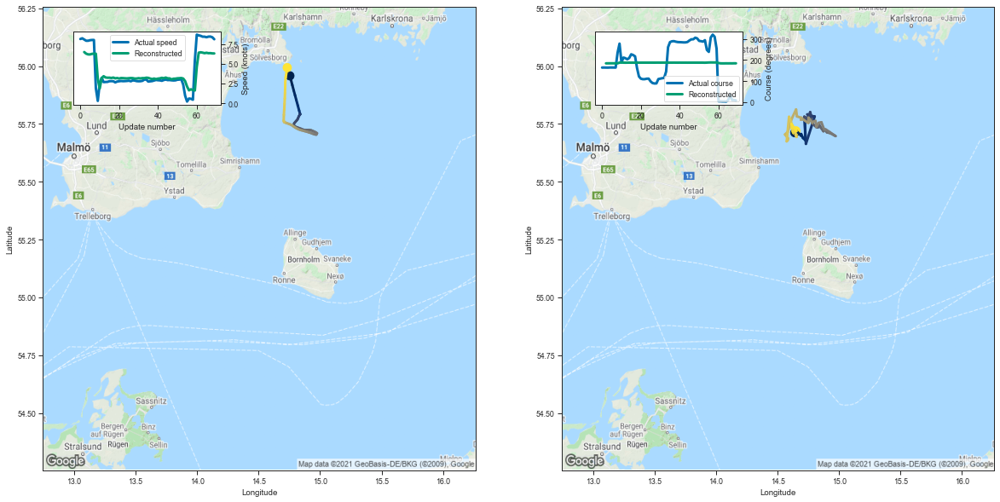

[6.474297046661377, 6.269779682159424, 6.178565502166748, 6.170711040496826]
tensor([ 54.7909,  14.3002,   1.8502, 231.2415])
tensor([2.0574e-02, 1.5260e-02, 1.2726e+00, 1.1163e+02])


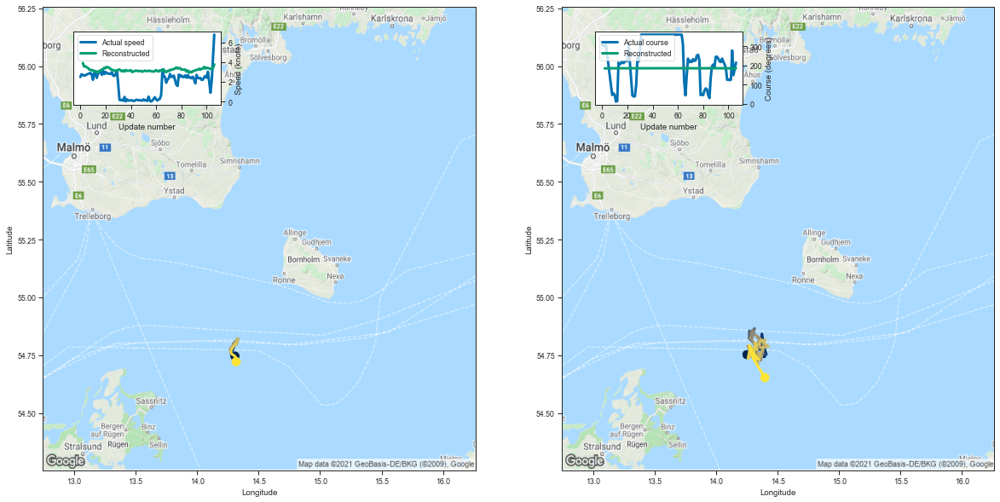

[3.9141314029693604, 3.5582377910614014, 3.570866107940674, 3.4895548820495605]
tensor([ 55.7250,  14.4838,   4.4779, 170.7435])
tensor([8.9252e-02, 9.0088e-02, 2.8236e+00, 1.0366e+02])


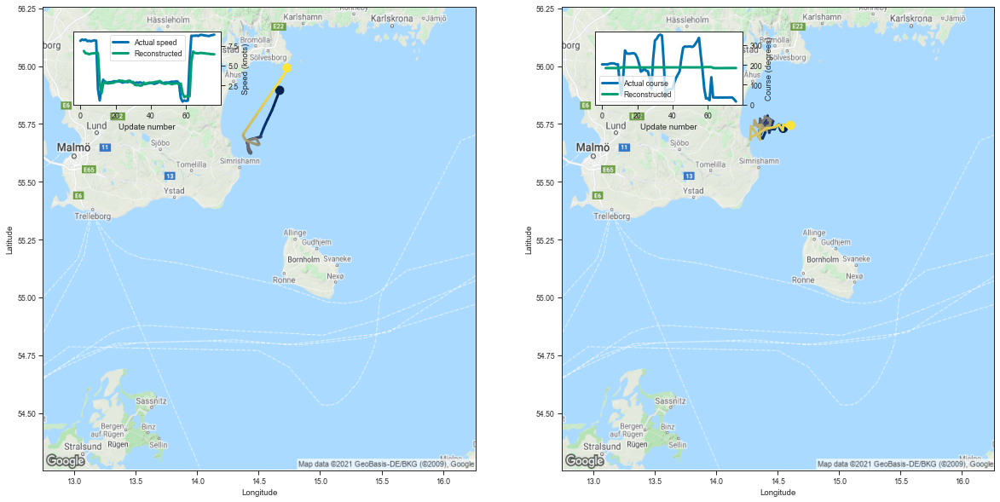

[6.821767330169678, 6.530184745788574, 6.51179838180542, 6.419763088226318]
tensor([ 55.7830,  14.6952,   3.8945, 125.4730])
tensor([4.2502e-02, 4.3838e-02, 2.6684e+00, 8.4231e+01])


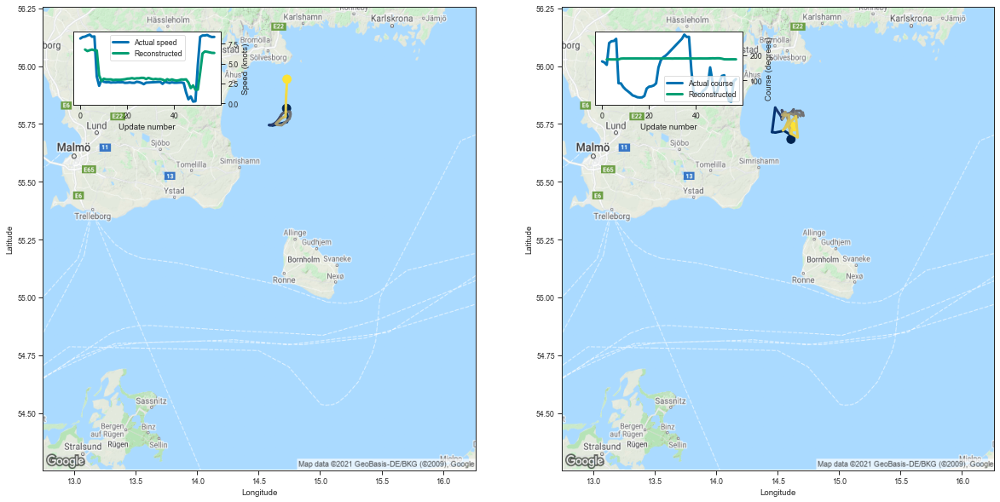

[6.76814603805542, 6.579276084899902, 6.683923244476318, 6.764939785003662]
tensor([ 55.5404,  14.3742,   1.1233, 223.6588])
tensor([3.7393e-02, 3.6132e-02, 2.5316e+00, 4.8937e+01])


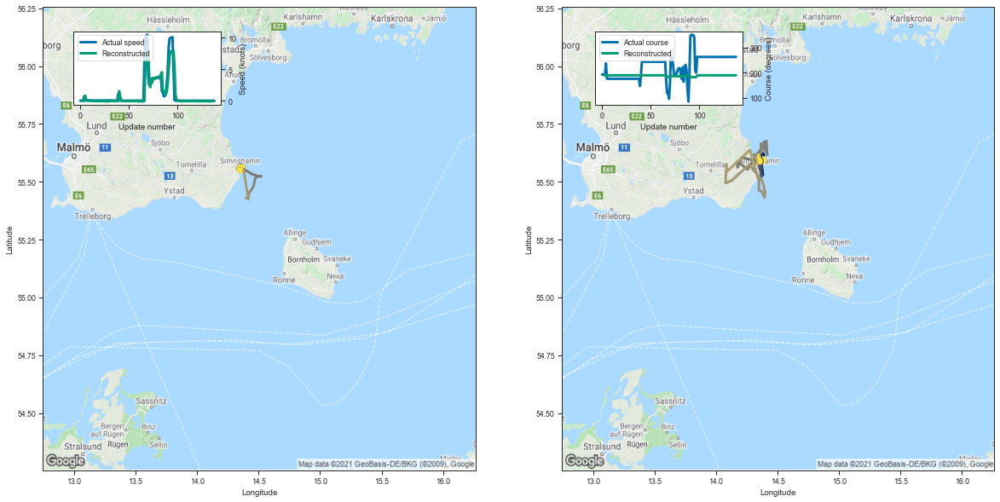

[0.01382756233215332, -0.04253673553466797, -0.06647396087646484, 0.8126987218856812]
tensor([ 55.5391,  15.3888,   3.4875, 154.0479])
tensor([2.1766e-01, 1.0619e-01, 2.6251e+00, 1.1308e+02])


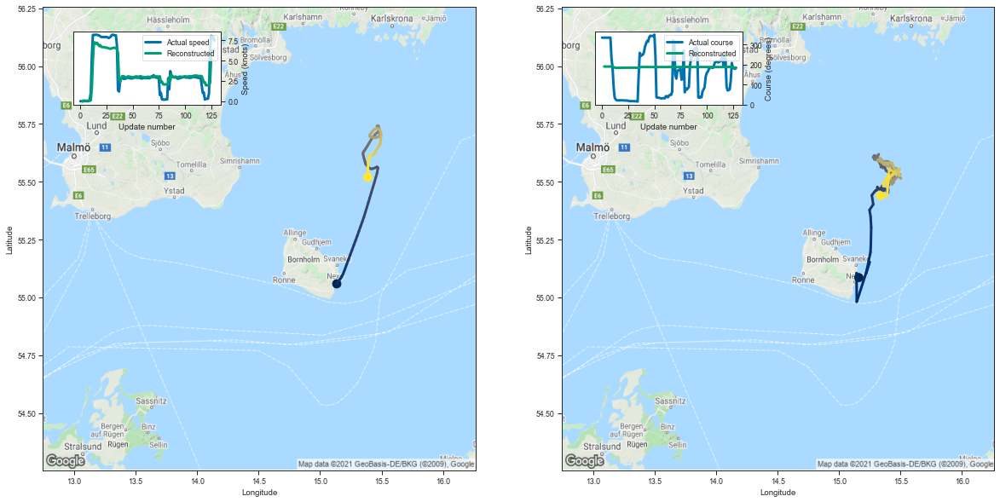

[-0.050694942474365234, 0.07871079444885254, 0.06638765335083008, 0.03873562812805176]
tensor([ 55.8048,  14.7338,   3.5355, 162.3871])
tensor([5.1126e-02, 4.8419e-02, 2.4416e+00, 9.9499e+01])


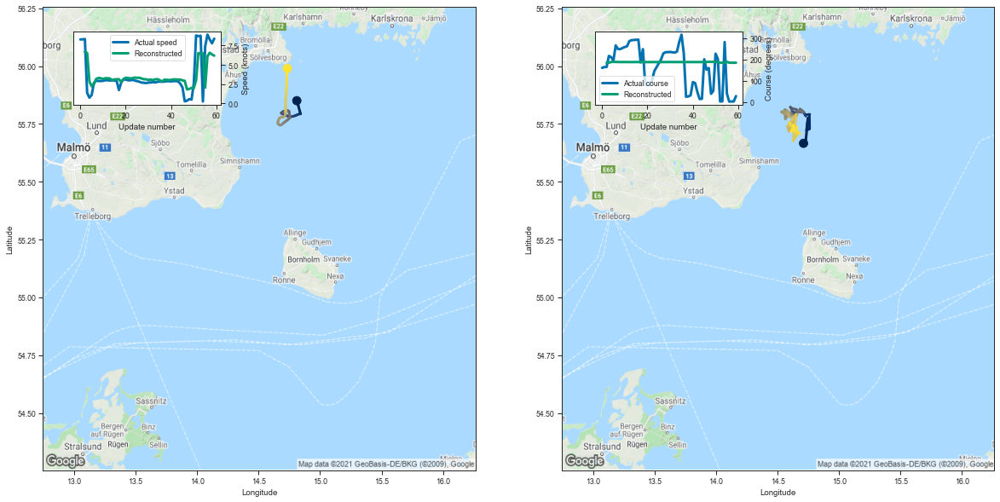

[6.687817573547363, 6.533350467681885, 2.836514472961426, 2.2181572914123535]
tensor([ 54.6864,  13.8221,   3.7197, 159.5659])
tensor([4.6757e-02, 6.2694e-02, 1.2754e+00, 8.6383e+01])


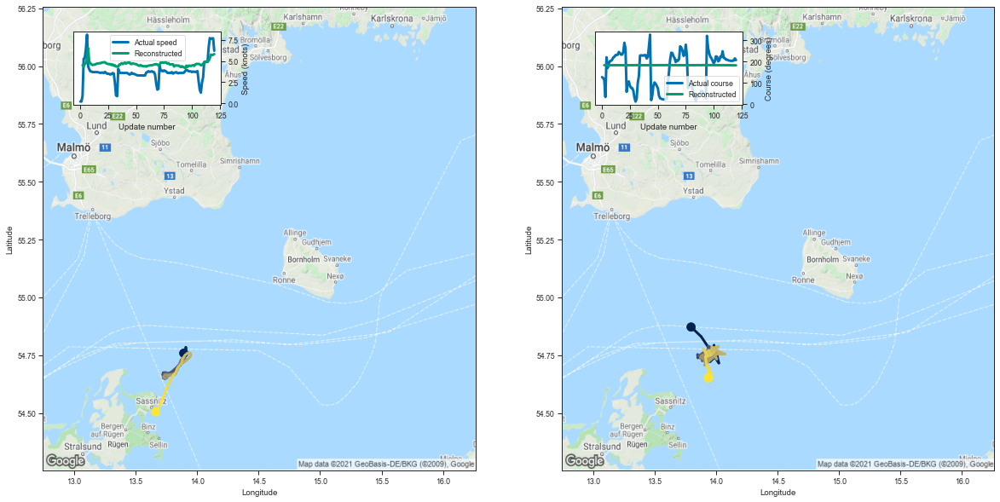

[4.522025108337402, 4.368527412414551, 4.700864791870117, 4.744931221008301]
tensor([ 55.3891,  15.8173,   4.8201, 179.7051])
tensor([ 0.4199,  0.1396,  2.1851, 51.3375])


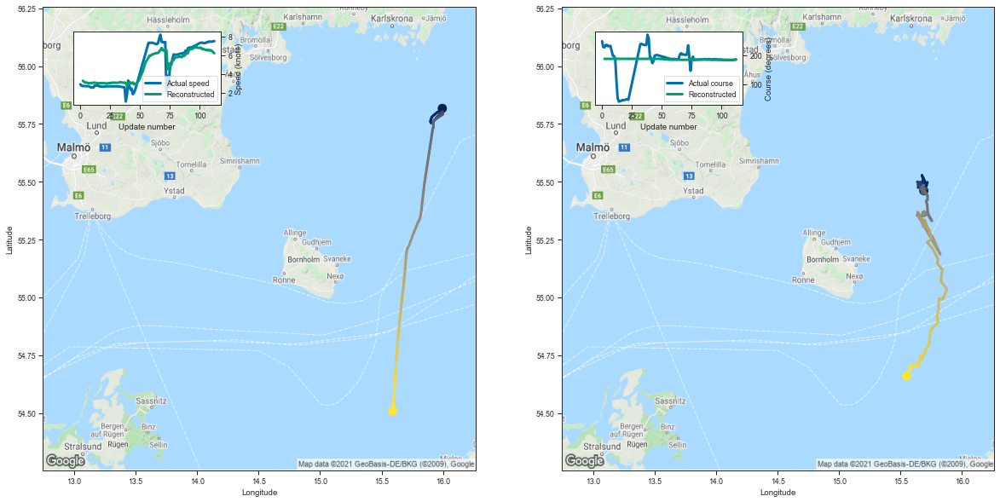

[3.259211540222168, 3.163377046585083, 3.0654025077819824, 3.0693769454956055]
tensor([ 55.5362,  15.2070,   6.1639, 187.8788])
tensor([  0.2706,   0.1994,   1.8095, 103.0491])


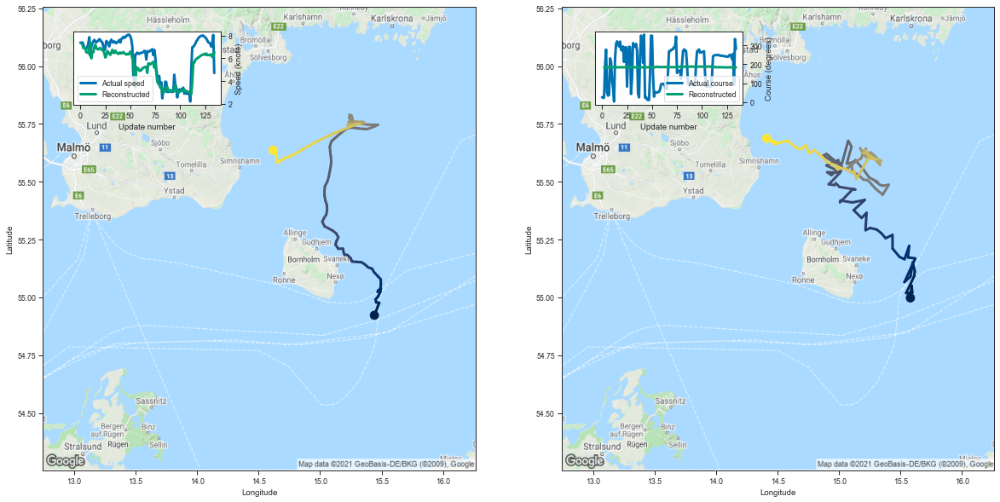

[7.219045162200928, 6.892802715301514, 6.973494529724121, 6.868412971496582]
tensor([ 55.8354,  15.0674,   3.7273, 228.2700])
tensor([4.9397e-02, 1.4901e-01, 2.4138e+00, 9.4109e+01])


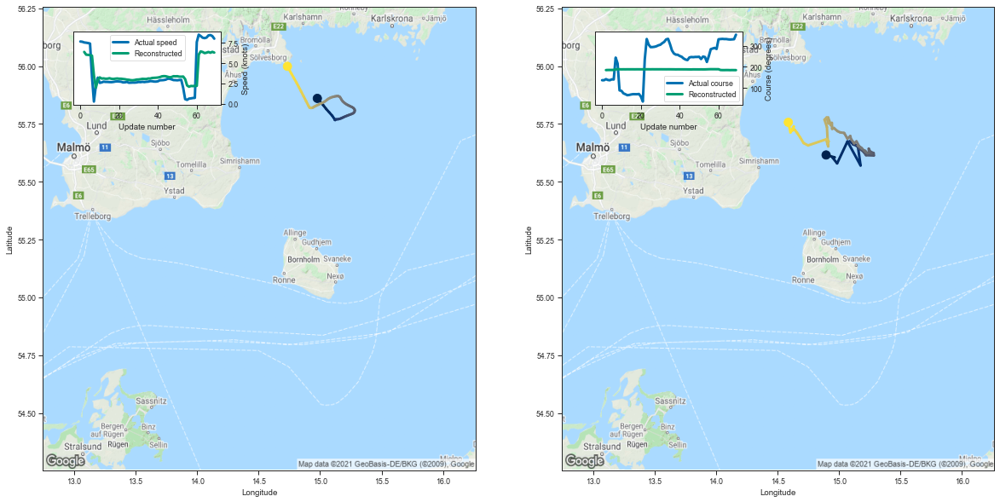

[6.376969337463379, 6.039199352264404, 6.015336513519287, 5.975273132324219]
tensor([ 55.2215,  14.8274,   3.8846, 189.9222])
tensor([ 0.2968,  0.3822,  3.6693, 74.8792])


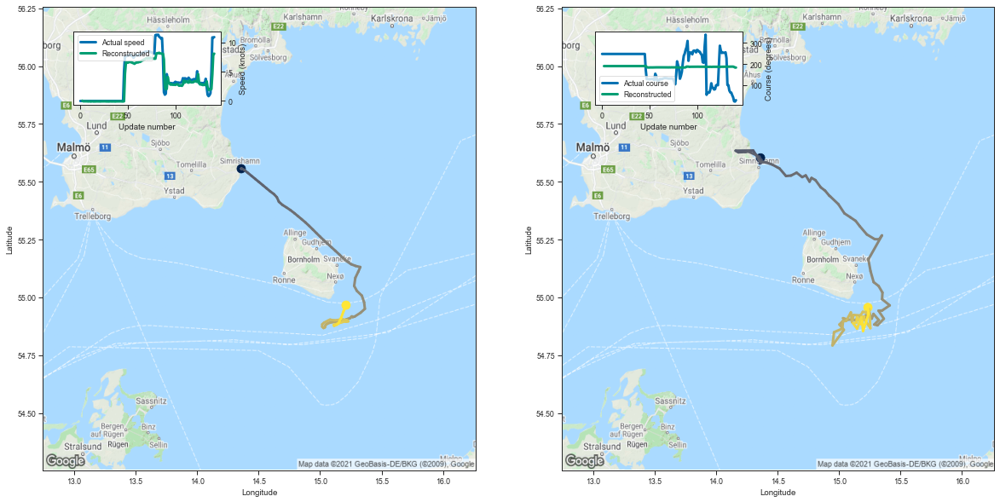

[0.048155784606933594, -0.046973466873168945, -0.07032632827758789, -0.04558706283569336]
tensor([55.5485, 14.3889,  0.8844, 21.2638])
tensor([2.3725e-02, 8.7315e-02, 2.4770e+00, 5.2908e+01])


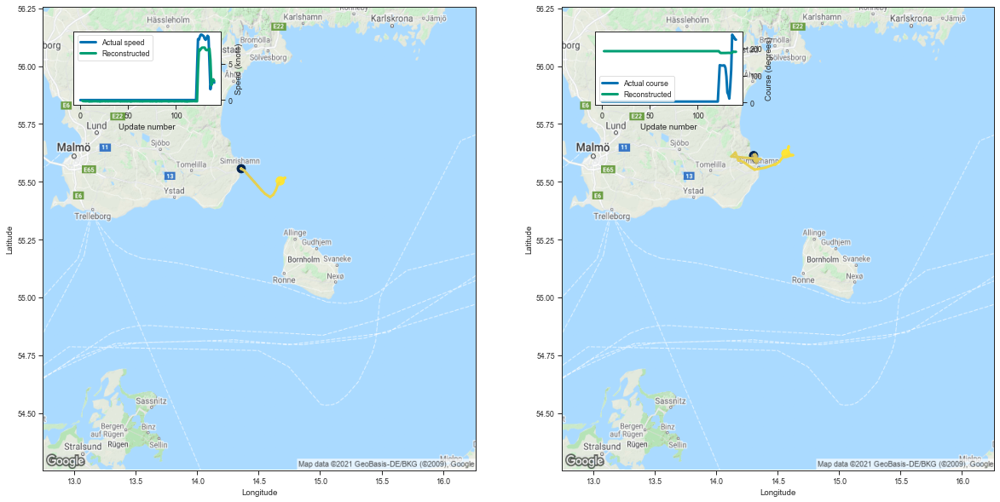

[-0.08682608604431152, -0.14511370658874512, -0.15312647819519043, -0.1563720703125]
tensor([5.4969e+01, 1.5418e+01, 2.6403e-01, 3.1155e+02])
tensor([2.0175e-03, 4.4569e-03, 8.4144e-01, 9.6997e+01])


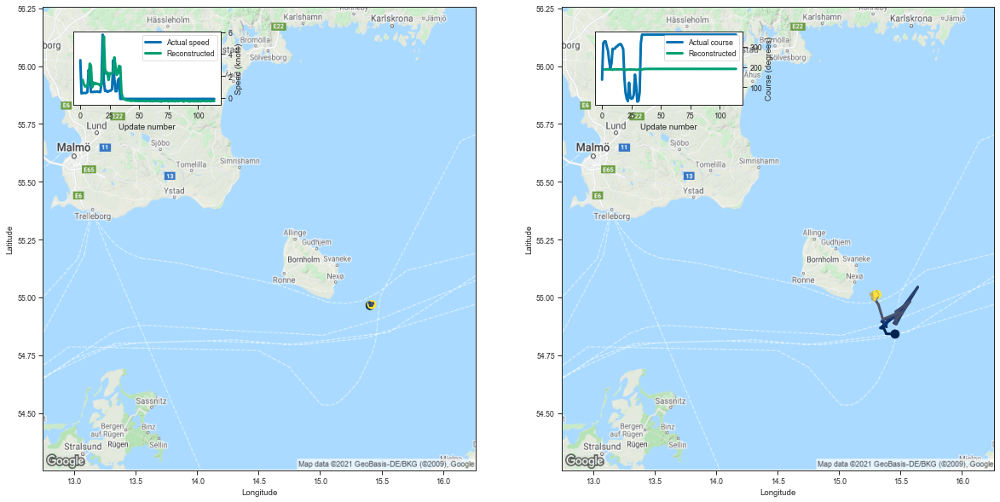

[1.6418352127075195, 1.2399073839187622, 1.0298491716384888, 1.0626944303512573]
tensor([ 55.8473,  15.0999,   4.2488, 163.5732])
tensor([6.3944e-02, 1.5856e-01, 3.0117e+00, 1.0135e+02])


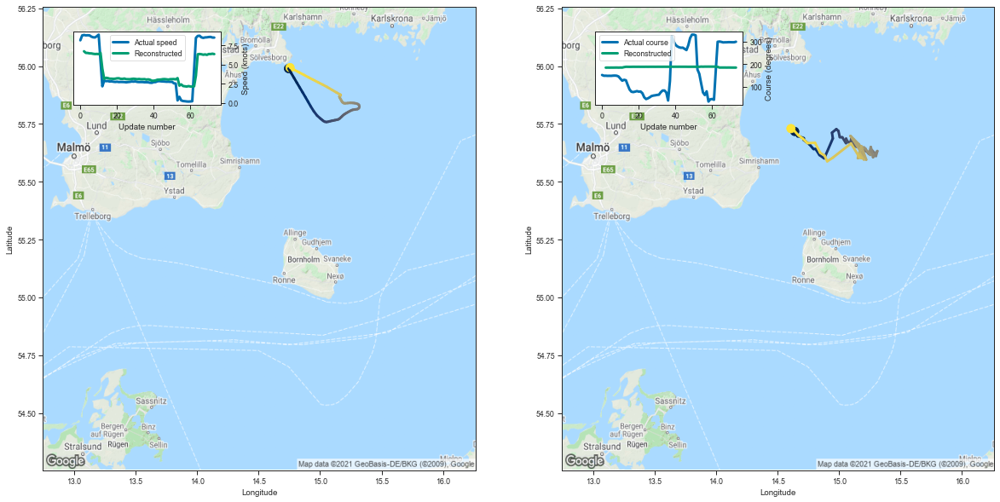

[6.7356767654418945, 6.526832580566406, 6.514435768127441, 6.464685916900635]
tensor([ 55.4575,  14.3035,   0.7143, 117.3078])
tensor([3.0600e-02, 2.9881e-02, 1.5140e+00, 9.7010e+01])


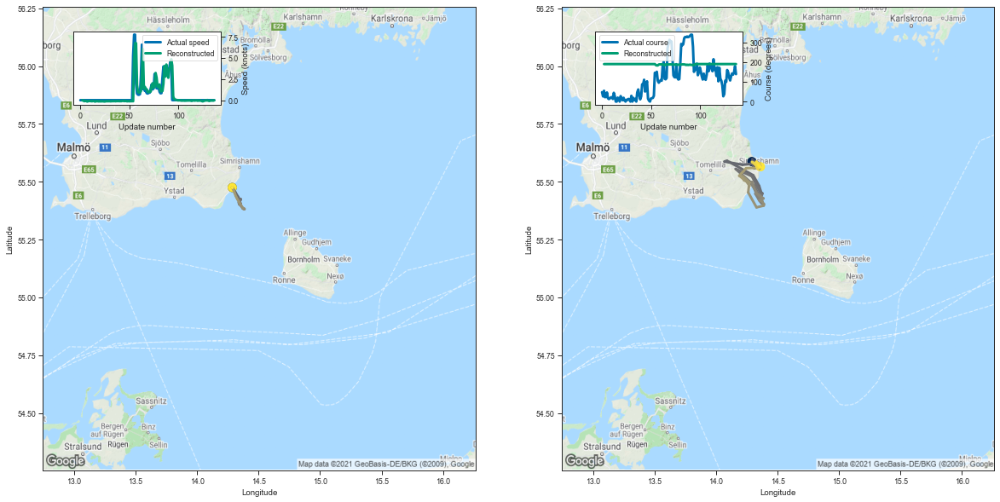

[-0.01250910758972168, -0.04381251335144043, -0.11868572235107422, -0.09271359443664551]


,Data set Index,Index,MMSI,Ship type,Length,Reconstruction log probability,Equally weighted reconstruction log probability
95,95,6805561,265759000,Fishing,143,-155.231812,-1.085537
17,17,6685896,265759000,Fishing,143,-155.412628,-1.086802
60,60,6869996,265759000,Fishing,143,-156.579529,-1.094962
29,29,6787151,265759000,Fishing,143,-157.222702,-1.099459
74,74,6962046,265759000,Fishing,143,-159.145721,-1.112907
...,...,...,...,...,...,...,...
41,41,5535068,265750000,Fishing,142,-978.500977,-6.890852
11,11,6489434,265755000,Fishing,141,-983.554565,-6.975564
56,56,4380691,261017210,Fishing,115,-822.046265,-7.148228
88,88,4900749,265593190,Fishing,74,-529.082153,-7.149759


In [9]:
# Focus on the overall n=100 best reconstructions
data = summary_models.run_evaluation_get_n(n=100, worst=False)
df_n = data["TrajectoryLevelData"]
train_evaluate = data["TrainEvaluateObject"]

# Plot the actual and reconstructed trajectories side by side
for idx in range(100): 
    tracks = plot_actual_reconstructed(idx)
    print(list(tracks["Reconstructed trajectory"]["Speed"])[:4])
df_n